In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.dates as mdates

# Prepare data

## Read survey and epc data

In [2]:
# Read 'SensorID_EPC_Survey_Open_Data' file
file_path_ID ='Data/SensorID_EPC_Survey_Open_Data.csv'
df_ID_time = pd.read_csv(file_path_ID)

In [3]:
df_ID_time.columns

Index(['ID', 'IMD Quintile', 'Self-report Housing Condition', 'Housing Type',
       'Tenures ', 'Current EPC Rating ',
       'Recording Start Time (Participant) ',
       'Recording End Time (Participant) ', 'Battery Charging Start Time',
       'Battery Charging End Time', 'Unnamed: 10'],
      dtype='object')

In [4]:
# Convert field to datetime type 
df_ID_time['Battery Charging Start Time'] = pd.to_datetime(df_ID_time['Battery Charging Start Time'], format="%d/%m/%Y %H:%M")  
df_ID_time['Battery Charging End Time'] = pd.to_datetime(df_ID_time['Battery Charging End Time'], format="%d/%m/%Y %H:%M")  

df_ID_time['Recording Start Time (Participant)'] = pd.to_datetime(df_ID_time['Recording Start Time (Participant) '], format="%d/%m/%Y %H:%M")  
df_ID_time['Recording End Time (Participant)'] = pd.to_datetime(df_ID_time['Recording End Time (Participant) '], format="%d/%m/%Y %H:%M")  

## Read weather observation data

In [5]:
station_limbo = pd.read_csv('Data/LIMBO.csv')

In [6]:
station_limbo['Report Date / Time'] = pd.to_datetime(station_limbo['Report Date / Time'], format='%Y-%m-%d %H:%M:%S', errors='coerce')

In [7]:
station_limbo['Report Date / Time'] 

0       2023-07-01 00:00:33
1       2023-07-01 00:05:34
2       2023-07-01 00:10:35
3       2023-07-01 00:15:36
4       2023-07-01 00:20:37
                ...        
23732   2023-09-30 23:37:08
23733   2023-09-30 23:42:09
23734   2023-09-30 23:47:10
23735   2023-09-30 23:52:11
23736   2023-09-30 23:57:12
Name: Report Date / Time, Length: 23737, dtype: datetime64[ns]

## Define function for heat stress index

In [8]:
# Define function for heat stress index
def calculate_heat_index(temperature, relative_humidity):
    c1 = -42.379
    c2 = 2.04901523
    c3 = 10.14333127
    c4 = -0.22475541
    c5 = -6.83783e-03
    c6 = -5.481717e-02
    c7 = 1.22874e-03
    c8 = 8.5282e-04
    c9 = -1.99e-06

    # Convert temperature to Fahrenheit
    temp_fahrenheit = (temperature * 1.8) + 32

    # Calculate the simple heat index
    heat_index_simple = 0.5 * (temp_fahrenheit + 61.0 + (temp_fahrenheit - 68.0) * 1.2 + (relative_humidity * 0.094))

    if heat_index_simple > 80:
        heat_index = c1 + (c2 * temp_fahrenheit) + (c3 * relative_humidity) + \
                     (c4 * temp_fahrenheit * relative_humidity) + \
                     (c5 * temp_fahrenheit ** 2) + (c6 * relative_humidity ** 2) + \
                     (c7 * temp_fahrenheit ** 2 * relative_humidity) + \
                     (c8 * temp_fahrenheit * relative_humidity ** 2) + \
                     (c9 * temp_fahrenheit ** 2 * relative_humidity ** 2)

        if (relative_humidity < 13) and (80 <= temp_fahrenheit <= 112):
            adjustment = ((13 - relative_humidity) / 4) * ((17 - abs(temp_fahrenheit - 95)) / 17)
            heat_index -= adjustment

        if (relative_humidity > 85) and (80 <= temp_fahrenheit <= 87):
            adjustment = ((relative_humidity - 85) / 10) * ((87 - temp_fahrenheit) / 5)
            heat_index += adjustment

        # Convert temperature to Celsius
        heat_index_celsius = round((heat_index - 32) / 1.8,2)

        return heat_index_celsius
    else:
        heat_index_simple_celsius = round((heat_index_simple - 32) / 1.8,2)
        return heat_index_simple_celsius

# Generate plots

In [28]:
def temperature_plot(file_name):
    try:
        if file_name == 'BL007-14':
            # Skip processing for this sensor
            print(f"Skipping processing for sensor {file_name}")
            return
        
        # Load  data from the file
        df = pd.read_csv('Data/Household Indoor Sensor Measurement Data/'+file_name+'.csv') 
        # Convert field to datetime type 
        df['TIME'] = pd.to_datetime(df['TIME'])  

        sensorID = file_name            
        selected_sensor = df_ID_time[df_ID_time['ID'] == sensorID]

        start_date = selected_sensor['Battery Charging Start Time']
        end_date = selected_sensor['Battery Charging End Time']
        
        if pd.notnull(selected_sensor['Battery Charging Start Time']).any():
            start_date = selected_sensor['Battery Charging Start Time'] + pd.Timedelta(hours=1) # Delay 1 hour to allow the sensor settled in the indoor condition and improve the accuracy of indoor temperature measurements
            end_date = selected_sensor['Battery Charging End Time']
        else:
            start_date = selected_sensor['Recording Start Time (Participant) ']
            end_date = selected_sensor['Recording End Time (Participant) ']

        start_date_value = start_date.iloc[0]
        end_date_value = end_date.iloc[0]

        # Slice the sensor data
        sliced_df = df[(df['TIME'] >= start_date_value) & (df['TIME'] <= end_date_value)]
        
        # Slice the weather station data accordingly
        sliced_limbo = station_limbo[(station_limbo['Report Date / Time']  >= start_date_value) & (station_limbo['Report Date / Time']  <= end_date_value)]
        sliced_limbo = sliced_limbo.reset_index(drop=True)

        # Plot (1) ————————————————————————————————————————————————————————
        
        # Extract time, temperature, and humidity columns
        time = sliced_df['TIME']
        temperature = sliced_df['TEMP']
        humidity = sliced_df['HUM']

        # Convert the 'TIME' column to datetime objects
        time = pd.to_datetime(time)

        # Create a list of labels with the date portion
        date_labels = time.dt.strftime('%Y-%m-%d')
        time_labels = time.dt.strftime('%Y-%m-%d %H:%M:%S')

        # Find the highest and lowest temperature values and date
        max_temp_index = temperature.idxmax()
        min_temp_index = temperature.idxmin()
        max_temp_date = time_labels.loc[max_temp_index]
        min_temp_date = time_labels.loc[min_temp_index]
        
        # Find the highest humidity values and date 
        max_hum_index = humidity.idxmax()
        max_hum_date = time_labels.loc[max_hum_index]

        # Plot
        fig, ax1 = plt.subplots(figsize=(10, 6))  
        ax1.plot(time, temperature, label='Temperature (°C)', linestyle='-', color='tab:blue')
        ax1.axhline(y=25, color='gray', linestyle='--', label='25°C') 
        ax1.set_xlabel('Date') 
        ax1.set_ylabel('Temperature (°C)', color='tab:blue')
        ax1.tick_params(axis='y', labelcolor='tab:blue')        
        epc = selected_sensor['Current EPC Rating '].str.strip().values[0]
        householdtype = selected_sensor['Housing Type'].str.strip().values[0]
        ax1.set_title(f'Indoor Temperature and Humidity from Sensor {sensorID}\n{householdtype}, EPC: {epc}', fontsize=15)
        ax1.grid(False)

        # Create a secondary Y-axis for humidity
        ax2 = ax1.twinx()
        ax2.plot(time, humidity, label='Humidity (%)', linestyle='-', color='tab:green',alpha=0.2)
        ax2.axhline(y=75, color='darkgreen', linestyle='--', label='75%') # Threshold for humidity 
        ax2.set_ylabel('Humidity (%)', color='tab:green')
        ax2.tick_params(axis='y', labelcolor='tab:green')

        # Combine the legend
        lines, labels = ax1.get_legend_handles_labels()
        lines2, labels2 = ax2.get_legend_handles_labels()
        ax2.legend(lines + lines2, labels + labels2, loc='upper left')
        
        # Mark and annotate the highest and lowest temperature points
        ax2.scatter(time[max_hum_index], humidity[max_hum_index], color='green', marker='^', label='Max Hum')
        ax2.annotate(f'Max Hum: {humidity[max_hum_index]}%%\nDate: {max_hum_date}',
                     (time[max_hum_index], humidity[max_hum_index]), textcoords="offset points", xytext=(30, -30),
                     ha='center')
        
        ax1.xaxis.set_major_locator(mdates.RRuleLocator(mdates.rrulewrapper(mdates.DAILY, interval=2)))
        ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)

        plt.tight_layout()
        plt.savefig(f'{sensorID}_temperature_humidity.png')
        plt.show()

        # Plot (2) ————————————————————————————————————————————————————————
        
        # Find the highest and lowest station temperatures
        station_time = sliced_limbo['Report Date / Time']
        station_temperature = sliced_limbo['Air Temperature']

        max_station_temp_index = station_temperature.idxmax()
        min_station_temp_index = station_temperature.idxmin()

        max_station_temp_date = station_time.iloc[max_station_temp_index]
        min_station_temp_date = station_time.iloc[min_station_temp_index]

        # Define heat wave periods
        heatwave_start_date = pd.to_datetime('2023-09-04')
        heatwave_end_date = pd.to_datetime('2023-09-10')
        heatwave_text = 'Heatwave Period: \n2023-09-04 to 2023-09-10'

        
        # Calculate rolling mean over a 3-day window (data was recorded every minute, so 1440 was chosen to calculate day mean temperature)
        rolling_mean = sliced_df['TEMP'].rolling(1440, center=True).mean()
        # Define a threshold temperature for identifying heat periods
        threshold_temp = 25
        # Create a mask to identify heat periods where rolling mean is greater than threshold_temp
        heat_period_mask = rolling_mean > threshold_temp

       # Initialize variables
        heat_periods = []
        current_period = None
        total_heat_period_duration = 0  # To accumulate the duration of heat periods

        for i, is_heat_period in enumerate(heat_period_mask):
            if is_heat_period:
                if current_period is None:
                    current_period = [i]
                else:
                    current_period.append(i)
            elif current_period is not None:
                if len(current_period) > 4380:  # Check if it's more than 3 days
                    start_date = df['TIME'].iloc[current_period[0]].strftime('%Y-%m-%d')
                    end_date = df['TIME'].iloc[current_period[-1]].strftime('%Y-%m-%d')
                    start_date_timestamp = pd.to_datetime(start_date)
                    end_date_timestamp = pd.to_datetime(end_date)
                    period_duration = (end_date_timestamp - start_date_timestamp).days
                    total_heat_period_duration += period_duration  # Accumulate the duration
                    heat_period_label = f'Heat Period:\n{start_date} to {end_date} \n({period_duration} days)'
                    heat_periods.append(heat_period_label)
                    ax1.fill_between(sliced_df['TIME'], sliced_df['TEMP'].min(), sliced_df['TEMP'].max(),
                                    where=(sliced_df['TIME'] >= start_date) & (sliced_df['TIME'] <= end_date),
                                    color='orange', alpha=0.1, label='Heat Period')
                    ax1.text(start_date_timestamp + pd.DateOffset(days=0), sliced_df['TEMP'].min(),
                             heat_period_label, fontsize=9, color='#CA7A2C', alpha=1)

                current_period = None
 
        # Annotation for the total heat period days
        total_heat_period_text = f'Total Heat Period Days: {total_heat_period_duration} days'

       
        # Plot indoor temperature 
        fig, ax1 = plt.subplots(figsize=(12, 6))
        ax1.plot(sliced_df['TIME'], rolling_mean, label='Rolling Mean Indoor Temperature', linestyle='-', color='orange', alpha=0.8)  
        ax1.plot(time, temperature, label='Indoor Temperature', linestyle='-', color='tab:blue')
        ax1.set_xlabel('Date')
        ax1.set_ylabel('Temperature (°C)')
        ax1.tick_params(axis='y')
        ax1.set_title(f'Indoor Temperature Heat Periods (Sensor{sensorID}) and 2023 UK Heatwave\n{householdtype}, EPC: {epc}', fontsize=15)
        ax1.grid(False)

        # Plot station temperature
        rolling_mean_station = station_temperature.rolling(288, center=True).mean()
        ax1.plot(station_time, rolling_mean_station, label='Rolling Mean Station Temperature', linestyle='-', color='tab:blue', alpha=0.4)  
        ax1.plot(station_time, station_temperature, label='Station Temperature', linestyle='-', color='tab:blue', alpha=0.1)
        ax1.axhline(y=25, color='gray', linestyle='--', label='25°C') 
        ax1.set_ylabel('Temperature (°C)')
        ax1.tick_params(axis='y')

        # Combine the legend
        lines, labels = ax1.get_legend_handles_labels()
        ax1.legend(lines, labels, loc='upper left')

        # Mark and annotate the highest and lowest temperature points for indoor temperature
        ax1.scatter(time[max_temp_index], temperature[max_temp_index], color='red', marker='^', label='Max Indoor Temp')
        ax1.scatter(time[min_temp_index], temperature[min_temp_index], color='blue', marker='v', label='Min Indoor Temp')
        ax1.annotate(f'Max Indoor Temp: {temperature[max_temp_index]}°C\nTime: {max_temp_date}',
                     (time[max_temp_index], temperature[max_temp_index]), textcoords="offset points", xytext=(-80, -20),
                     ha='center')
        # ax1.annotate(f'Min Indoor Temp: {temperature[min_temp_index]}°C\nTime: {min_temp_date}',
        #              (time[min_temp_index], temperature[min_temp_index]), textcoords="offset points", xytext=(80, 5),
        #              ha='center')

        # Mark the and annotate the highest and lowest temperature points for station temperature
        ax1.scatter(station_time[max_station_temp_index], station_temperature[max_station_temp_index], color='black',
                    marker='^', label='Max Station Temp',s=10)
        # ax1.scatter(station_time[min_station_temp_index], station_temperature[min_station_temp_index], color='black',
        #             marker='v', label='Min Station Temp',s=10)
        text = f'Note:\nMax Station Temp: {station_temperature[max_station_temp_index]:.2f}°C\nTime: {max_station_temp_date}\n\nMin Station Temp: {station_temperature[min_station_temp_index]:.2f}°C\nTime: {min_station_temp_date}'
        ax1.text(0.02, 0.05, text, transform=ax1.transAxes, fontsize=8, color='black',alpha = 0.5)

        # Draw the heatwave period on the plot
        ax1.fill_between(station_time,station_temperature.min(), station_temperature.max(), where=(station_time >= heatwave_start_date) & (station_time <= heatwave_end_date), color='yellow', alpha=0.1, label='Heatwave Period')
        ax1.text(heatwave_start_date + pd.DateOffset(days=0), station_temperature.min(), heatwave_text, fontsize=10, color='#884C3A',alpha=1)

        # Add text annotations for each heat period
        heat_periods = []
        current_period = None
        for i, is_heat_period in enumerate(heat_period_mask):
            if is_heat_period:
                if current_period is None:
                    current_period = [i]
                else:
                    current_period.append(i)
            elif current_period is not None:
                if len(current_period) > 4380:  # Check if it's more than 3 days
                    start_date = df['TIME'].iloc[current_period[0]].strftime('%Y-%m-%d')
                    end_date = df['TIME'].iloc[current_period[-1]].strftime('%Y-%m-%d')
                    heat_periods.append(f'Heat Period: {start_date} to {end_date}')
                    start_date_timestamp = pd.to_datetime(start_date)
                    end_date_timestamp = pd.to_datetime(end_date)
                    ax1.fill_between(sliced_df['TIME'], sliced_df['TEMP'].min(), sliced_df['TEMP'], where=(sliced_df['TIME'] >=start_date) & (sliced_df['TIME'] <= end_date), color='#FFB11B', alpha=0.15, label='Heat Period')    
                    ax1.text(start_date_timestamp + pd.DateOffset(days=0),  sliced_df['TEMP'].min()-1.5,f'Indoor Heat Period:\n{start_date} to {end_date}', fontsize=9, color='#CA7A2C',alpha=1)
                current_period = None
        ax1.text(0.01, 0.68, total_heat_period_text, transform=ax1.transAxes, fontsize=10, color='#CA7A2C', alpha=1)
        
        ax1.xaxis.set_major_locator(mdates.RRuleLocator(mdates.rrulewrapper(mdates.DAILY, interval=2)))
        ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)

        plt.tight_layout()
        plt.savefig(f'{sensorID}_temperature_complex.png')
        plt.show()

        
        # Plot (3) ————————————————————————————————————————————————————————
        # Culculate heat stress index
        sliced_df['heatstress'] = sliced_df.apply(lambda row: calculate_heat_index(row['TEMP'], row['HUM']), axis=1)
        
        # Geberate rolling mean
        heatstress_rolling_mean = sliced_df['heatstress'].rolling(1440, center=True).mean()
        # Define a threshold temperature for identifying heat periods
        threshold_temp = 27
        # Create a mask to identify heat periods where rolling mean is greater than threshold_temp
        heatstress_period_mask = heatstress_rolling_mean > threshold_temp

        # Initialize variables
        heat_periods = []
        current_period = None
        total_heat_period_duration = 0  # To accumulate the duration of heat periods

        for i, is_heat_period in enumerate(heatstress_period_mask):
            if is_heat_period:
                if current_period is None:
                    current_period = [i]
                else:
                    current_period.append(i)
            elif current_period is not None:
                if len(current_period) > 4380:  # Check if it's more than 3 days
                    start_date = df['TIME'].iloc[current_period[0]].strftime('%Y-%m-%d')
                    end_date = df['TIME'].iloc[current_period[-1]].strftime('%Y-%m-%d')
                    start_date_timestamp = pd.to_datetime(start_date)
                    end_date_timestamp = pd.to_datetime(end_date)
                    period_duration = (end_date_timestamp - start_date_timestamp).days
                    total_heat_period_duration += period_duration  # Accumulate the duration
                    heat_period_label = f'Heat Period:\n{start_date} to {end_date} \n({period_duration} days)'
                    heat_periods.append(heat_period_label)
                    ax1.fill_between(sliced_df['TIME'], sliced_df['heatstress'].min(), sliced_df['heatstress'].max(),
                                    where=(sliced_df['TIME'] >= start_date) & (sliced_df['TIME'] <= end_date),
                                    color='pink', alpha=0.1, label='Heat Period')

                    # Add a text annotation for the heat period
                    ax1.text(start_date_timestamp + pd.DateOffset(days=0), sliced_df['heatstress'].min(),
                             heat_period_label, fontsize=9, color='#DB4D6D', alpha=1)

                current_period = None

        # Add an annotation for the total heat period days
        total_heat_period_text = f'Total Heat Period Days: {total_heat_period_duration} days'

        # Plot indoor temperature
        fig, ax1 = plt.subplots(figsize=(12, 6))
        ax1.axhline(y=27, color='gray', linestyle=':', label='27°C') 
        ax1.axhline(y=32.5, color='#DB4D6D', linestyle=':', label='32.5°C',alpha=0.5) 

        # Plot station temperature
        ax1.plot(station_time, station_temperature, label='Station Temperature', linestyle='-', color='tab:blue', alpha=0.15)
        ax1.plot(time, temperature, label='Indoor Temperature', linestyle='-', color='tab:blue', alpha=0.8)
        # Plot heat stress index
        heatstress_index = sliced_df['heatstress']
        ax1.plot(time, heatstress_index, label='Heat Stress Index', linestyle='-', color='#DB4D6D', alpha=1)
        
        ax1.plot(station_time, rolling_mean_station, label='Rolling Mean Station Temperature', linestyle='-', color='tab:blue', alpha=0.4)  # Add the rolling mean line


        # Find the highest and lowest heat stress index values
        max_heatstress_index = heatstress_index.idxmax()
        min_heatstress_index = heatstress_index.idxmin()

        max_heatstress_date = time_labels.loc[max_heatstress_index]
        min_heatstress_date = time_labels.loc[min_heatstress_index]

        # Mark and annotate the highest and lowest heat stress index points for indoor temperature
        ax1.scatter(time[max_heatstress_index], heatstress_index[max_heatstress_index], color='#D0104C', marker='^')
        ax1.scatter(time[min_heatstress_index], heatstress_index[min_heatstress_index], color='#0C4842', marker='v')
        ax1.annotate(f'Max Heat Stress Index: {heatstress_index[max_heatstress_index]}°C\nTime: {max_heatstress_date}',
                     (time[max_heatstress_index], heatstress_index[max_heatstress_index]), textcoords="offset points", xytext=(-81, -20),
                     ha='center')
        # ax1.annotate(f'Min Heat Stress Index: {heatstress_index[min_heatstress_index]}°C\nTime: {min_heatstress_date}',
        #              (time[min_heatstress_index], heatstress_index[min_heatstress_index]), textcoords="offset points", xytext=(-77, -38),
        #              ha='center')

        ax1.set_ylabel('Heat Stress Index (°C)')
        ax1.tick_params(axis='y')
        ax1.set_title(f'Heat Stress Index Heat Periods (Sensor {sensorID}) and 2023 UK Heatwave\n{householdtype}, EPC: {epc}', fontsize=15)

        # Combine the legend for both indoor temperature and station temperature
        lines, labels = ax1.get_legend_handles_labels()
        ax1.legend(lines, labels, loc='upper left')

        # Mark the highest and lowest temperature points for station temperature
        ax1.scatter(station_time[max_station_temp_index], station_temperature[max_station_temp_index], color='black',
                    marker='^', label='Max Station Temp',s=10)
        # ax1.scatter(station_time[min_station_temp_index], station_temperature[min_station_temp_index], color='black',
        #             marker='v', label='Min Station Temp',s=10)

        text = f'Note:\nMax Station Temp: {station_temperature[max_station_temp_index]:.2f}°C\nTime: {max_station_temp_date}\n\nMin Station Temp: {station_temperature[min_station_temp_index]:.2f}°C\nTime: {min_station_temp_date}'

        ax1.text(0.02, 0.05, text, transform=ax1.transAxes, fontsize=8, color='black',alpha = 0.5)
        
        # Draw the heatwave period on the plot
        ax1.fill_between(station_time,station_temperature.min(), station_temperature.max(), where=(station_time >= heatwave_start_date) & (station_time <= heatwave_end_date), color='yellow', alpha=0.1, label='Heatwave Period')
        ax1.text(heatwave_start_date + pd.DateOffset(days=0), station_temperature.min(), heatwave_text, fontsize=10, color='darkred',alpha=0.5)

        # Add text annotations for each heat period
        heat_periods = []
        current_period = None
        for i, is_heat_period in enumerate(heatstress_period_mask):
            if is_heat_period:
                if current_period is None:
                    current_period = [i]
                else:
                    current_period.append(i)
            elif current_period is not None:
                if len(current_period) > 4380:  # Check if it's more than 3 days
                    start_date = df['TIME'].iloc[current_period[0]].strftime('%Y-%m-%d')
                    end_date = df['TIME'].iloc[current_period[-1]].strftime('%Y-%m-%d')
                    heat_periods.append(f'Heat Period: {start_date} to {end_date}')
                    start_date_timestamp = pd.to_datetime(start_date)
                    end_date_timestamp = pd.to_datetime(end_date)
                    ax1.fill_between(sliced_df['TIME'], sliced_df['heatstress'].min(), sliced_df['heatstress'], where=(sliced_df['TIME'] >=start_date) & (sliced_df['TIME'] <= end_date), color='pink', alpha=0.2, label='Heat Period')    
                    ax1.text(start_date_timestamp + pd.DateOffset(days=0),  sliced_df['heatstress'].min()+0.5,f'Indoor Heat Period:\n{start_date} to {end_date}', fontsize=9, color='#DB4D6D',alpha=1)
                current_period = None


        # Add an annotation for the total heat period days
        total_heat_period_text = f'Total Heat Period Days: {total_heat_period_duration} days'
        ax1.text(0.01, 0.66, total_heat_period_text, transform=ax1.transAxes, fontsize=10, color='#DB4D6D', alpha=1)
        
        ax1.xaxis.set_major_locator(mdates.RRuleLocator(mdates.rrulewrapper(mdates.DAILY, interval=2)))
        ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)
        
        plt.tight_layout()
        plt.savefig(f'{sensorID}_heatstressindex_complex.png')
        plt.show()


    except Exception as e:
        print(f"Error in the first plot generation segment: {str(e)}")

In [29]:
ID_list=df_ID_time['ID']

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:91: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


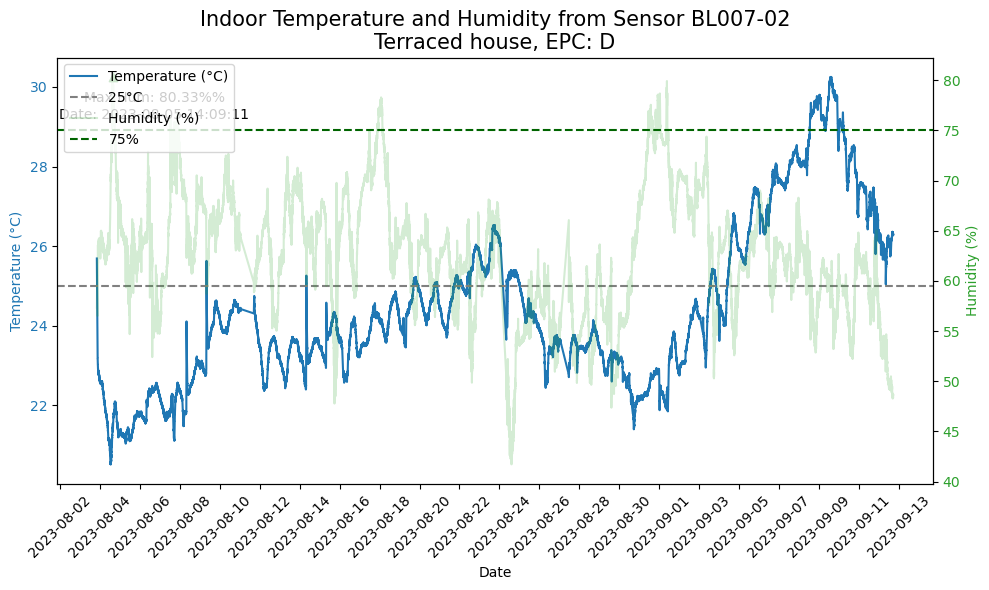

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:221: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


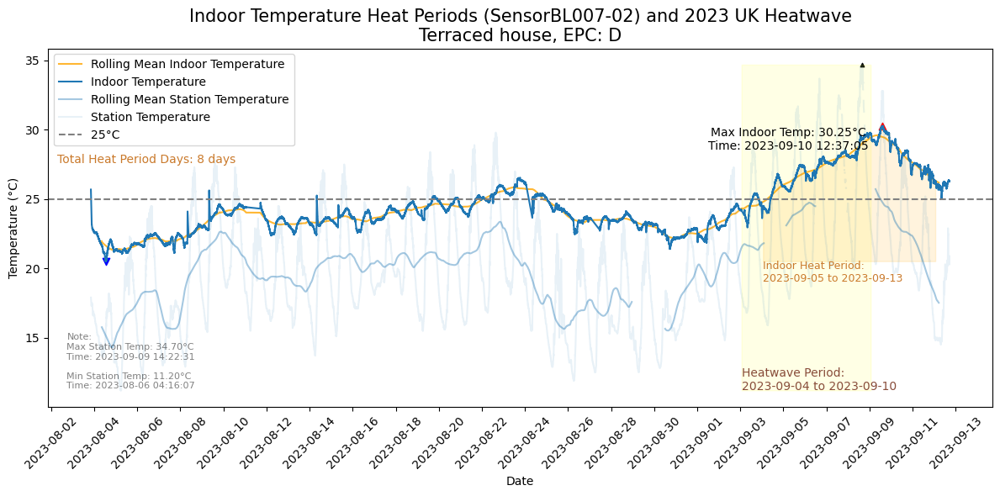

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sliced_df['heatstress'] = sliced_df.apply(lambda row: calculate_heat_index(row['TEMP'], row['HUM']), axis=1)
C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:353: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


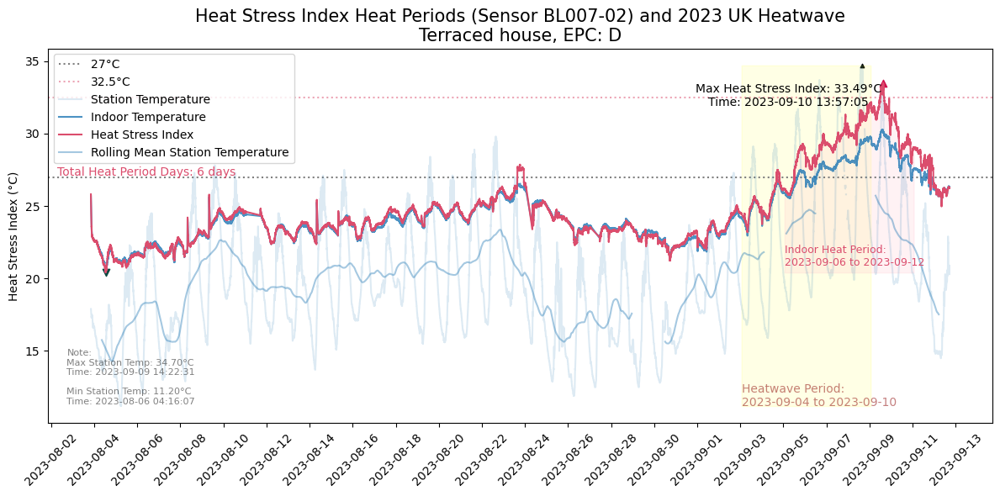

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:91: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


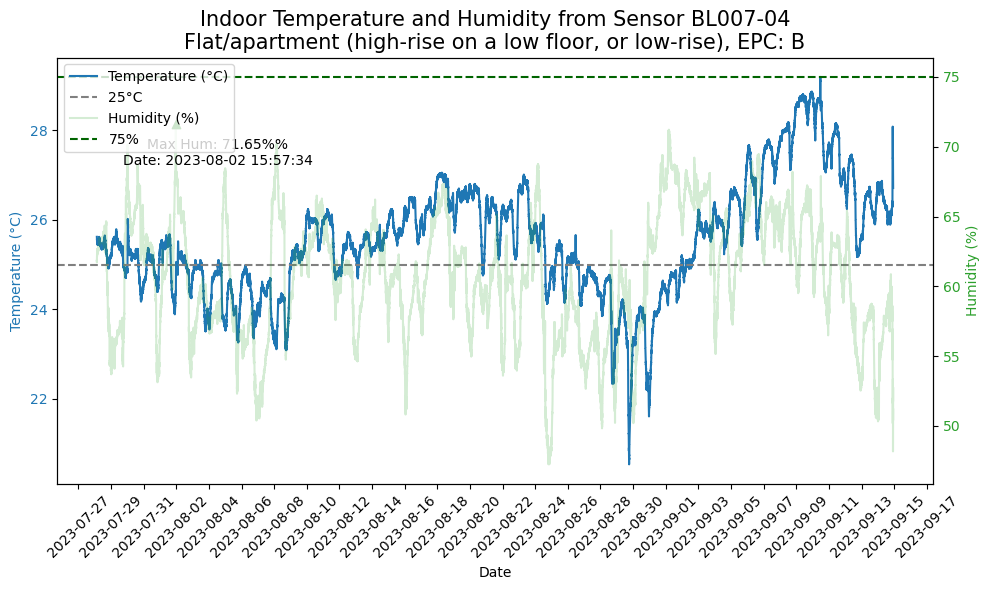

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:221: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


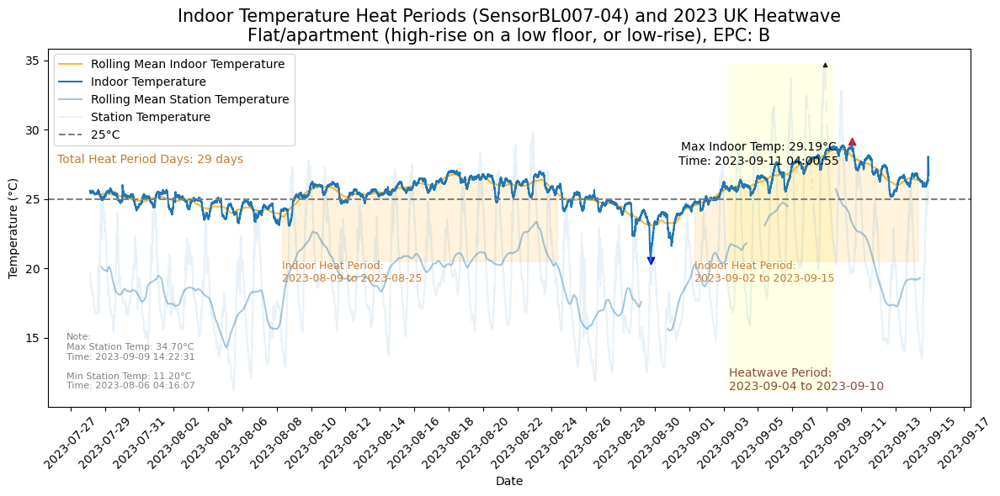

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sliced_df['heatstress'] = sliced_df.apply(lambda row: calculate_heat_index(row['TEMP'], row['HUM']), axis=1)
C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:353: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


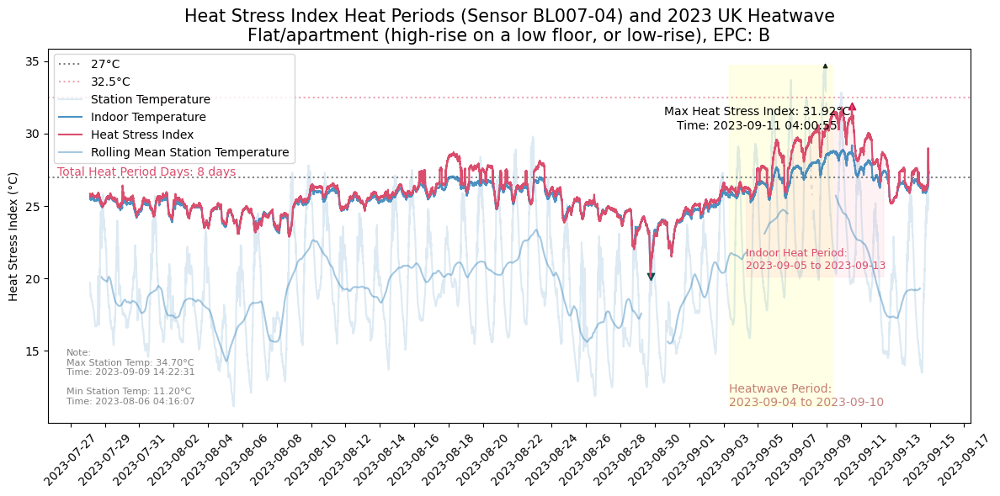

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:91: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


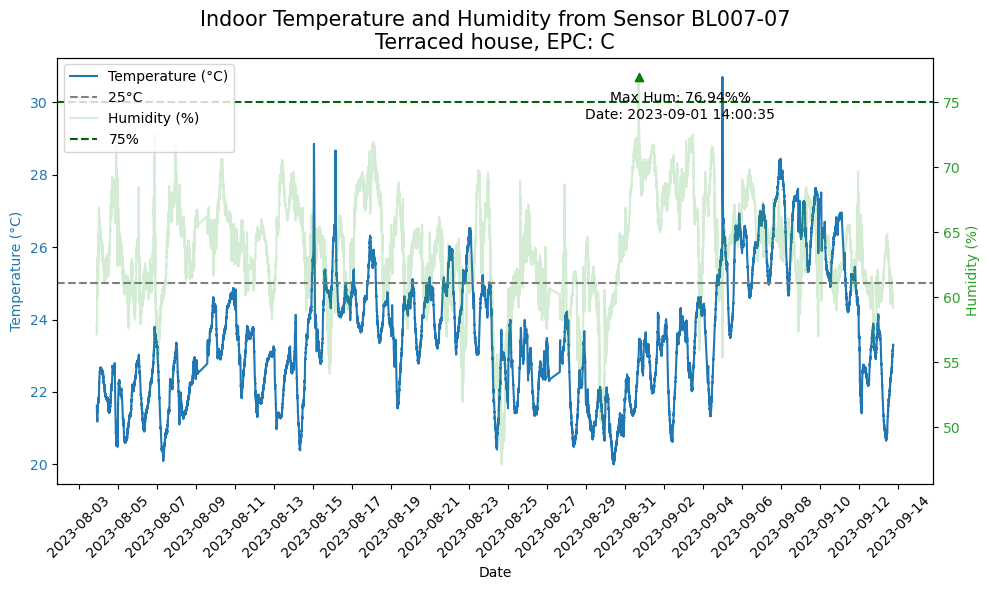

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:221: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


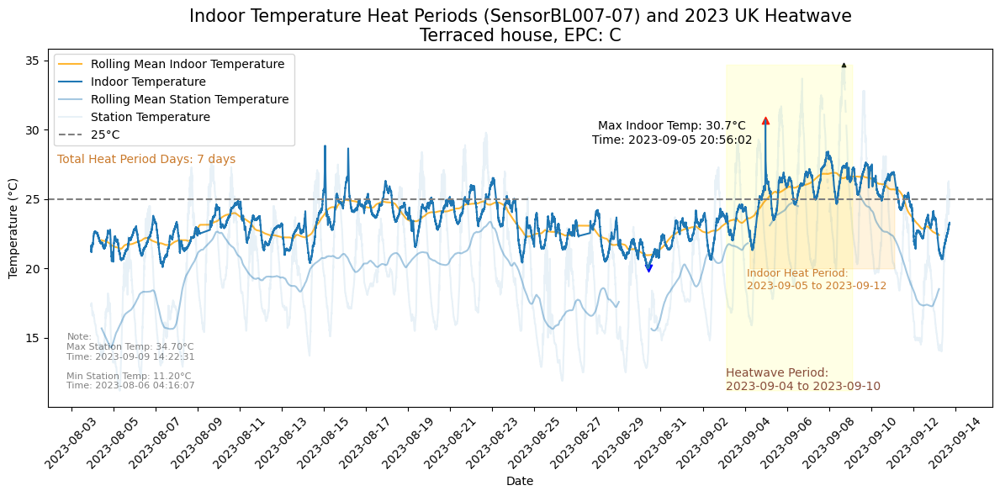

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sliced_df['heatstress'] = sliced_df.apply(lambda row: calculate_heat_index(row['TEMP'], row['HUM']), axis=1)
C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:353: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


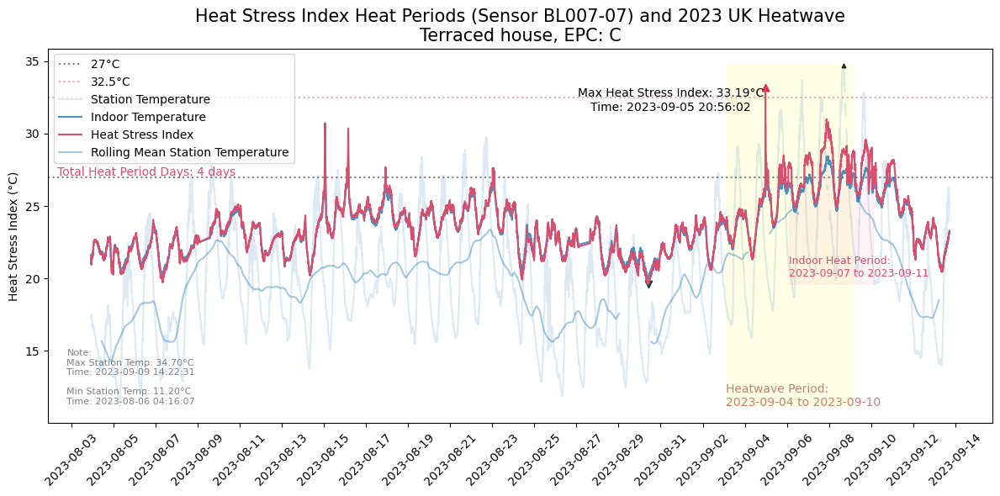

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:91: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


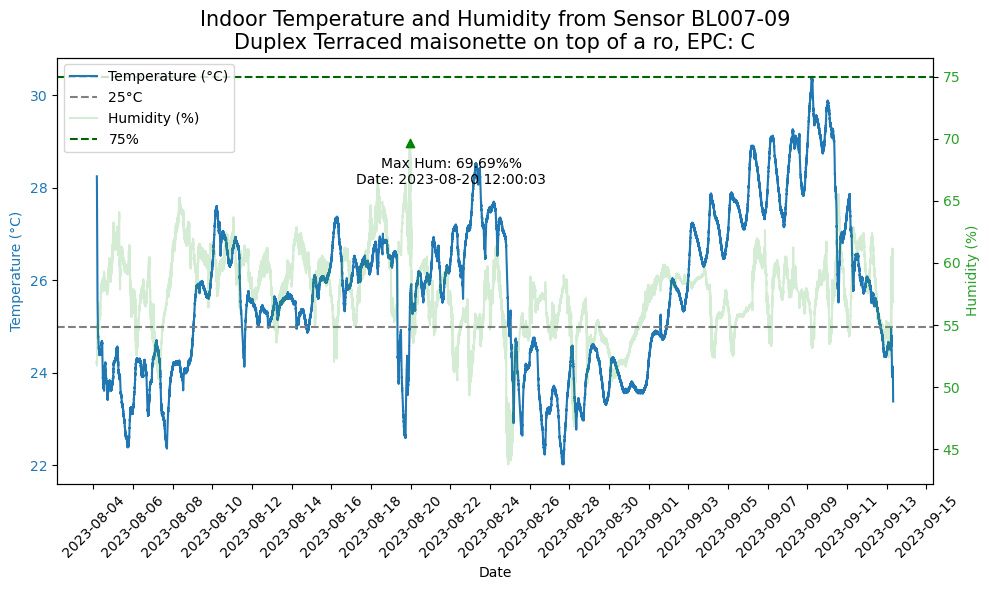

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:221: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


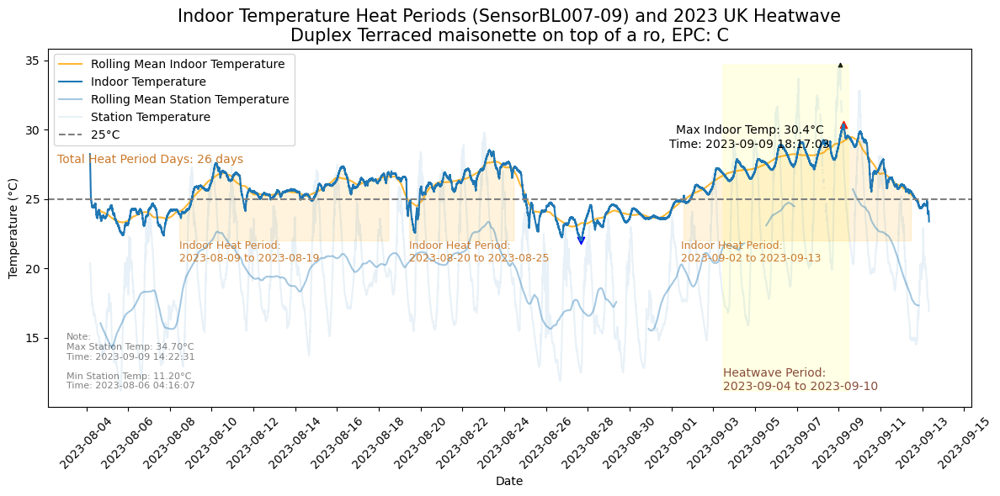

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sliced_df['heatstress'] = sliced_df.apply(lambda row: calculate_heat_index(row['TEMP'], row['HUM']), axis=1)
C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:353: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


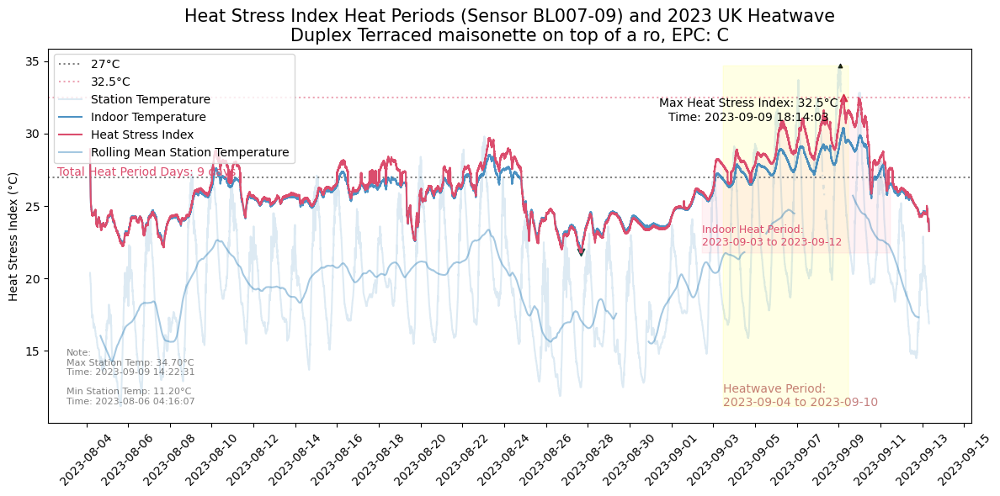

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:91: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


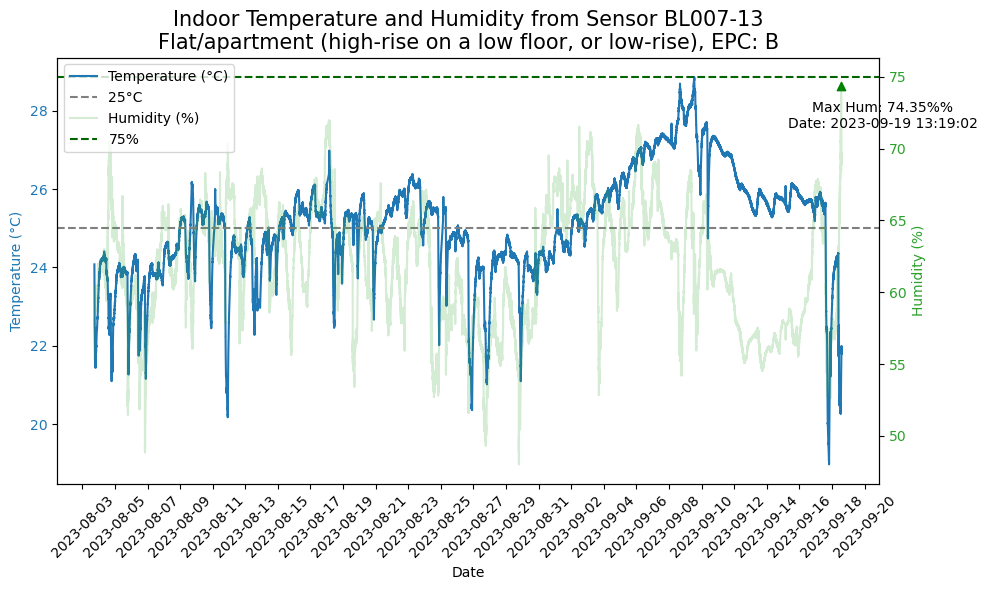

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:221: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


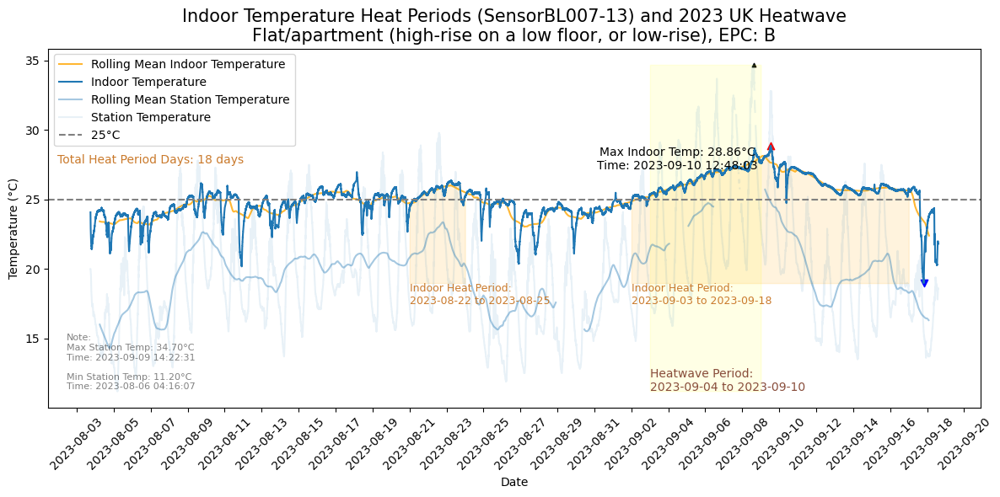

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sliced_df['heatstress'] = sliced_df.apply(lambda row: calculate_heat_index(row['TEMP'], row['HUM']), axis=1)
C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:353: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


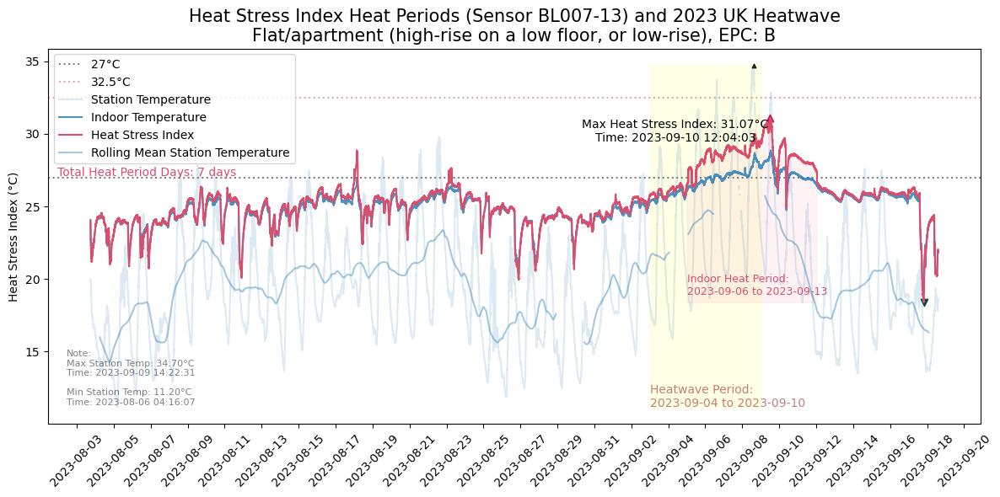

Skipping processing for sensor BL007-14


C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:91: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


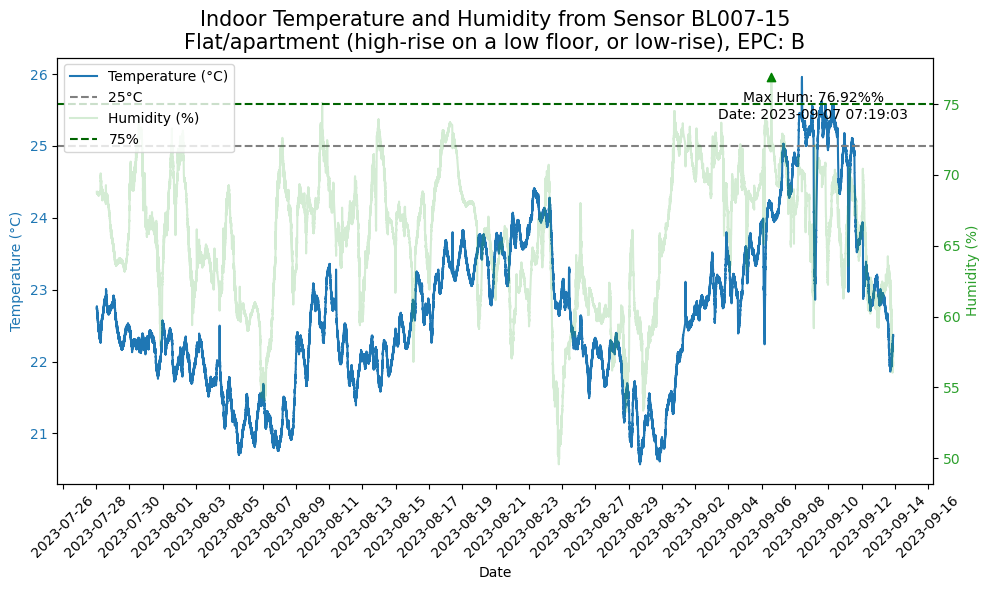

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:221: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


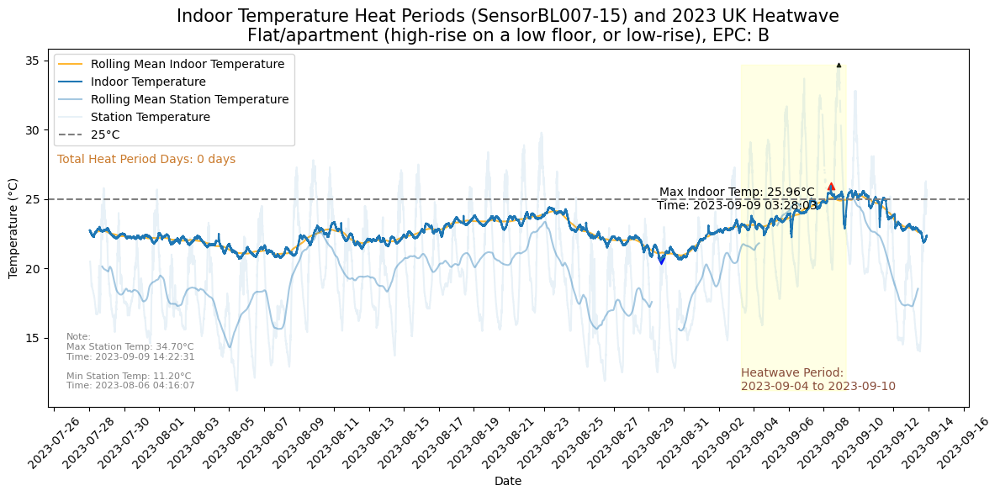

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sliced_df['heatstress'] = sliced_df.apply(lambda row: calculate_heat_index(row['TEMP'], row['HUM']), axis=1)
C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:353: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


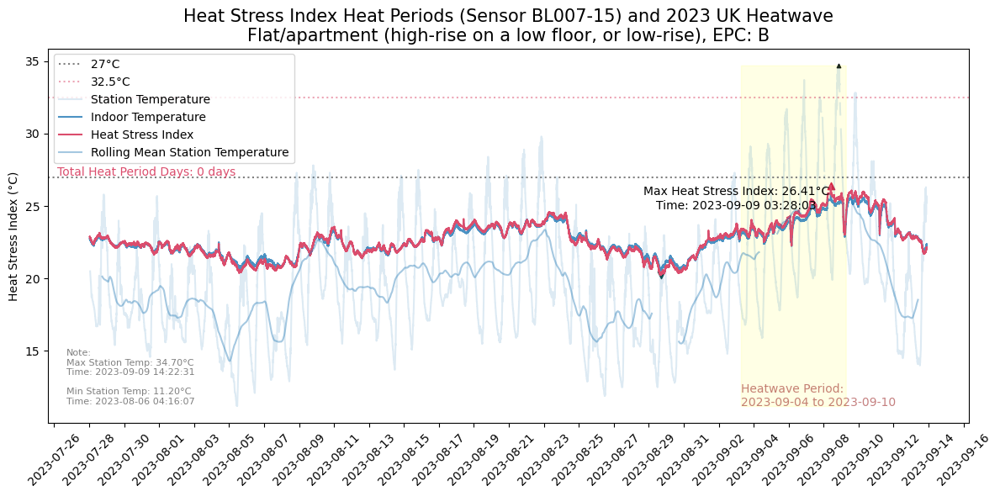

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:91: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


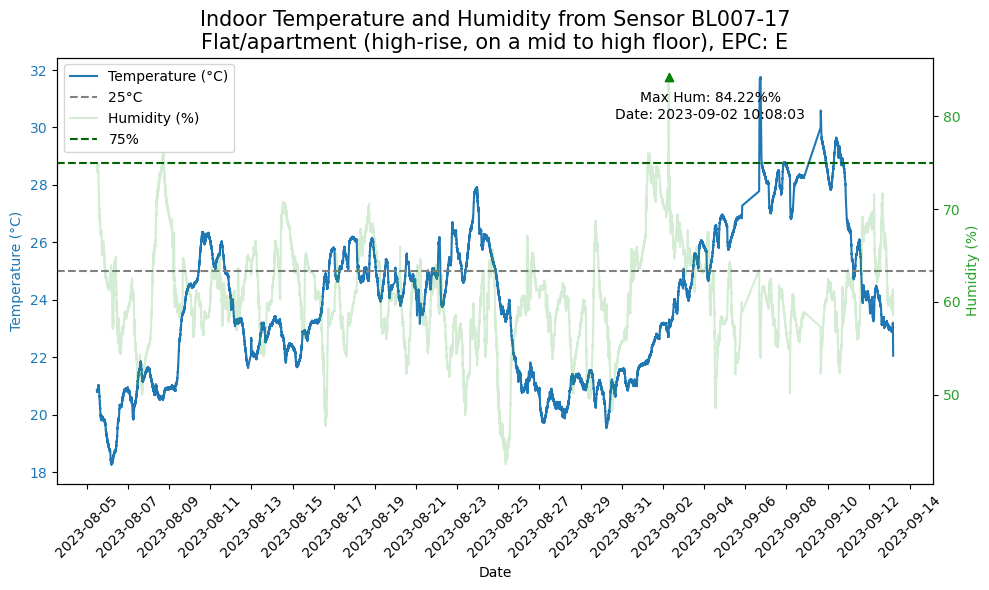

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:221: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


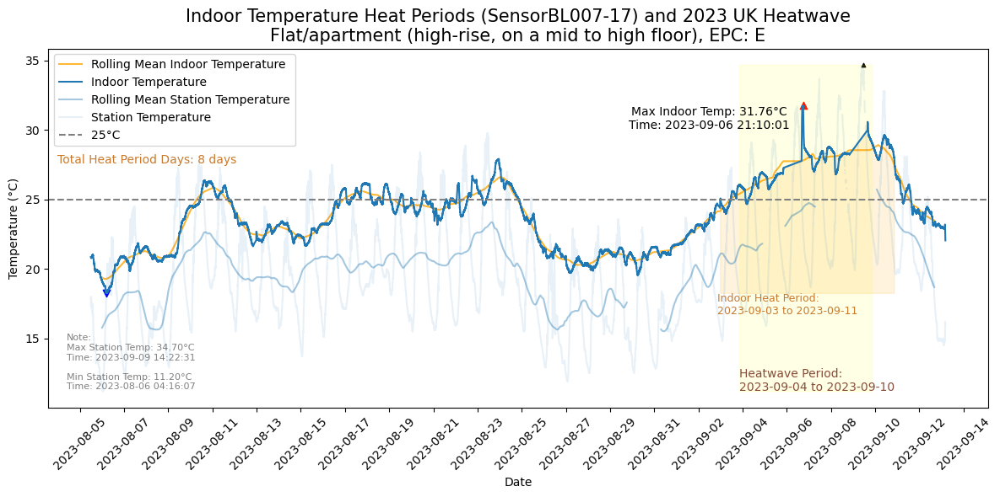

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sliced_df['heatstress'] = sliced_df.apply(lambda row: calculate_heat_index(row['TEMP'], row['HUM']), axis=1)
C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:353: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


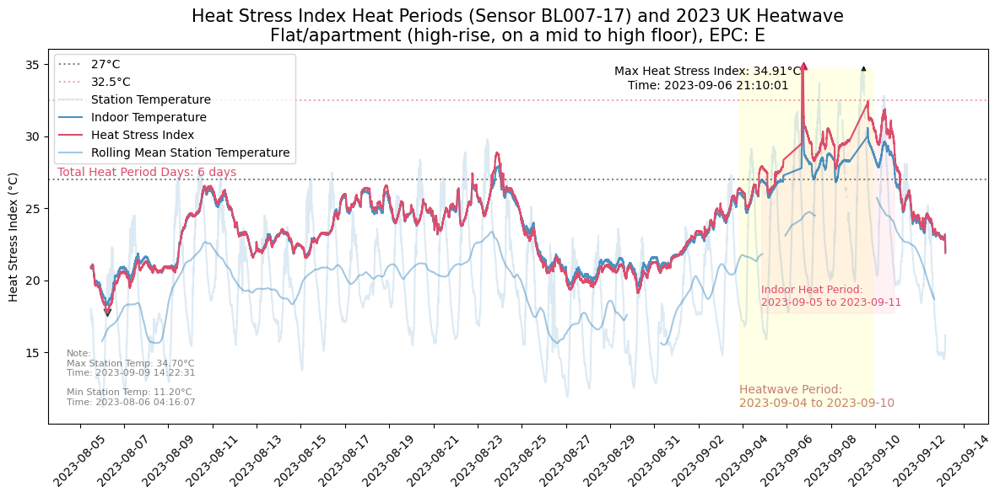

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:91: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


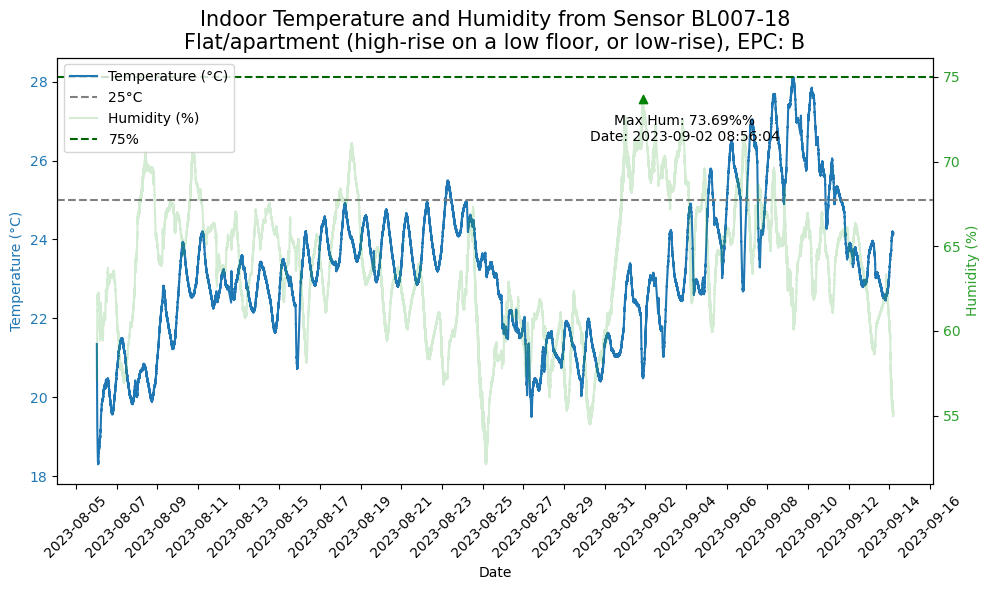

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:221: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


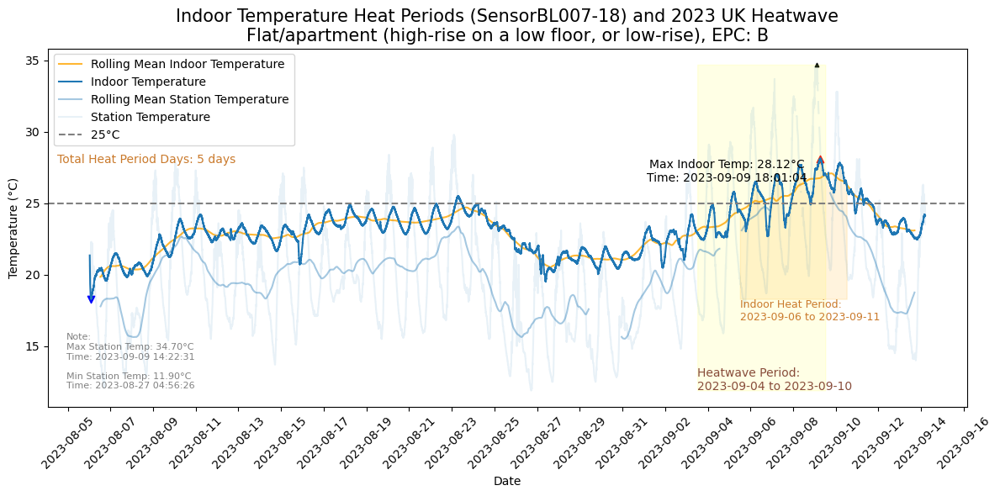

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sliced_df['heatstress'] = sliced_df.apply(lambda row: calculate_heat_index(row['TEMP'], row['HUM']), axis=1)
C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:353: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


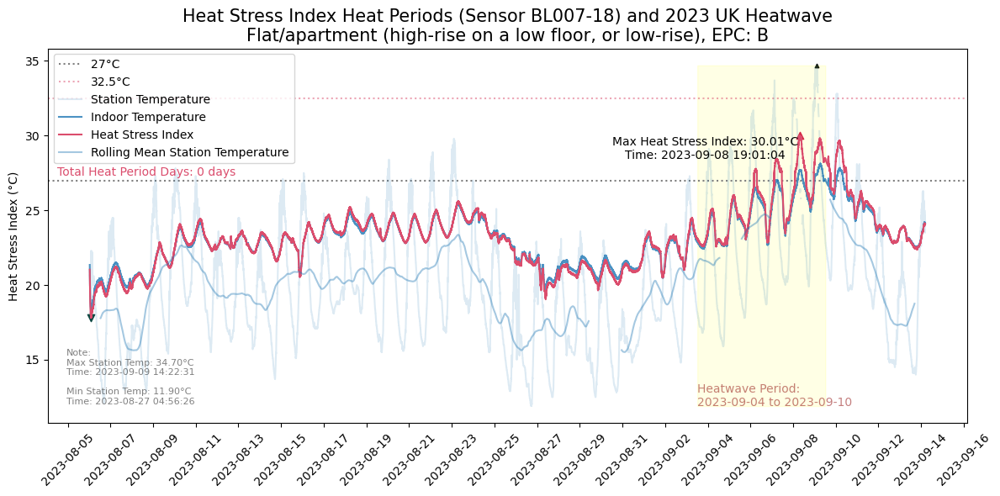

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:91: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


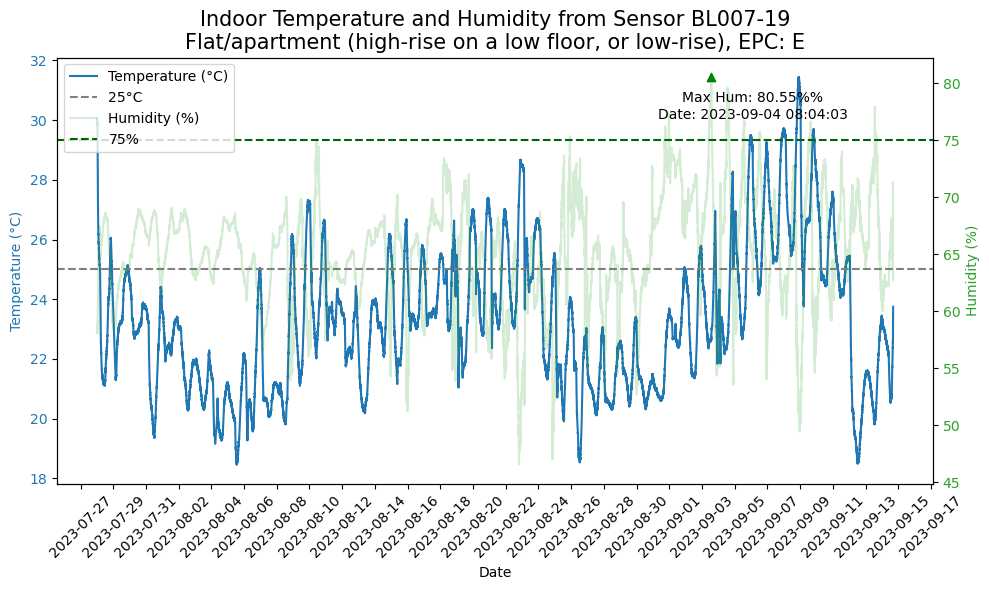

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:221: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


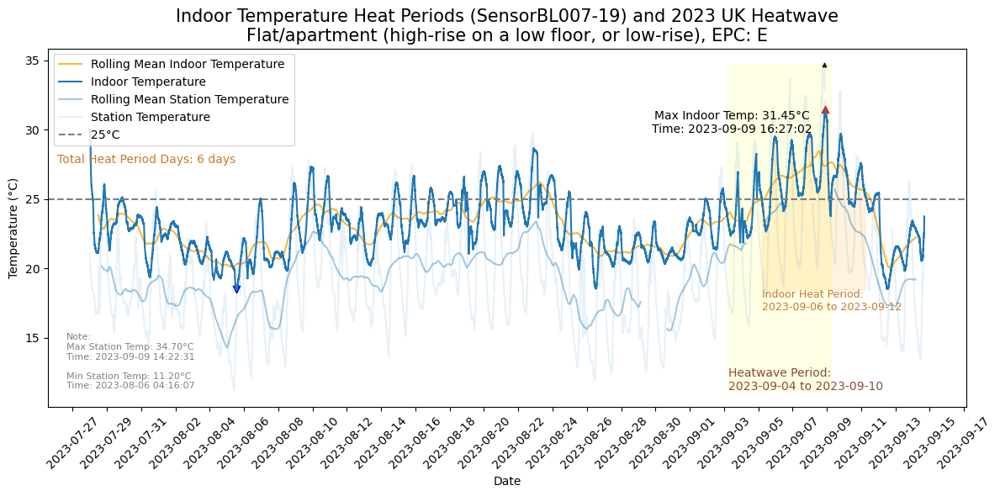

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sliced_df['heatstress'] = sliced_df.apply(lambda row: calculate_heat_index(row['TEMP'], row['HUM']), axis=1)
C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:353: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


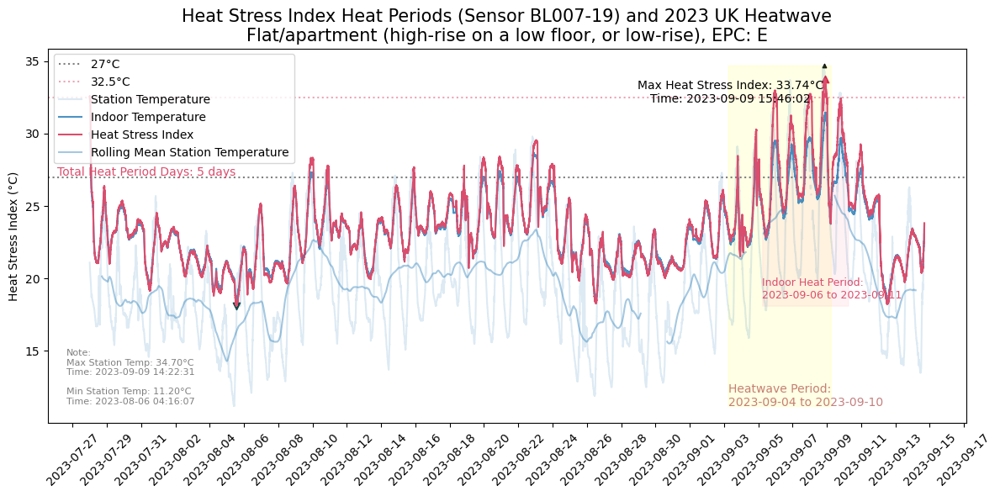

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:91: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


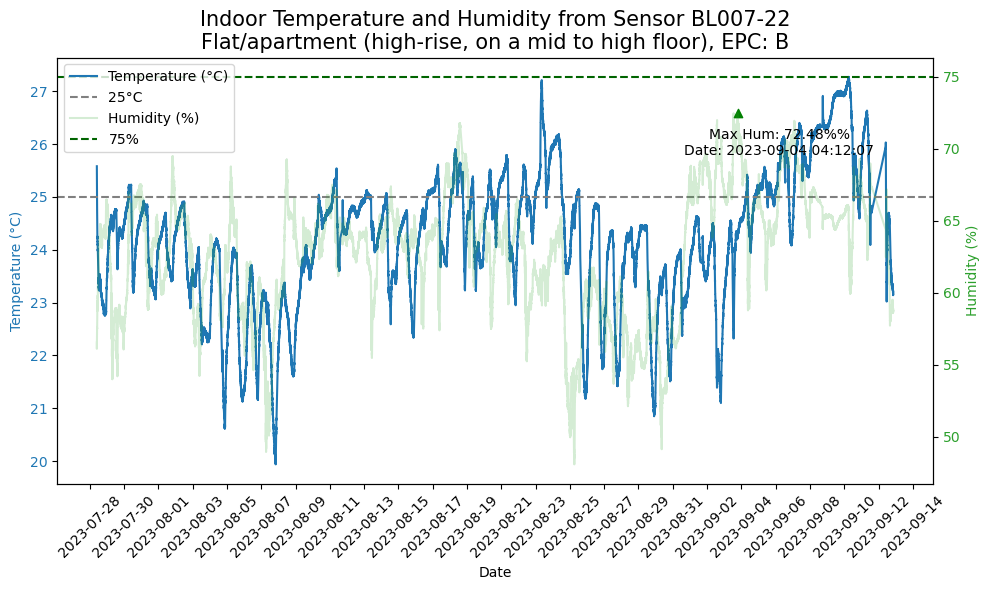

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:221: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


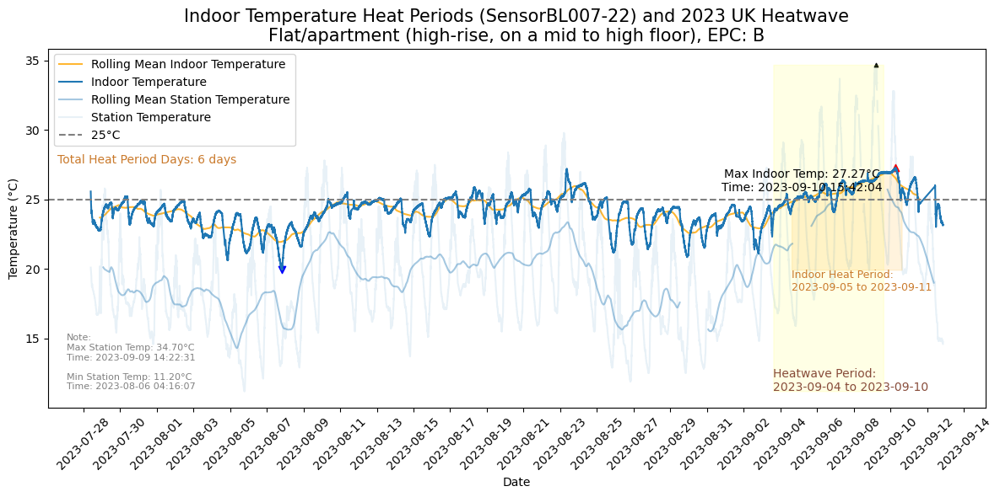

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sliced_df['heatstress'] = sliced_df.apply(lambda row: calculate_heat_index(row['TEMP'], row['HUM']), axis=1)
C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:353: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


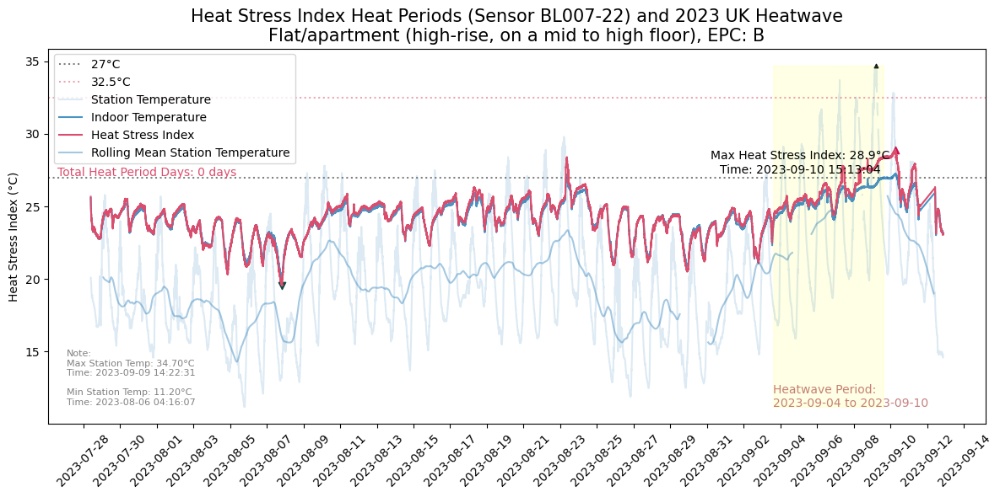

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:91: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


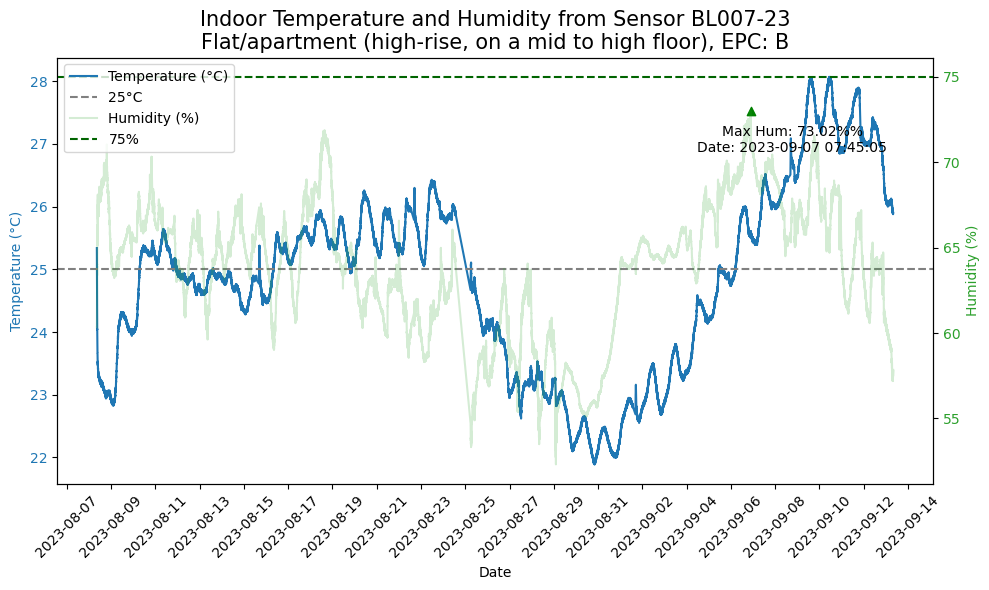

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:221: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


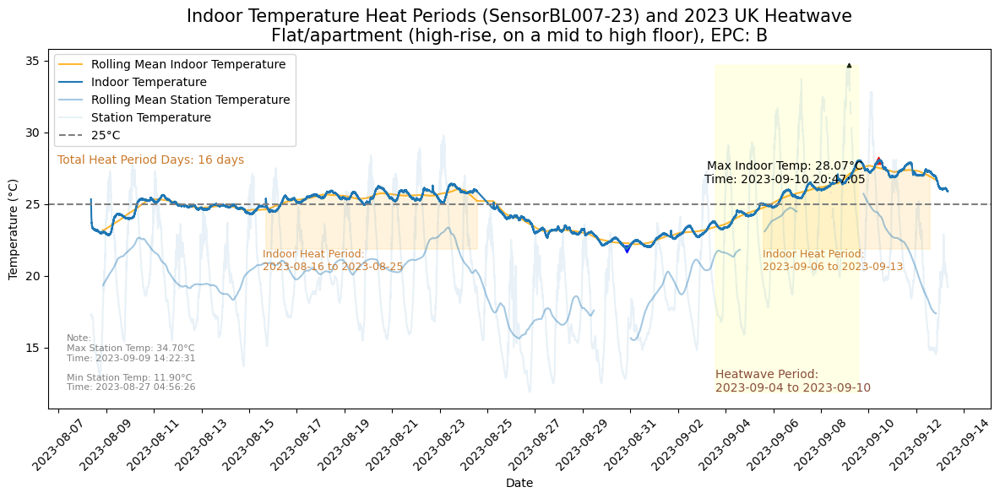

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sliced_df['heatstress'] = sliced_df.apply(lambda row: calculate_heat_index(row['TEMP'], row['HUM']), axis=1)
C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:353: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


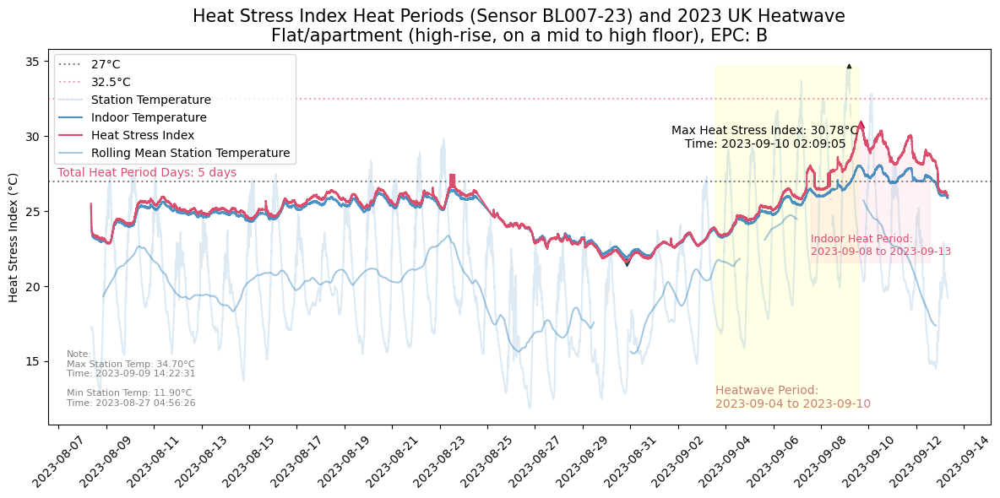

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:91: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


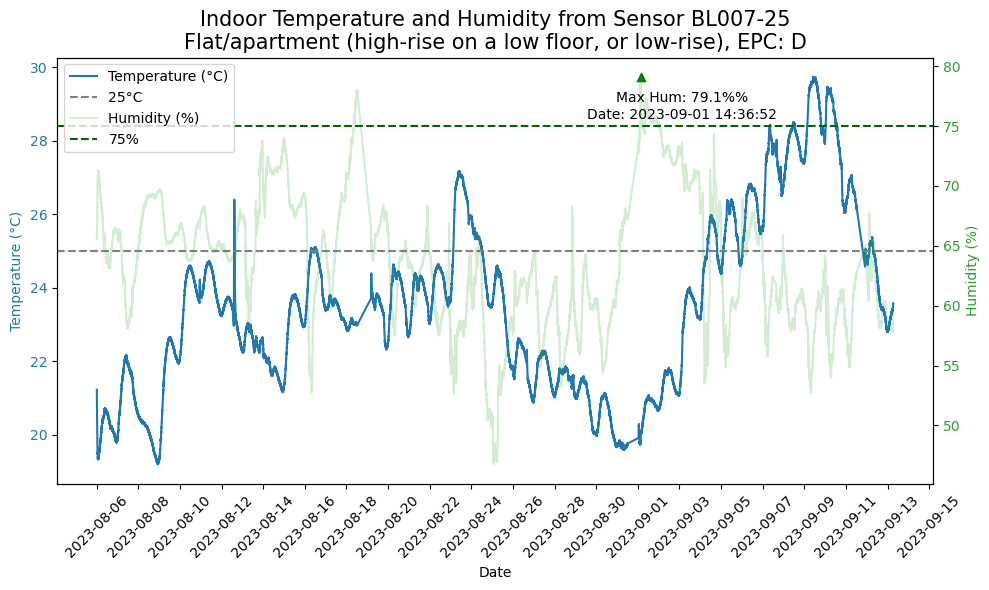

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:221: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


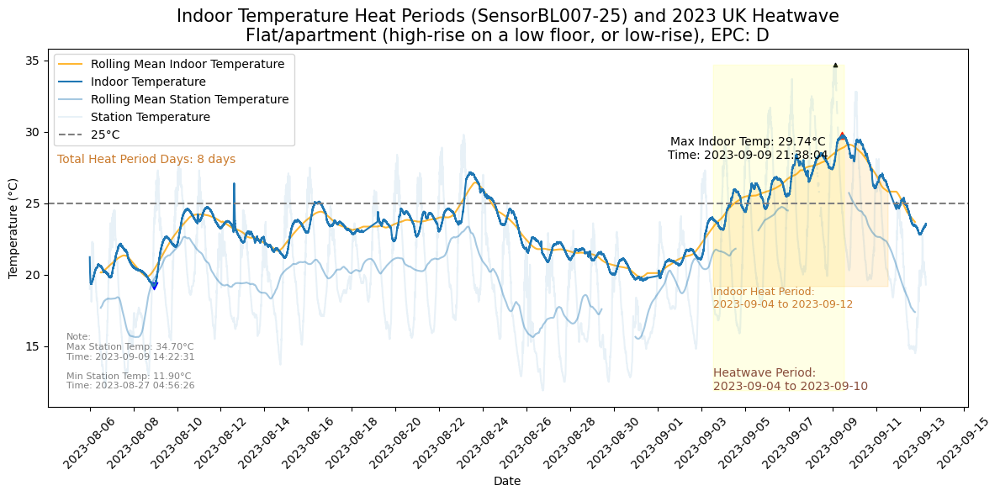

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sliced_df['heatstress'] = sliced_df.apply(lambda row: calculate_heat_index(row['TEMP'], row['HUM']), axis=1)
C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:353: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


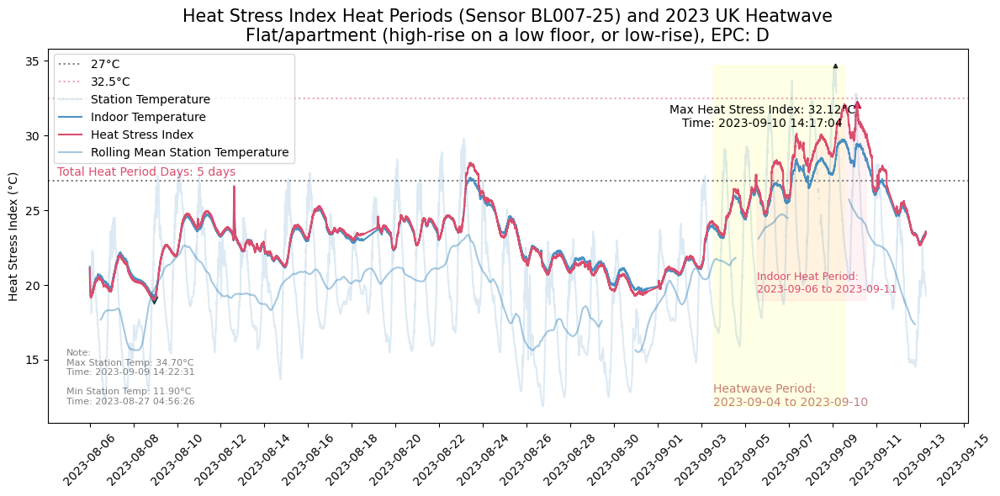

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:91: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


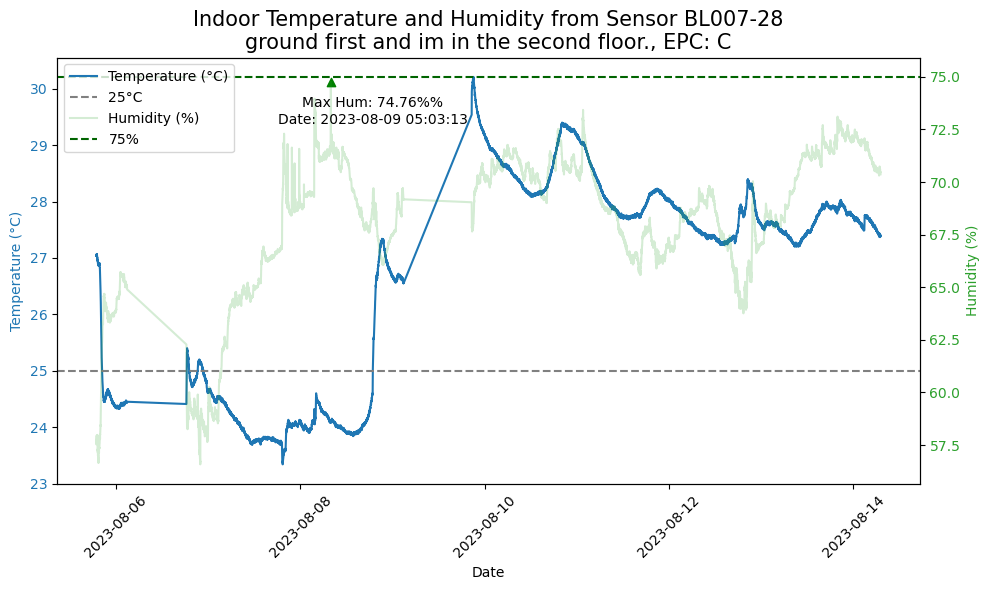

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:221: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)
C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:223: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


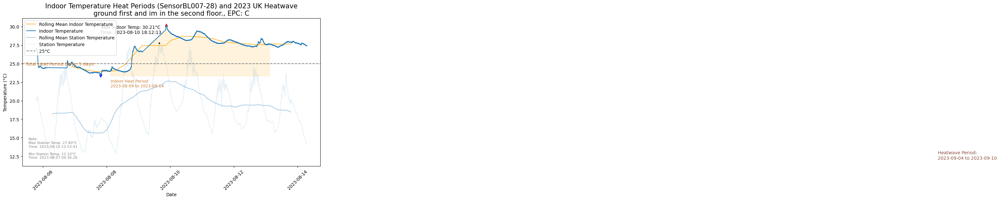

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sliced_df['heatstress'] = sliced_df.apply(lambda row: calculate_heat_index(row['TEMP'], row['HUM']), axis=1)
C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:353: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)
C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:355: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all axes decorations.
  plt.tight_layout()


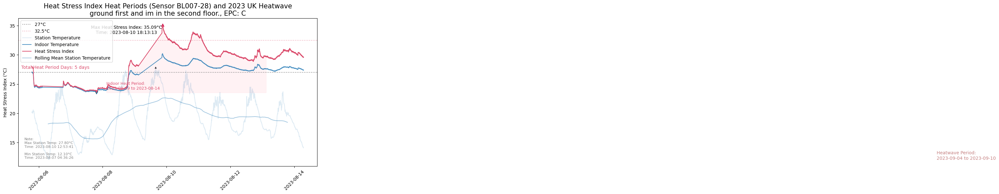

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:91: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


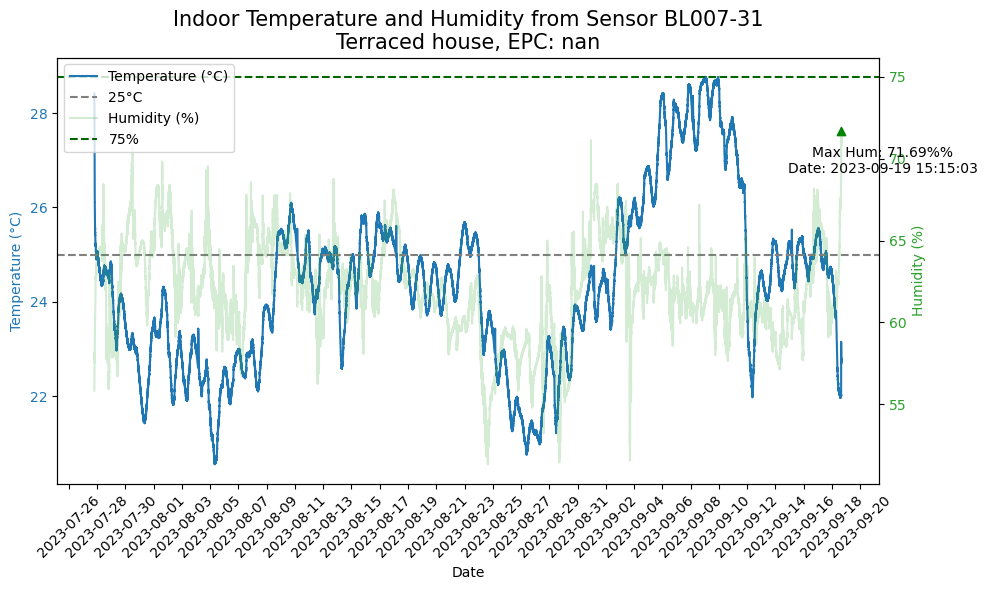

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:221: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


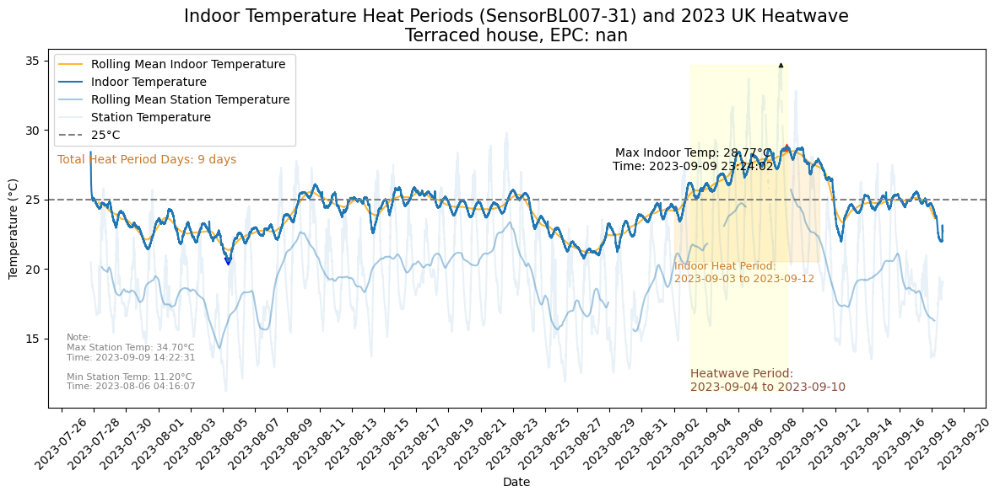

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sliced_df['heatstress'] = sliced_df.apply(lambda row: calculate_heat_index(row['TEMP'], row['HUM']), axis=1)
C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:353: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


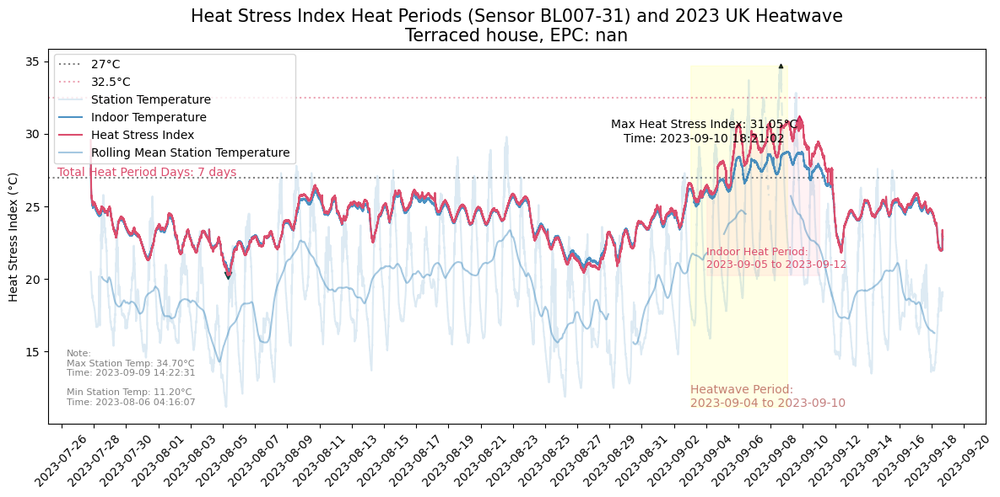

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:91: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


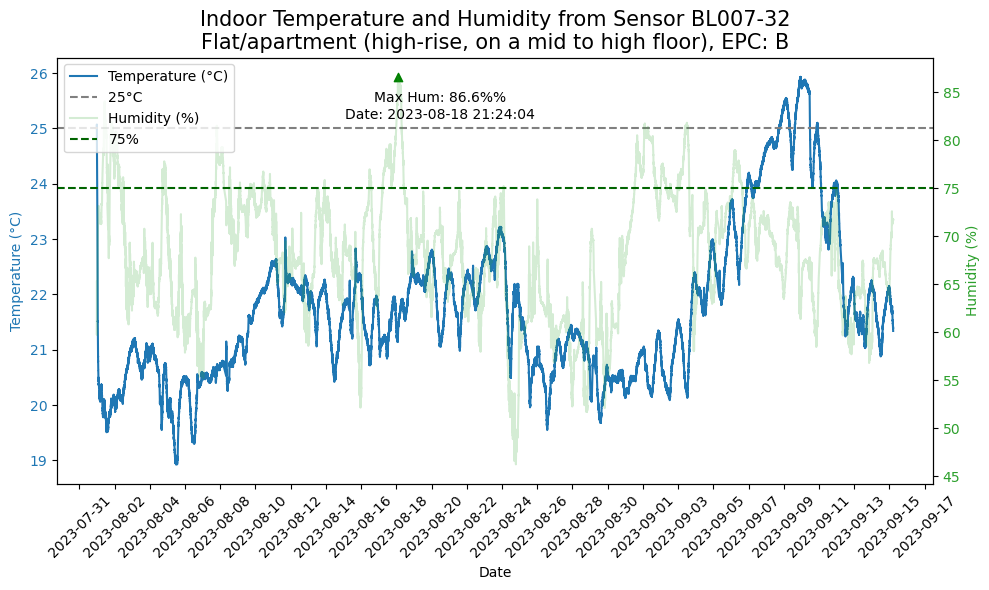

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:221: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


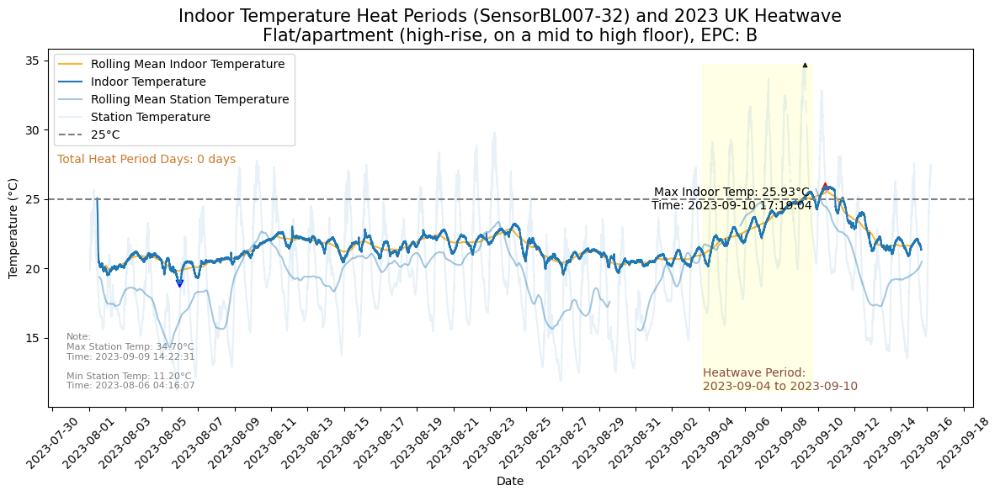

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:353: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


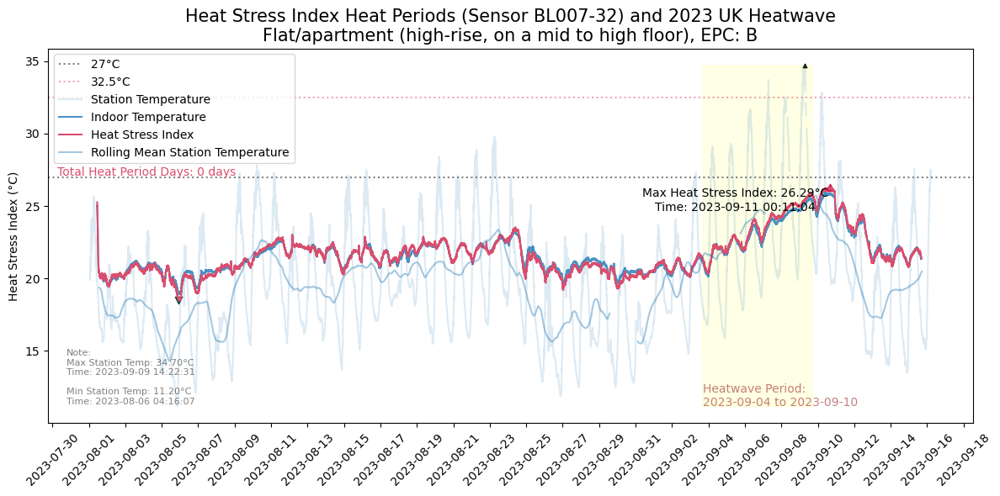

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:91: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


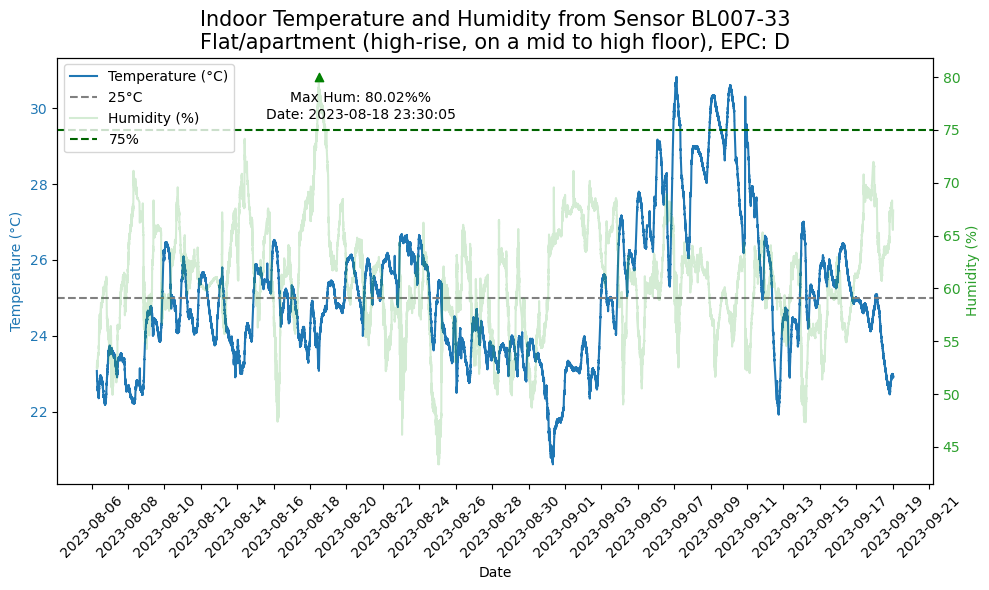

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:221: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


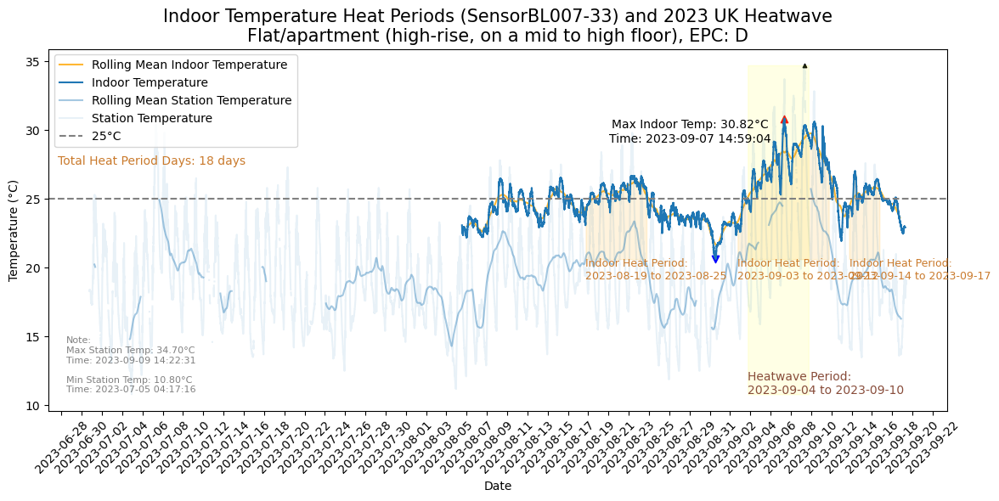

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:353: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


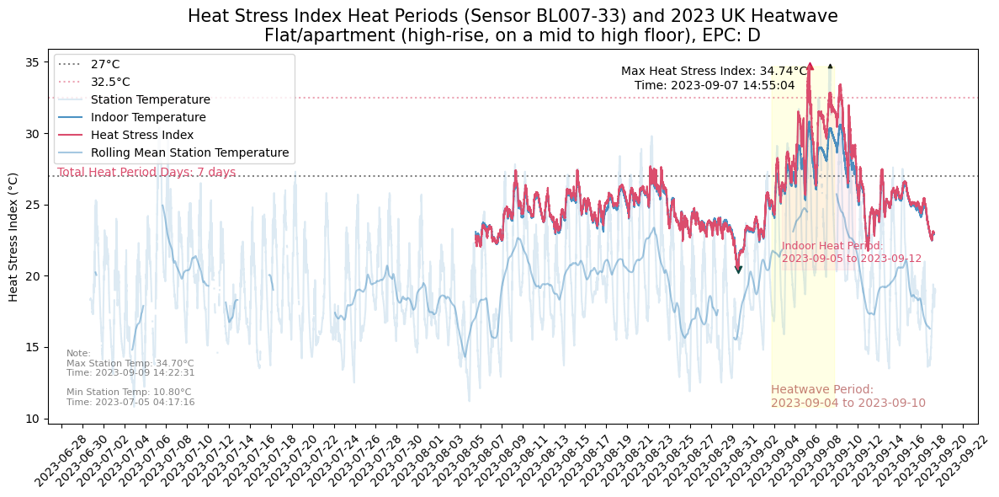

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:91: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


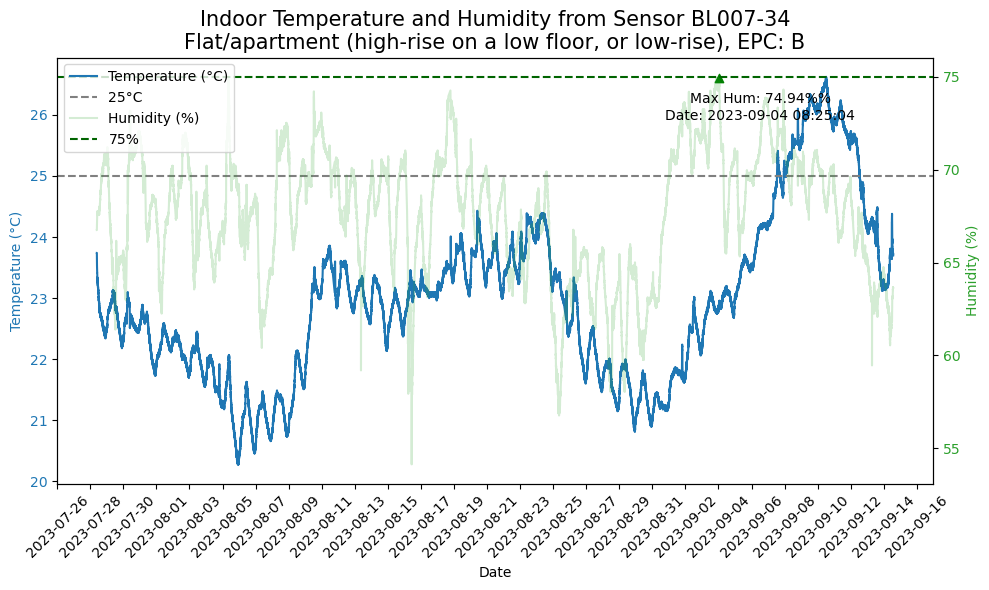

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:221: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


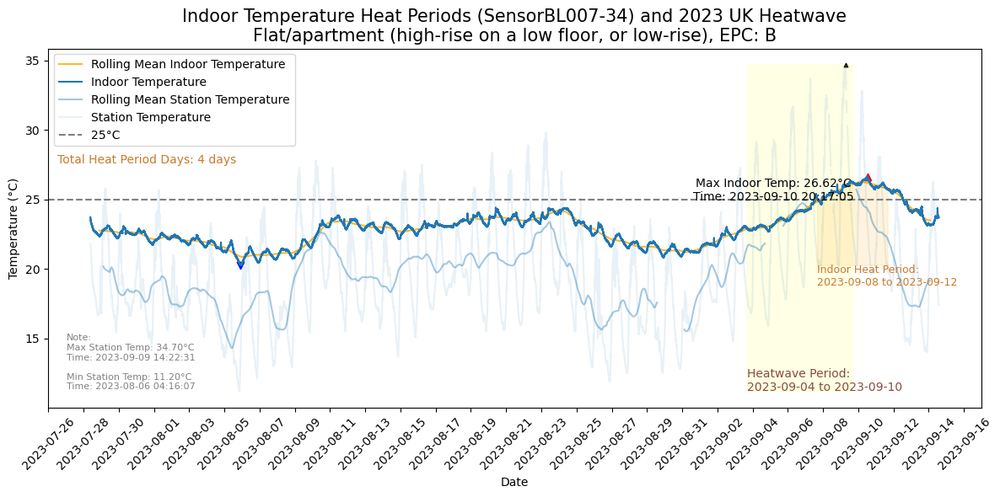

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sliced_df['heatstress'] = sliced_df.apply(lambda row: calculate_heat_index(row['TEMP'], row['HUM']), axis=1)
C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:353: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


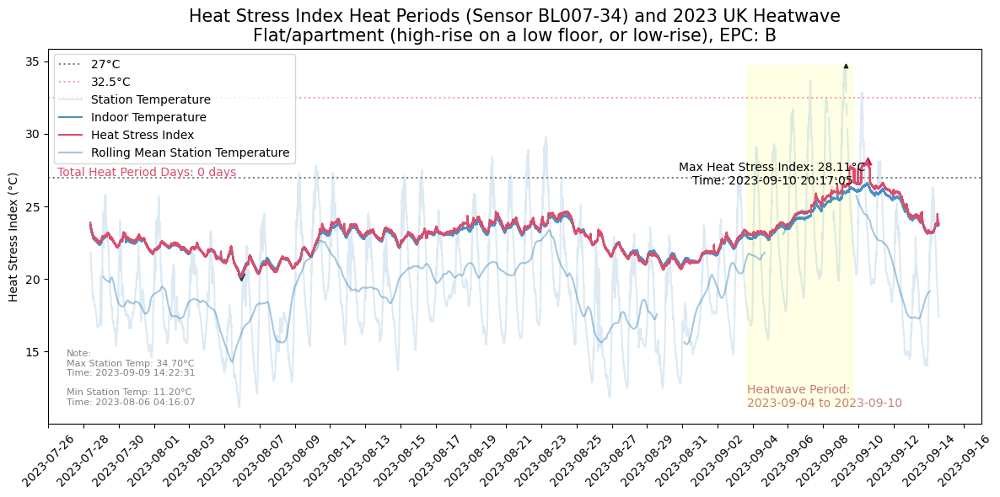

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:91: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


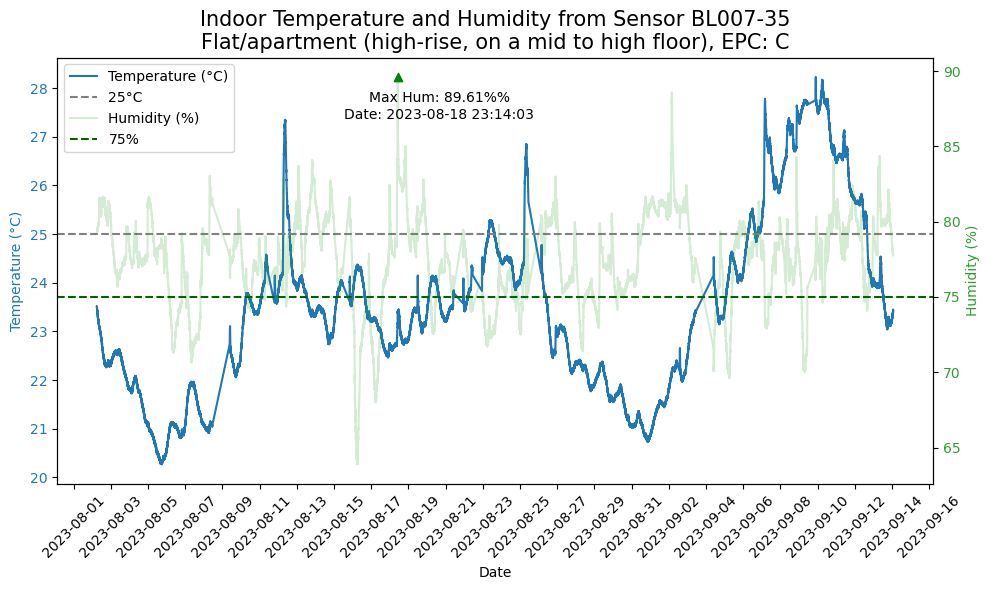

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:221: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


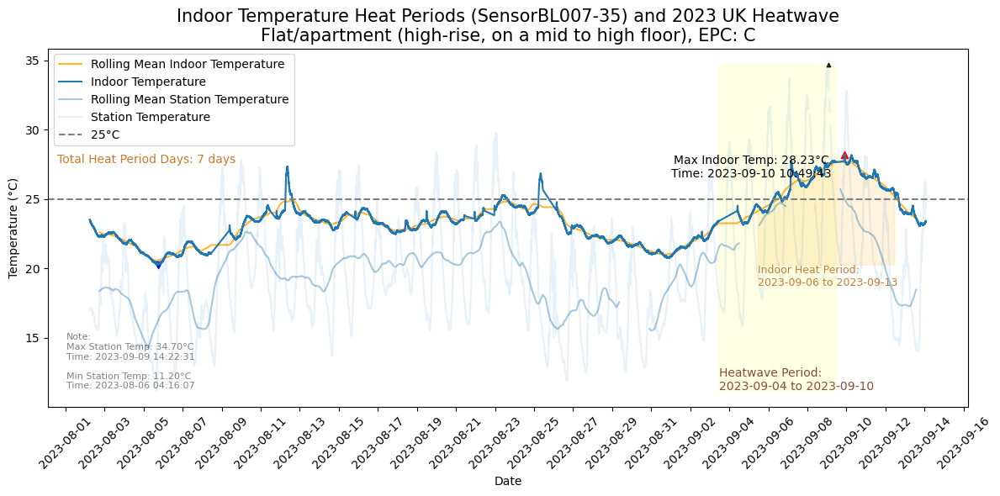

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sliced_df['heatstress'] = sliced_df.apply(lambda row: calculate_heat_index(row['TEMP'], row['HUM']), axis=1)
C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:353: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


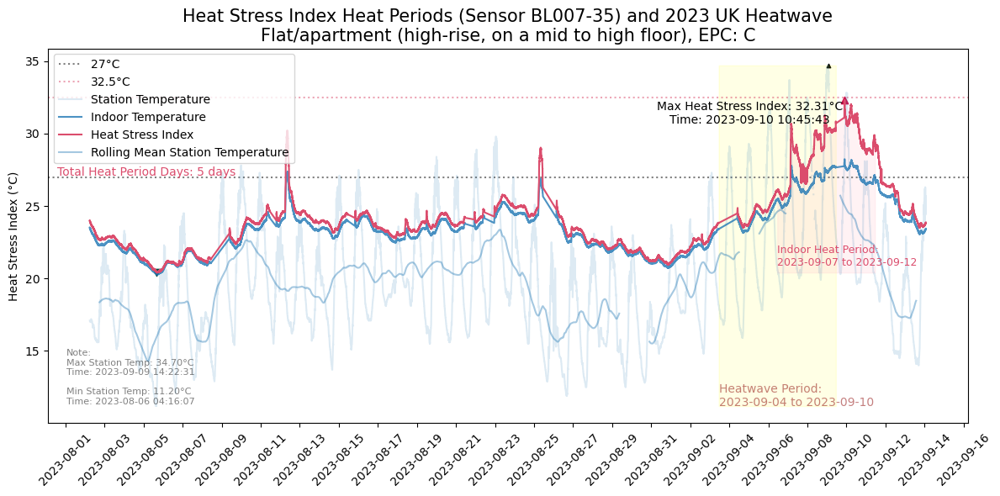

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:91: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


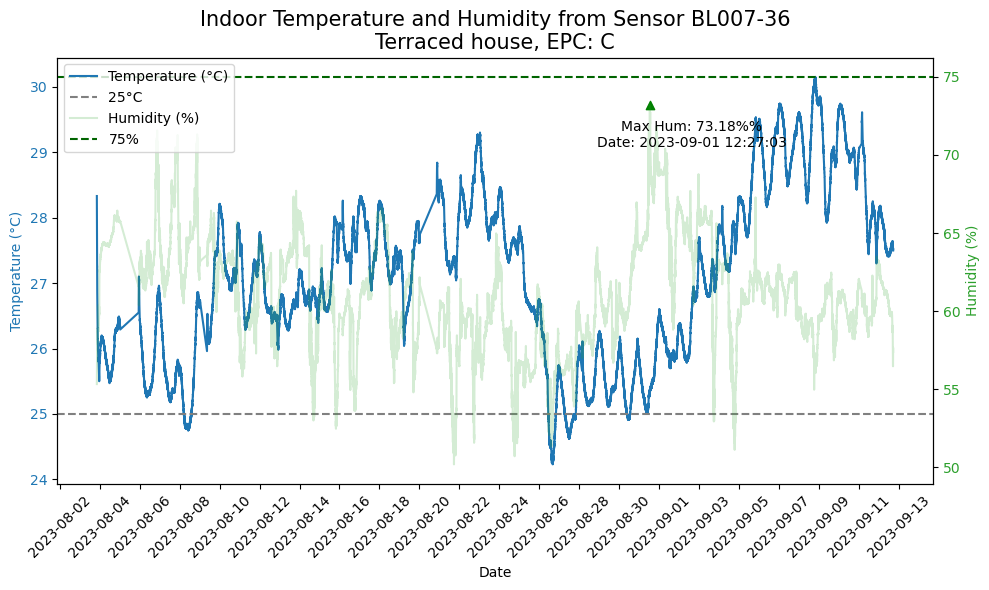

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:221: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


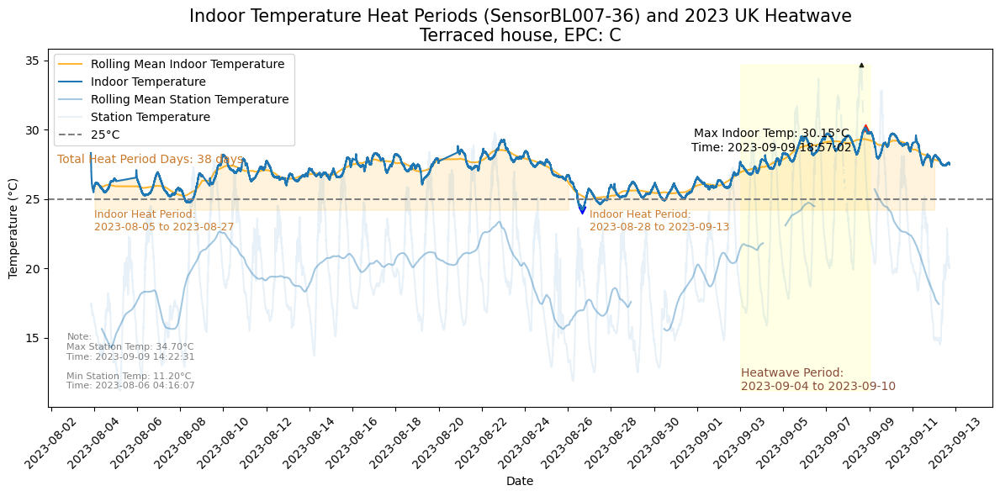

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sliced_df['heatstress'] = sliced_df.apply(lambda row: calculate_heat_index(row['TEMP'], row['HUM']), axis=1)
C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:353: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


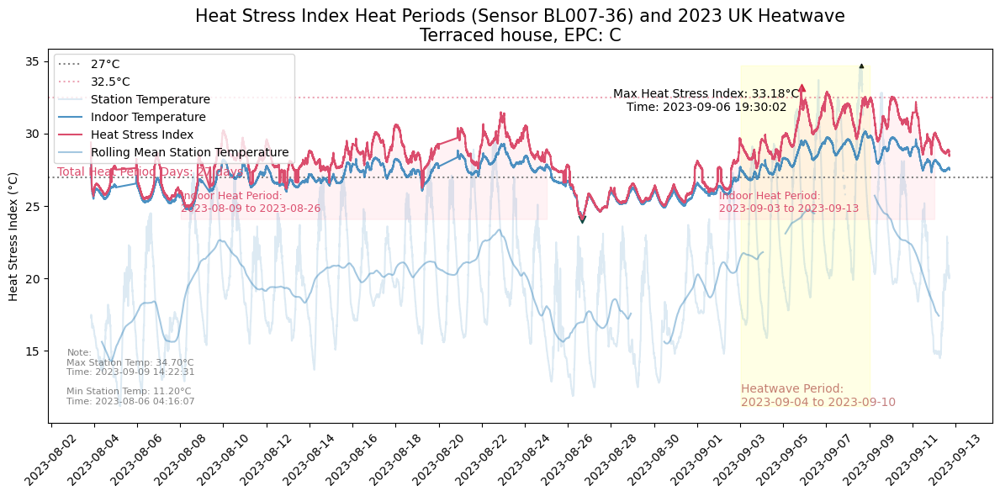

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:91: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


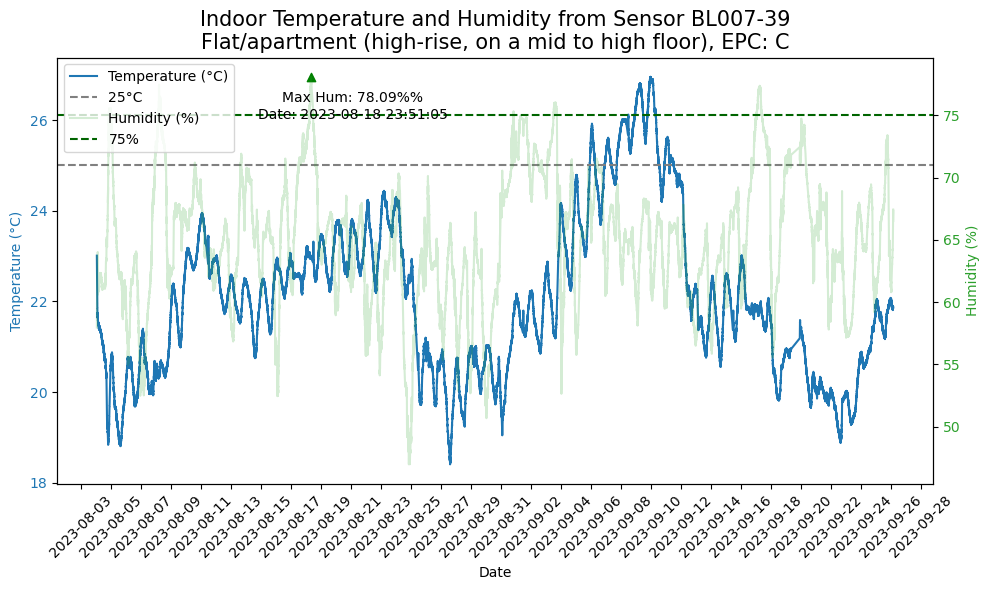

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:221: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


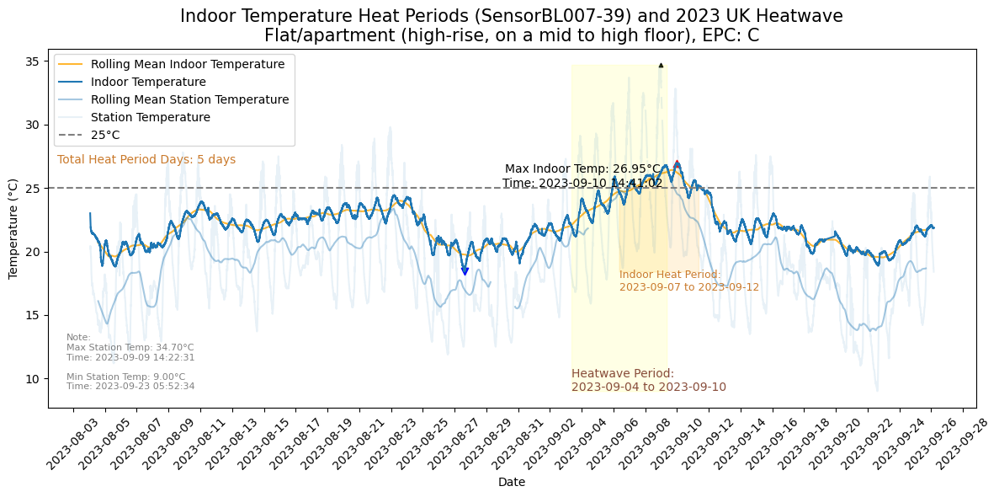

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sliced_df['heatstress'] = sliced_df.apply(lambda row: calculate_heat_index(row['TEMP'], row['HUM']), axis=1)
C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:353: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


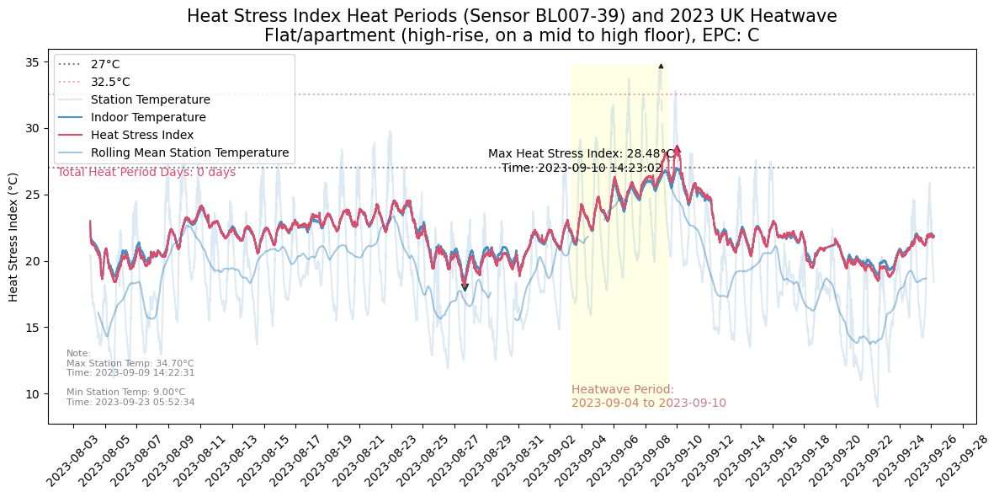

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:91: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


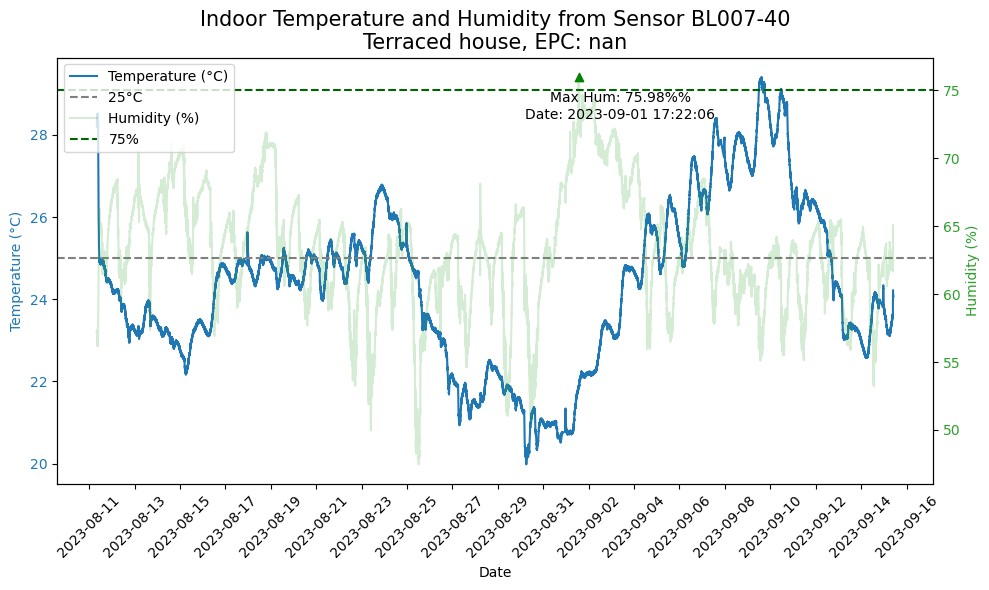

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:221: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


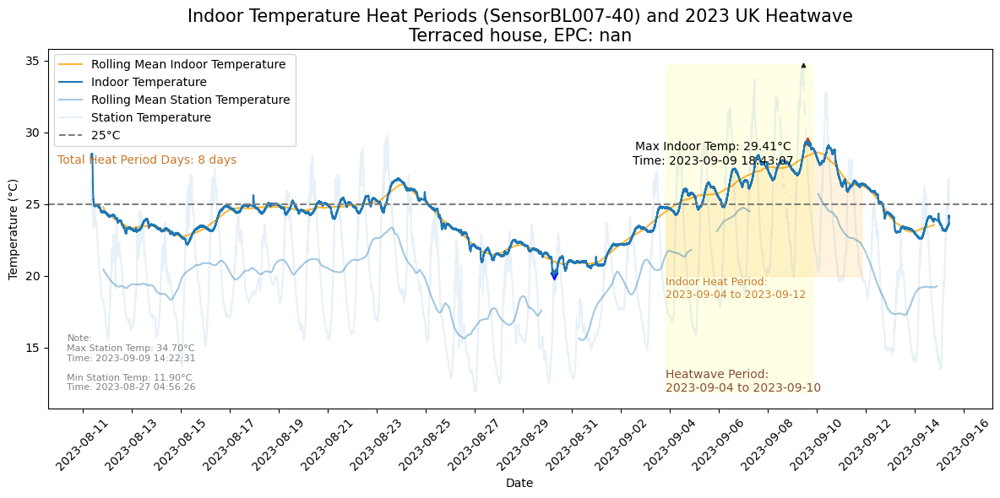

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sliced_df['heatstress'] = sliced_df.apply(lambda row: calculate_heat_index(row['TEMP'], row['HUM']), axis=1)
C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:353: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


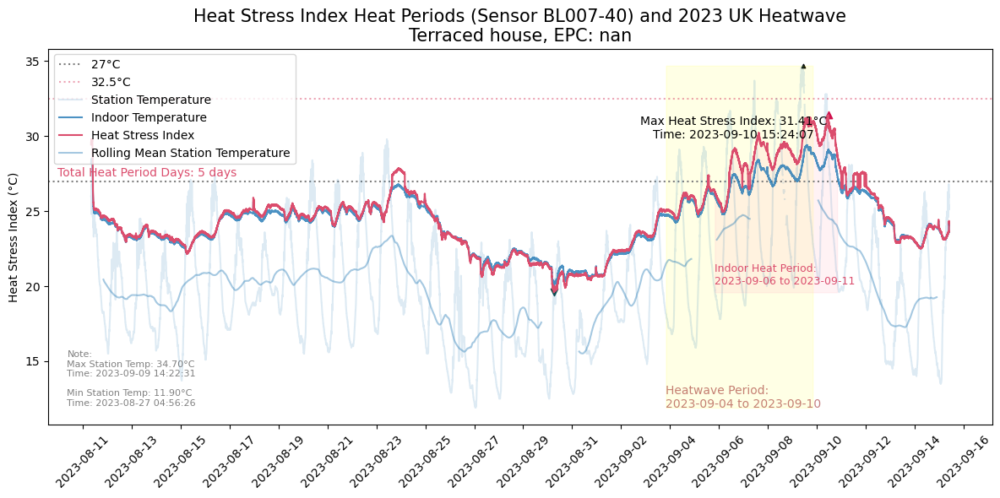

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:91: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


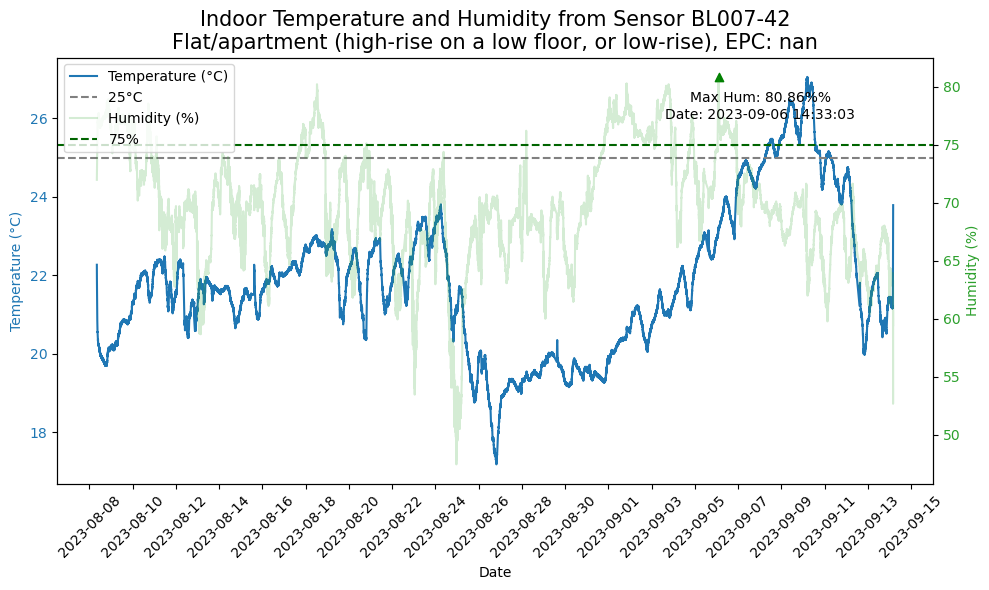

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:221: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


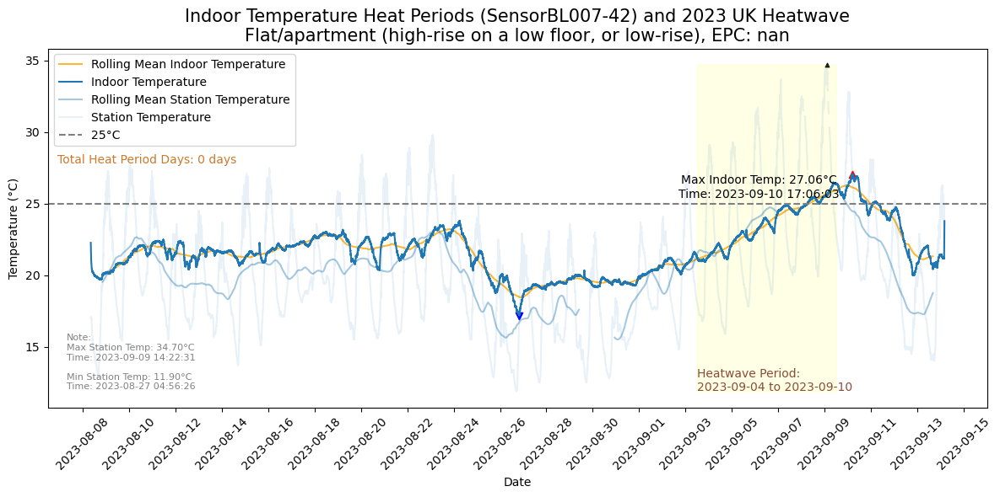

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sliced_df['heatstress'] = sliced_df.apply(lambda row: calculate_heat_index(row['TEMP'], row['HUM']), axis=1)
C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:353: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


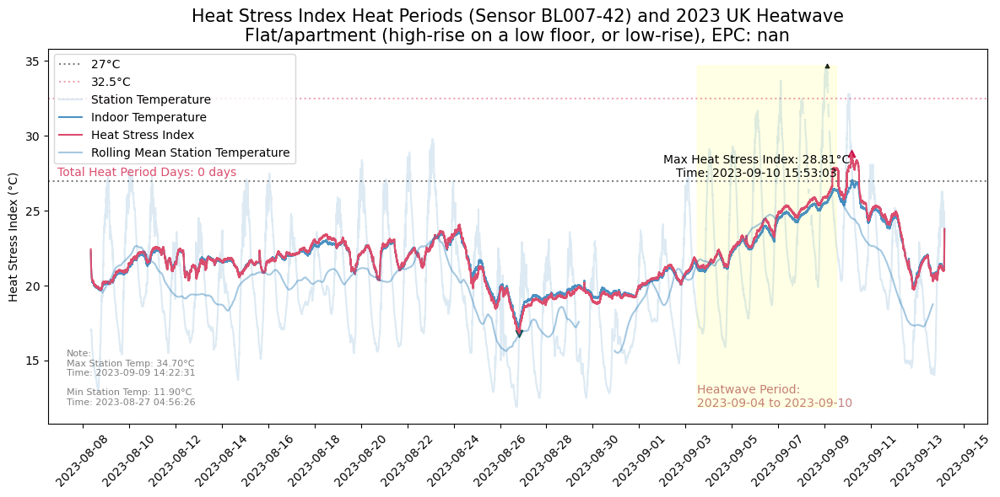

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:91: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


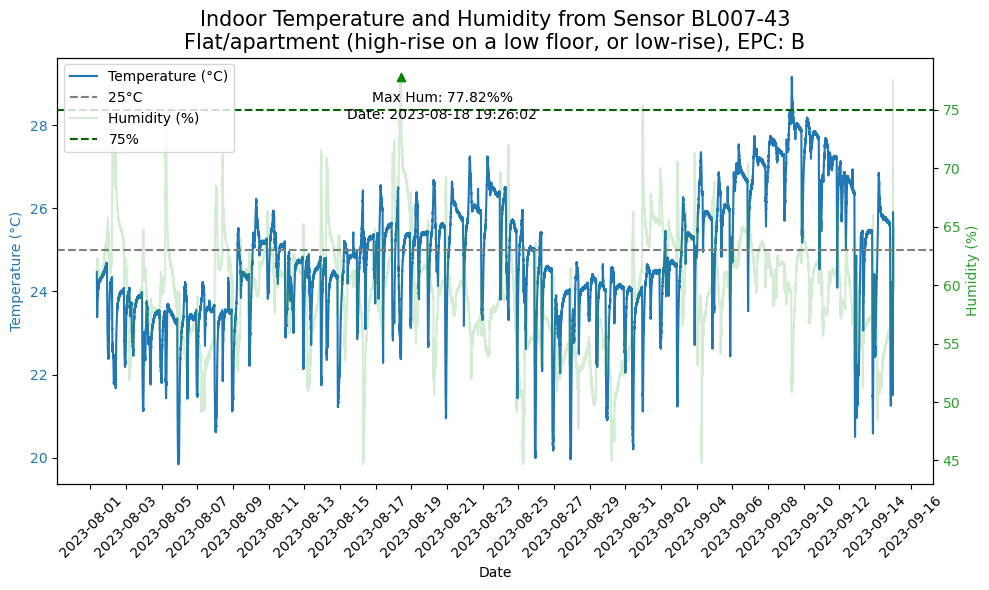

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:221: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


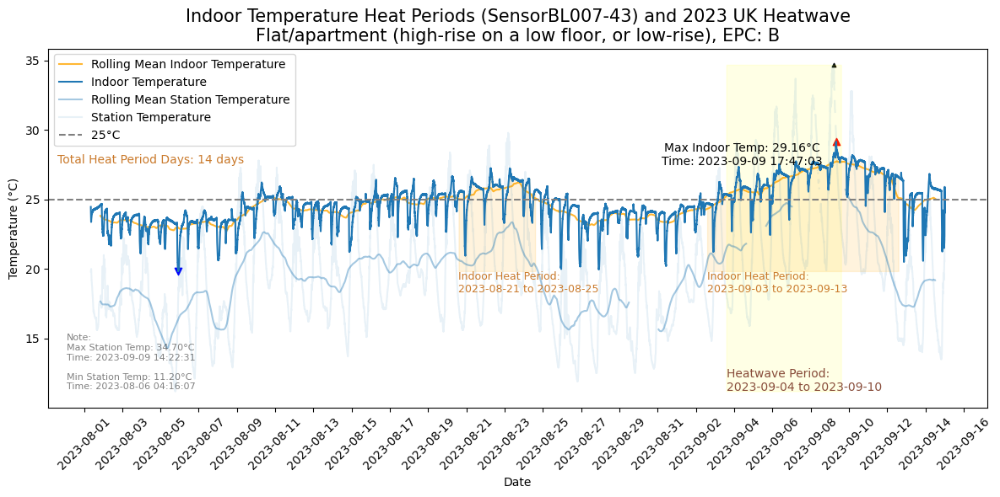

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sliced_df['heatstress'] = sliced_df.apply(lambda row: calculate_heat_index(row['TEMP'], row['HUM']), axis=1)
C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:353: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


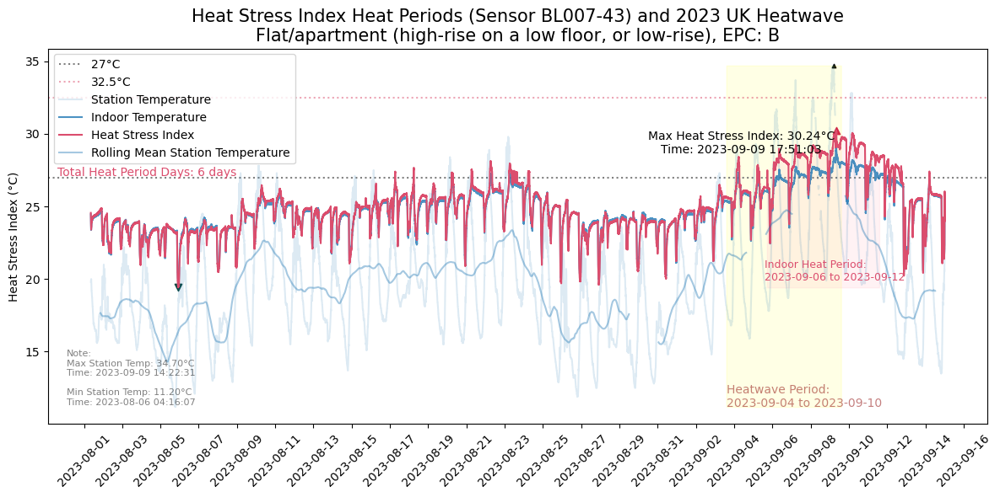

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:91: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


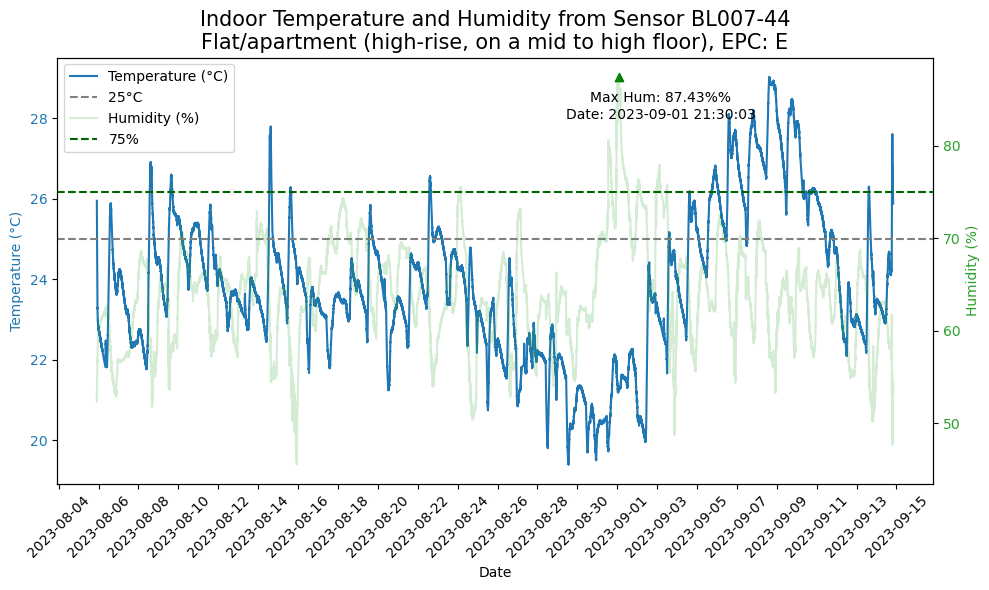

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:221: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


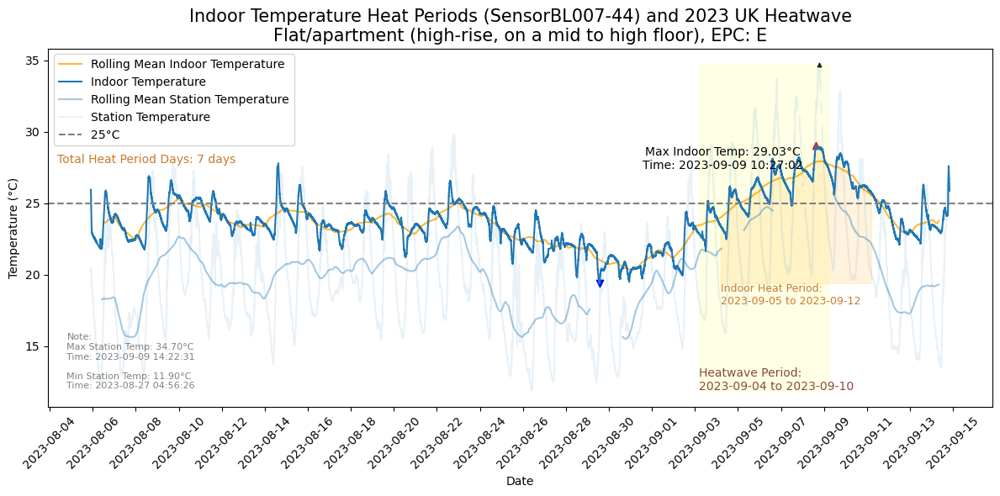

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sliced_df['heatstress'] = sliced_df.apply(lambda row: calculate_heat_index(row['TEMP'], row['HUM']), axis=1)
C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:353: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


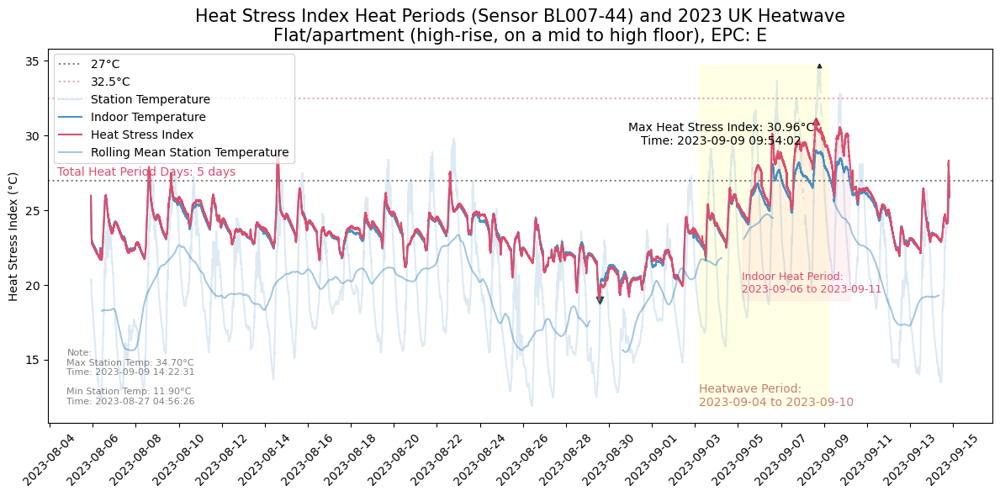

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:91: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


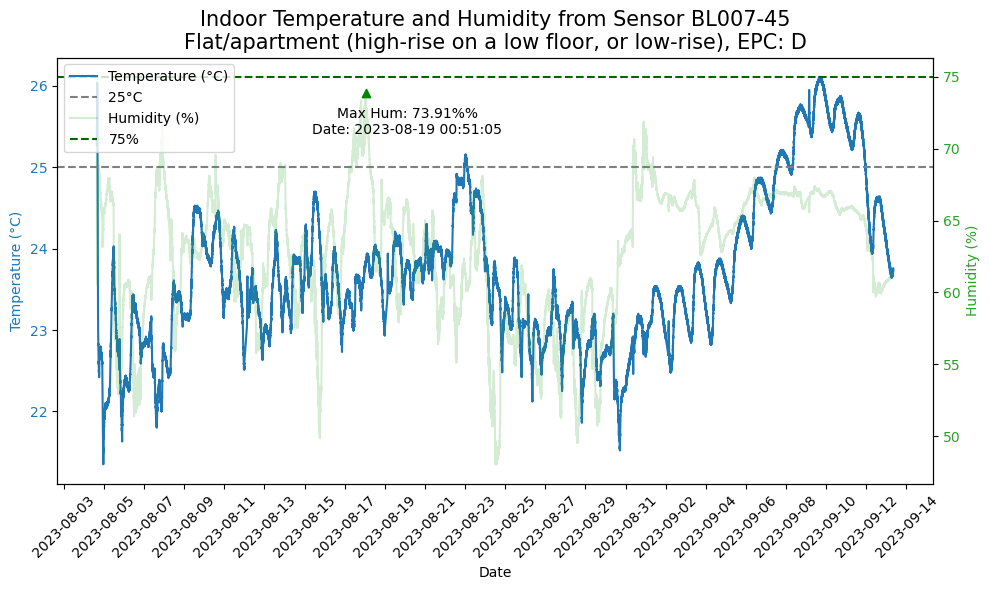

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:221: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


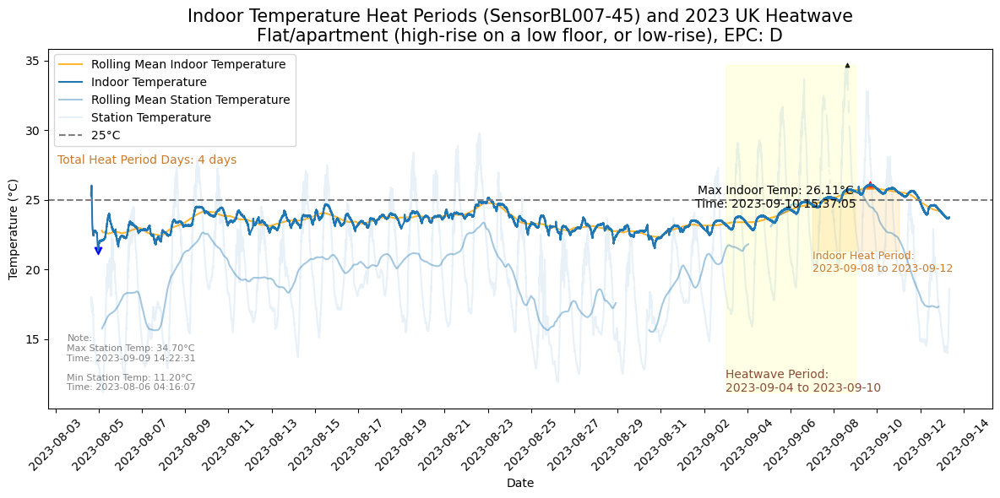

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:353: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


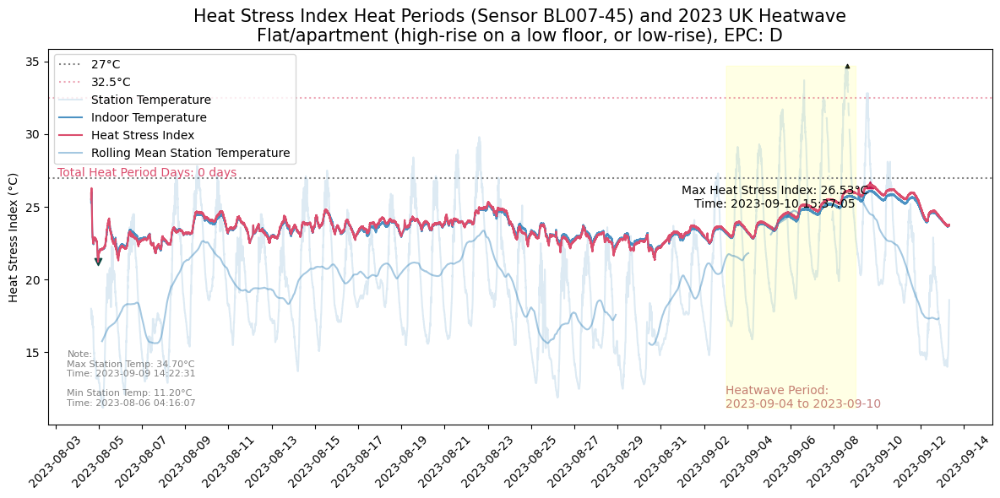

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:91: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


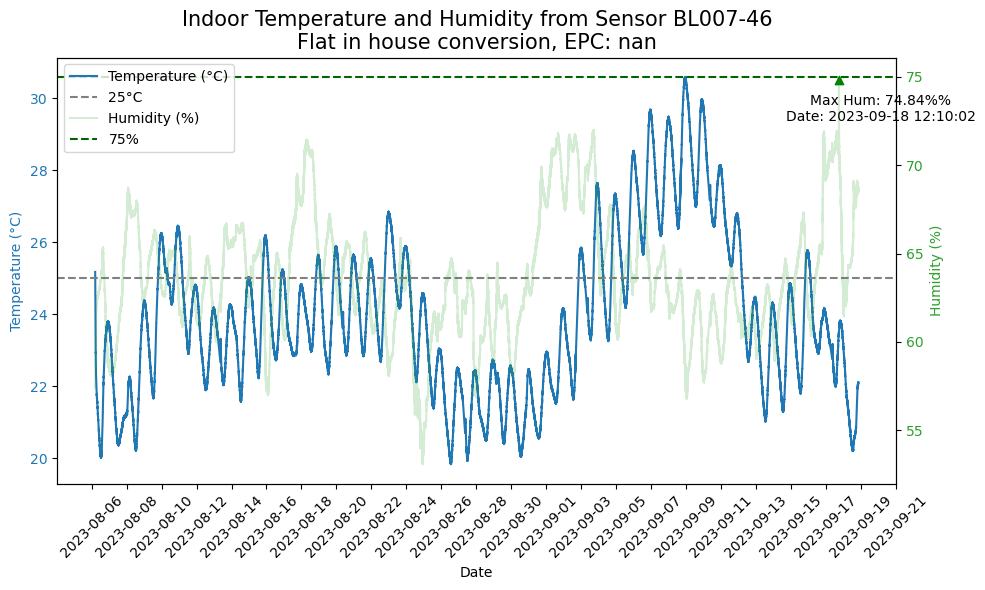

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:221: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


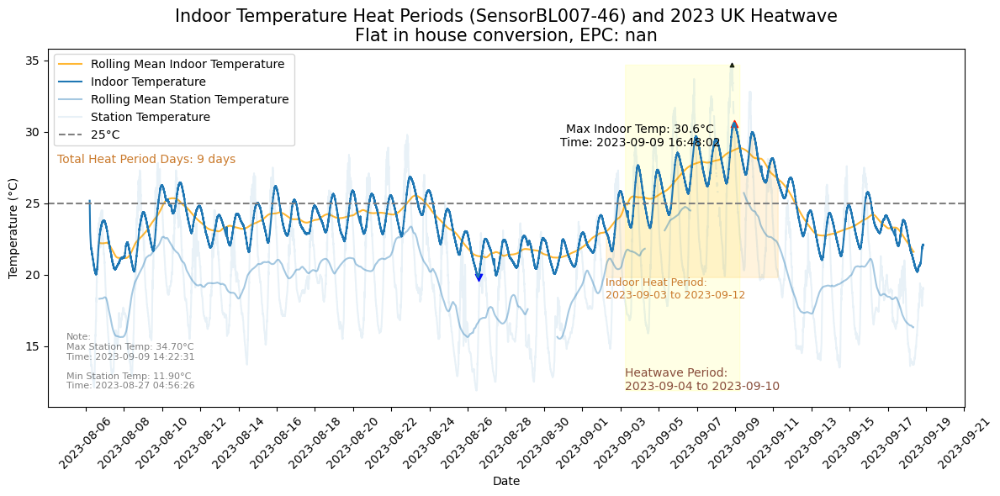

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sliced_df['heatstress'] = sliced_df.apply(lambda row: calculate_heat_index(row['TEMP'], row['HUM']), axis=1)
C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:353: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


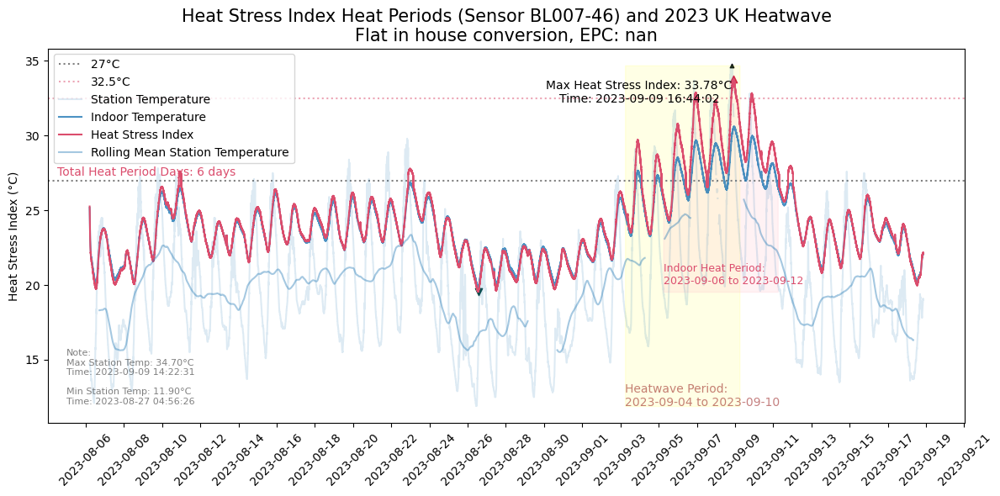

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:91: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


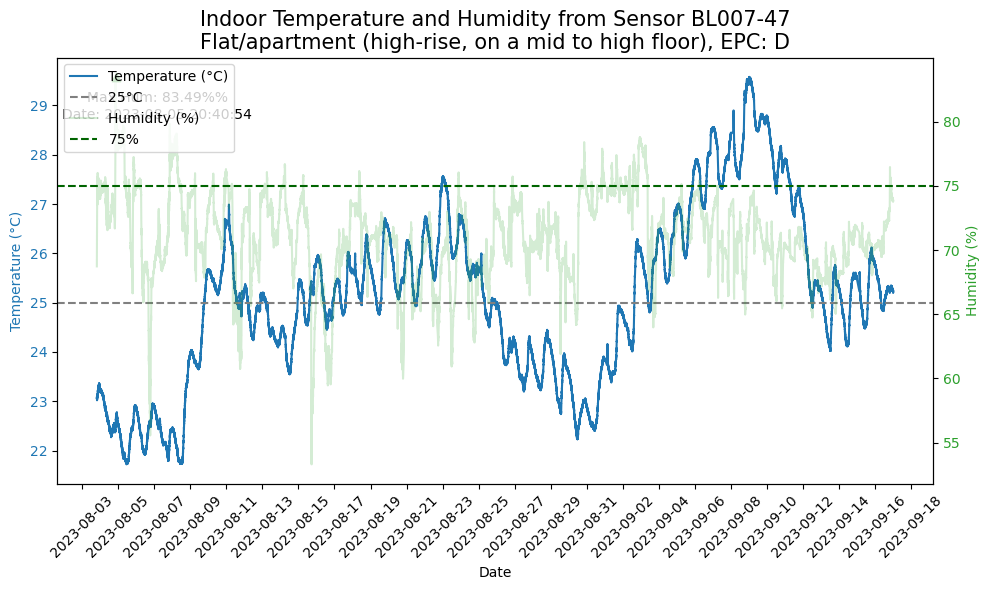

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:221: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


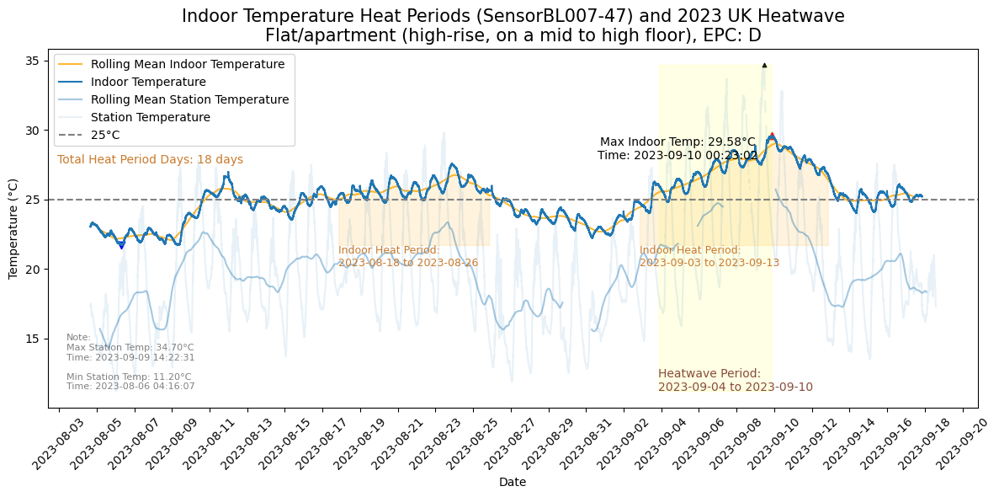

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sliced_df['heatstress'] = sliced_df.apply(lambda row: calculate_heat_index(row['TEMP'], row['HUM']), axis=1)
C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:353: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


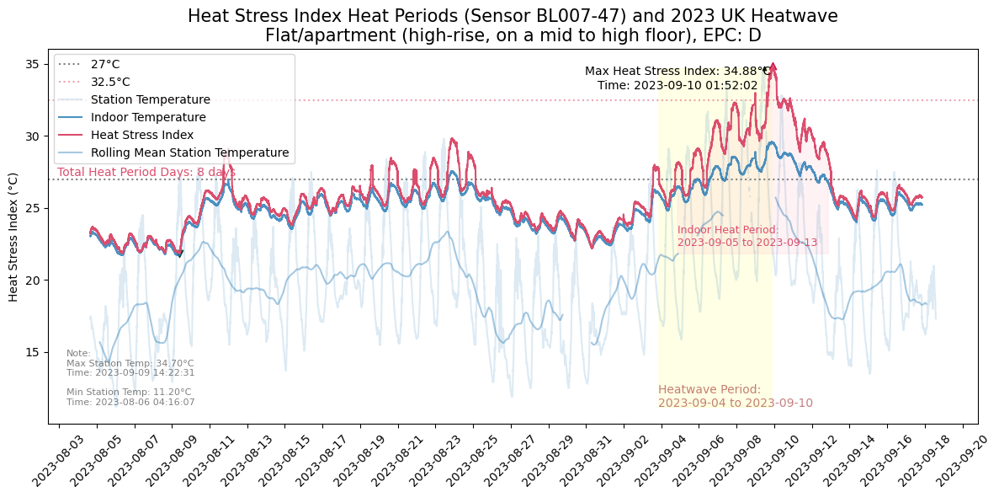

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:91: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


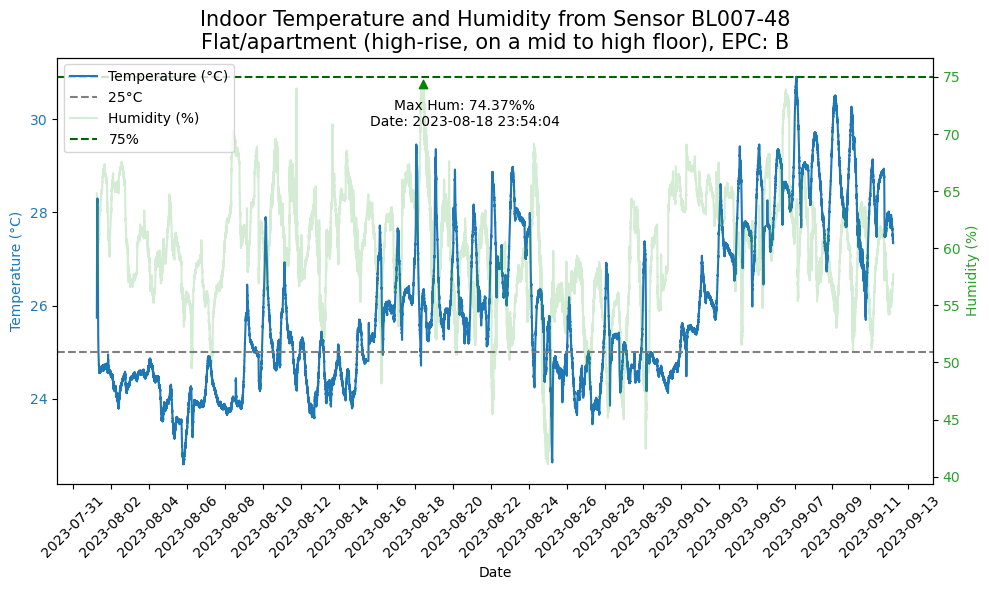

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:221: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


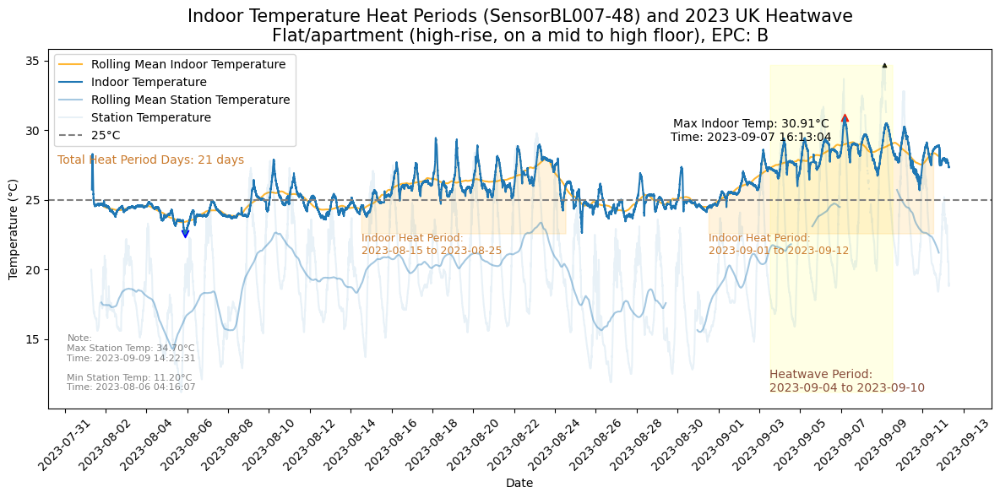

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:353: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


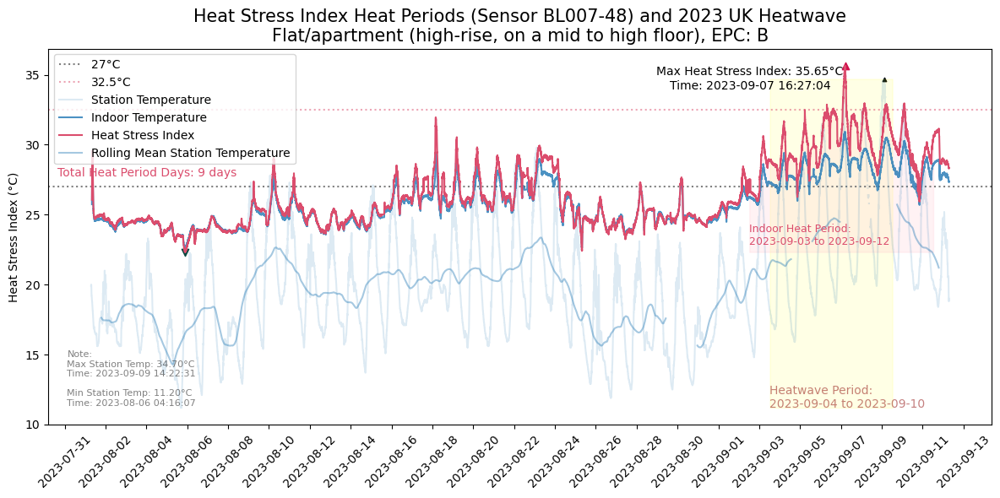

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:91: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


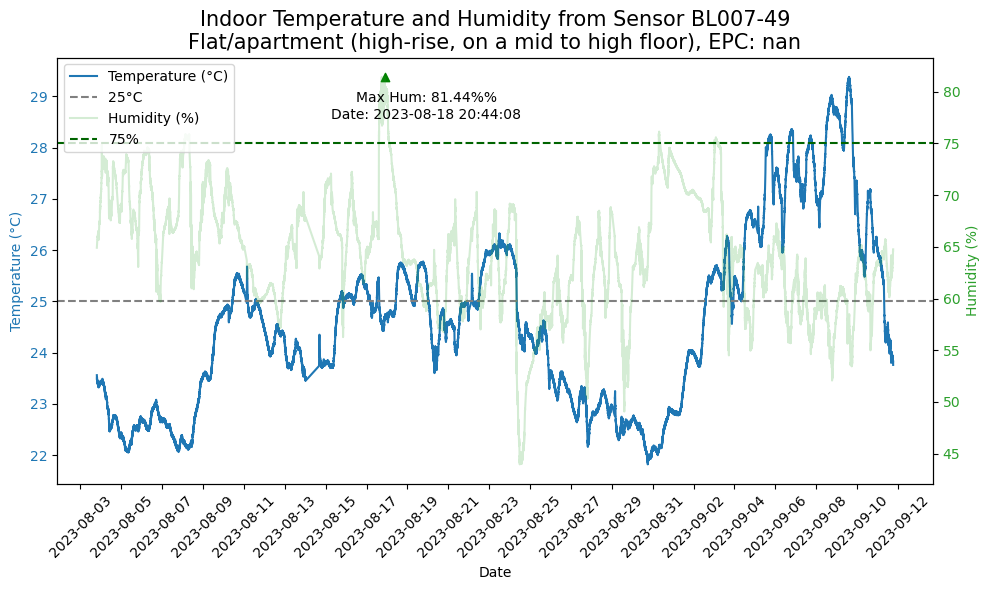

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:221: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


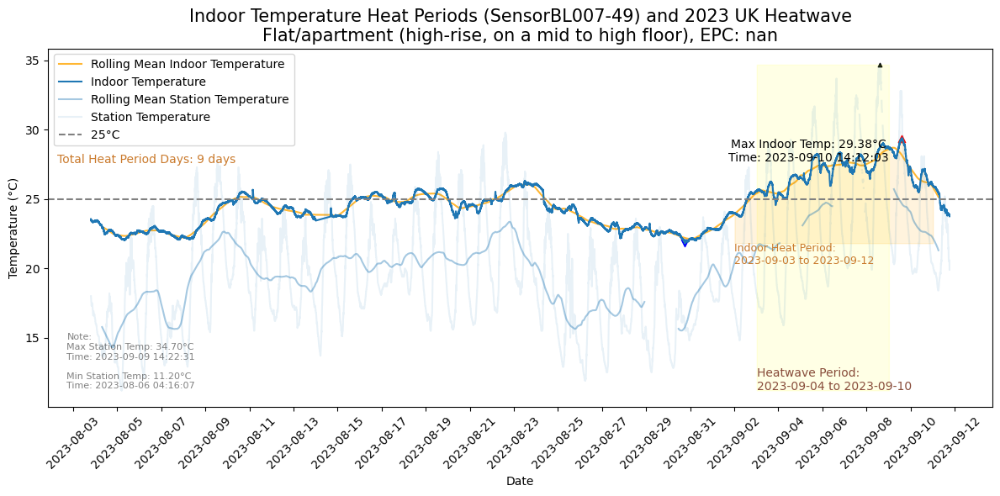

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sliced_df['heatstress'] = sliced_df.apply(lambda row: calculate_heat_index(row['TEMP'], row['HUM']), axis=1)
C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:353: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


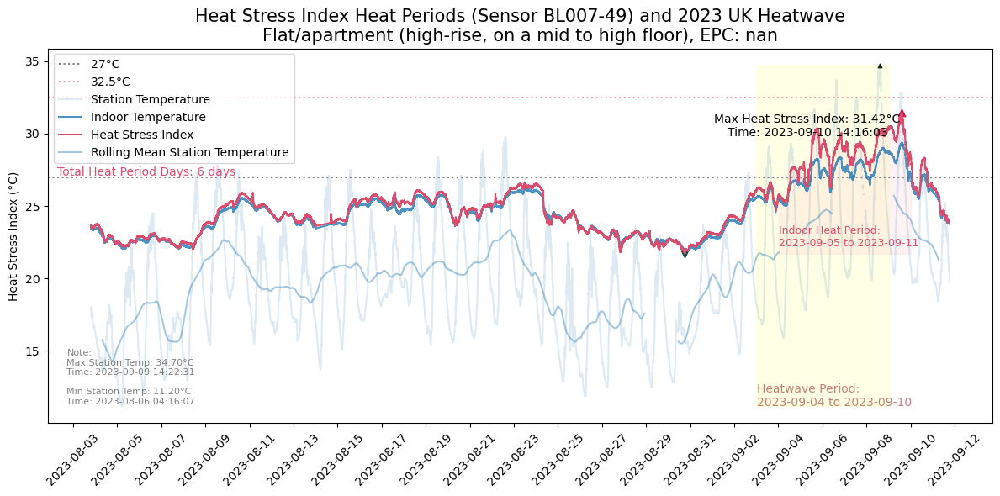

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:91: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


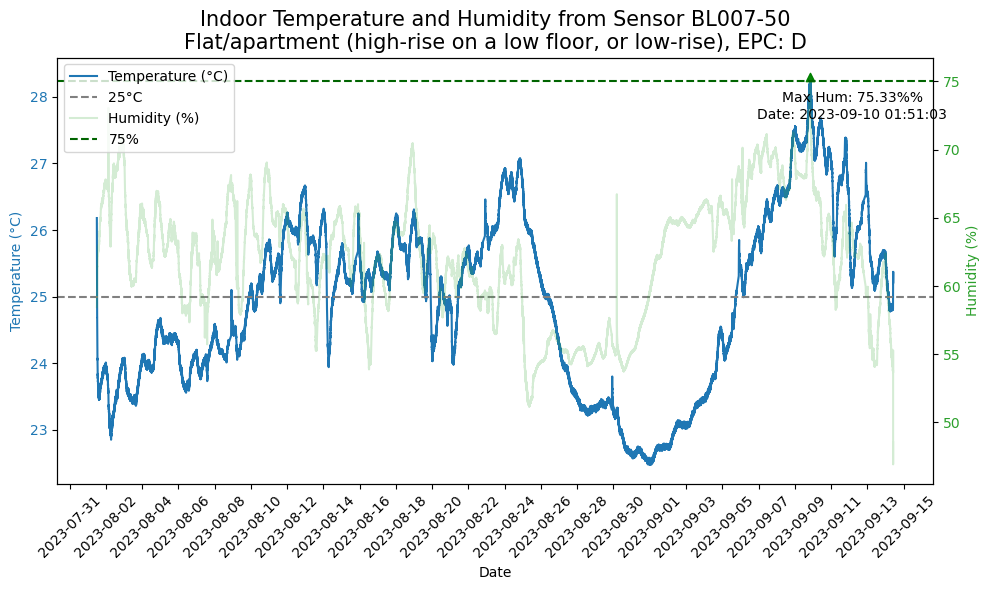

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:221: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


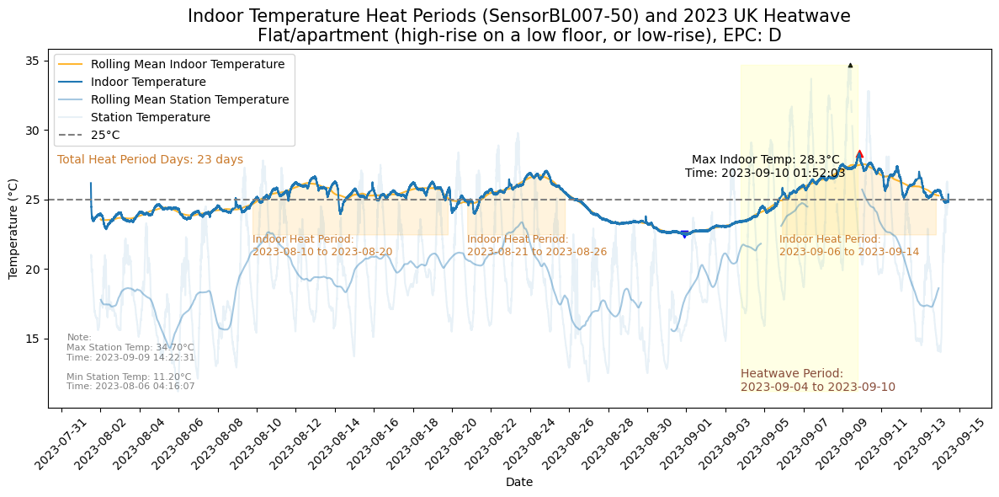

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sliced_df['heatstress'] = sliced_df.apply(lambda row: calculate_heat_index(row['TEMP'], row['HUM']), axis=1)
C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:353: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


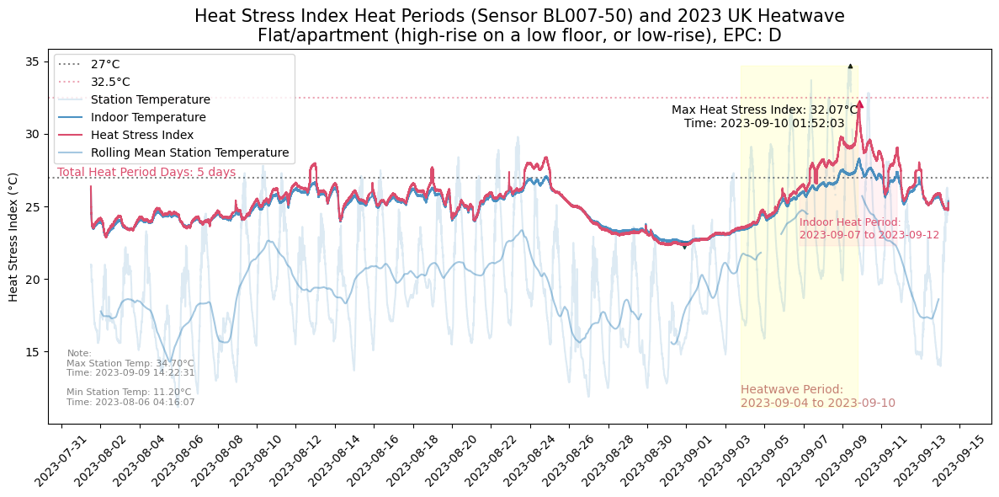

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:91: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


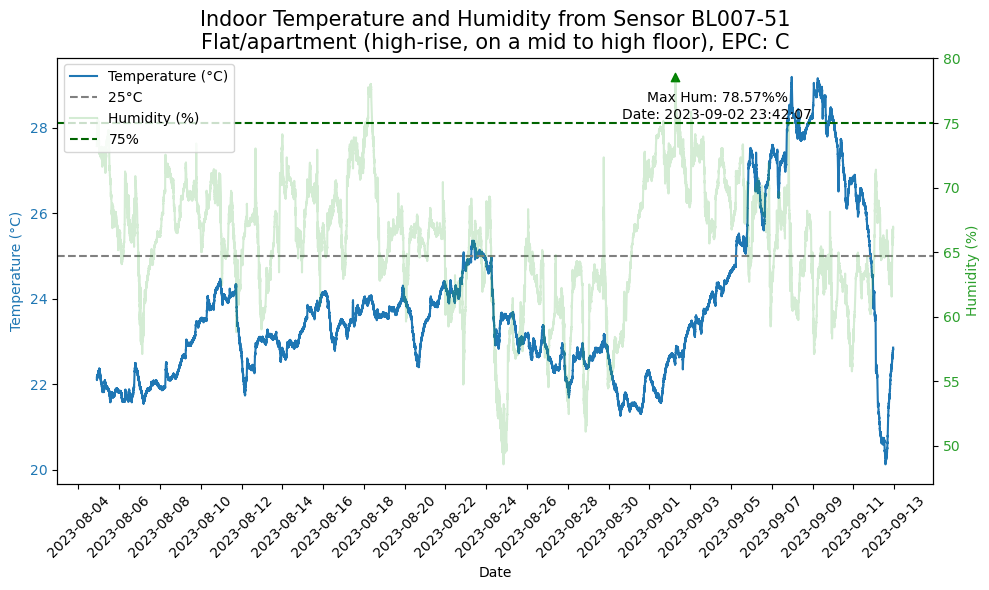

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:221: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


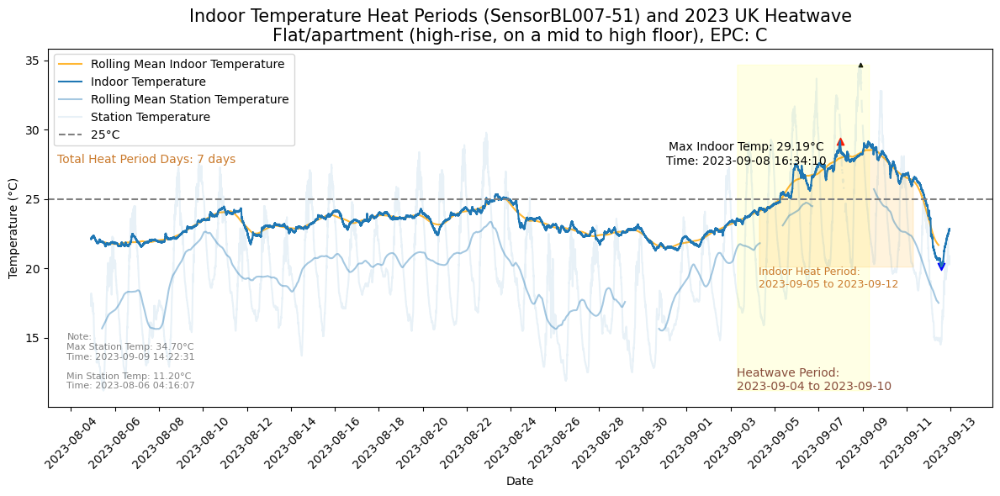

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sliced_df['heatstress'] = sliced_df.apply(lambda row: calculate_heat_index(row['TEMP'], row['HUM']), axis=1)
C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:353: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


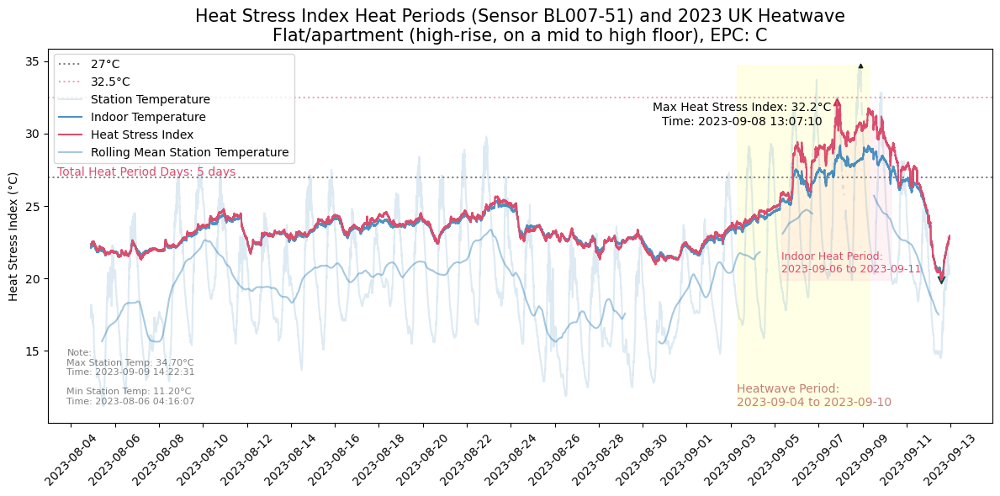

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:91: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


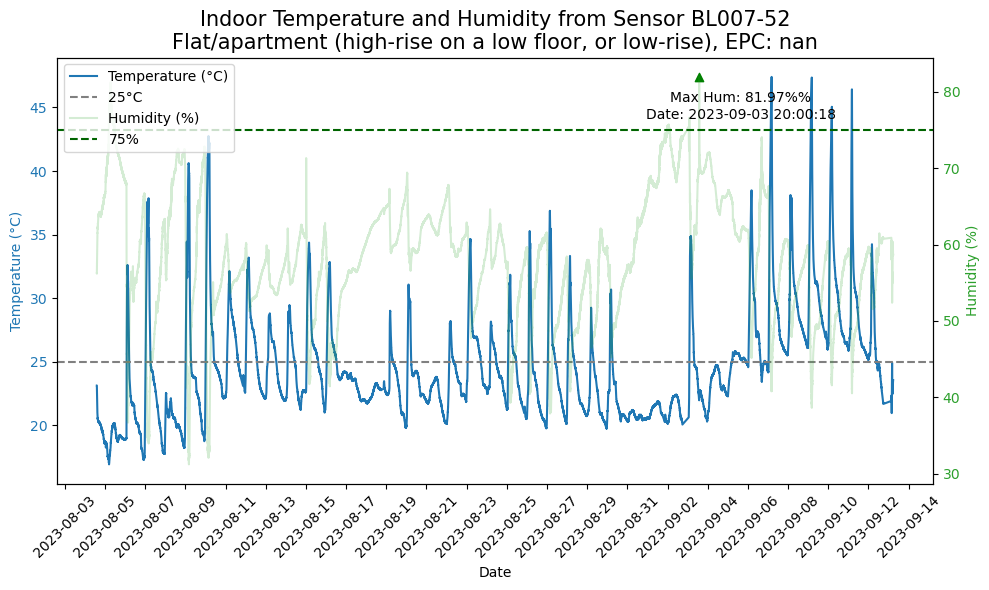

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:221: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


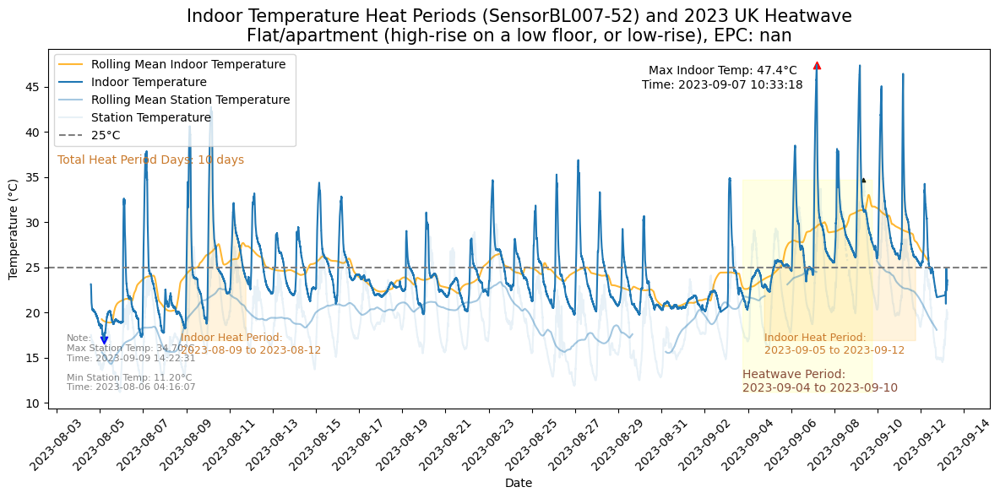

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sliced_df['heatstress'] = sliced_df.apply(lambda row: calculate_heat_index(row['TEMP'], row['HUM']), axis=1)
C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:353: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


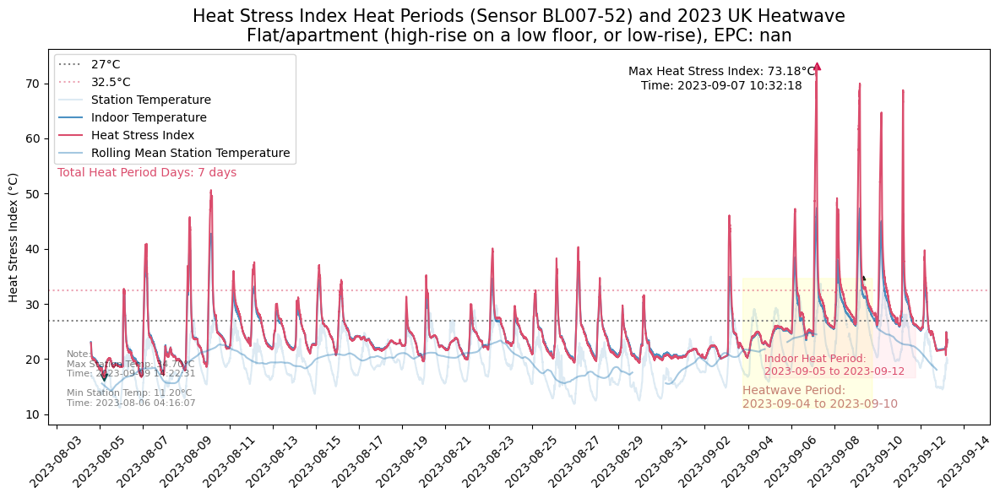

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:91: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


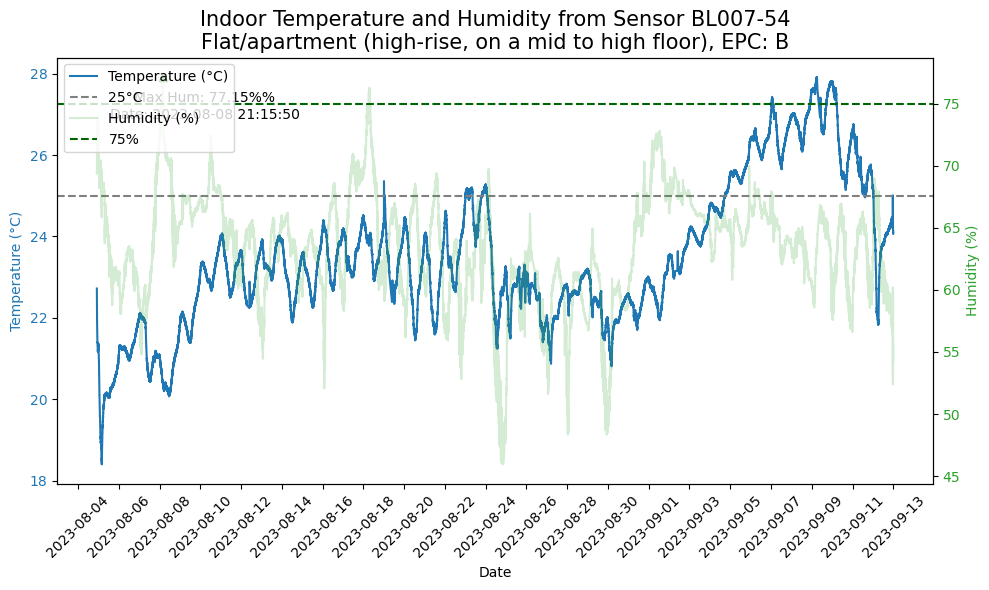

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:221: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


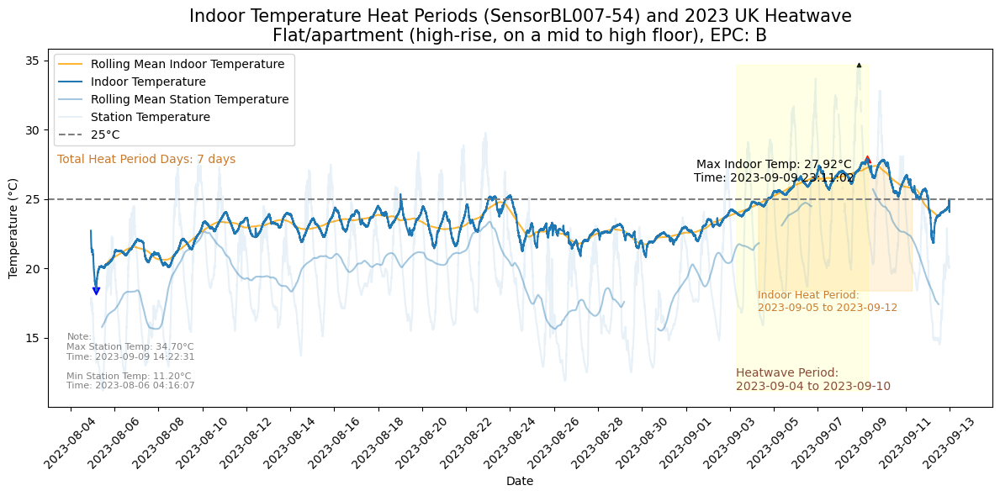

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sliced_df['heatstress'] = sliced_df.apply(lambda row: calculate_heat_index(row['TEMP'], row['HUM']), axis=1)
C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:353: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


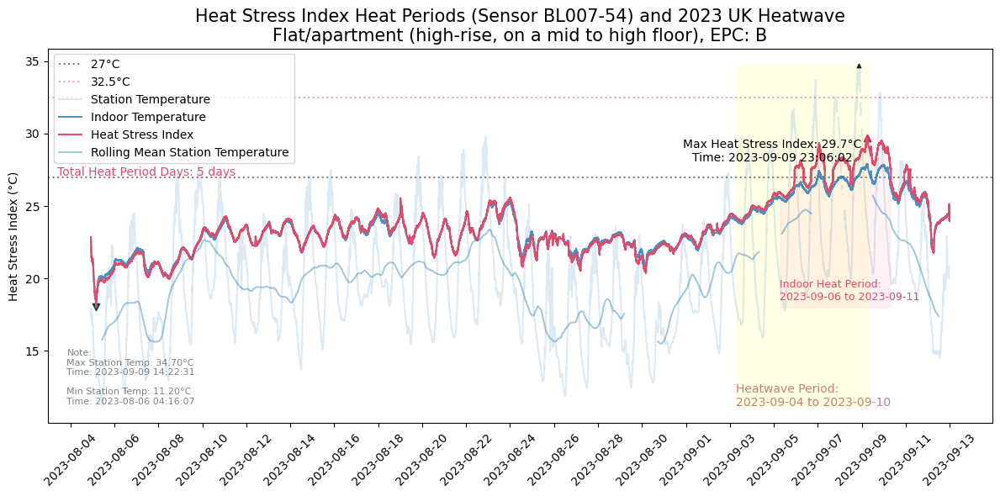

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:91: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


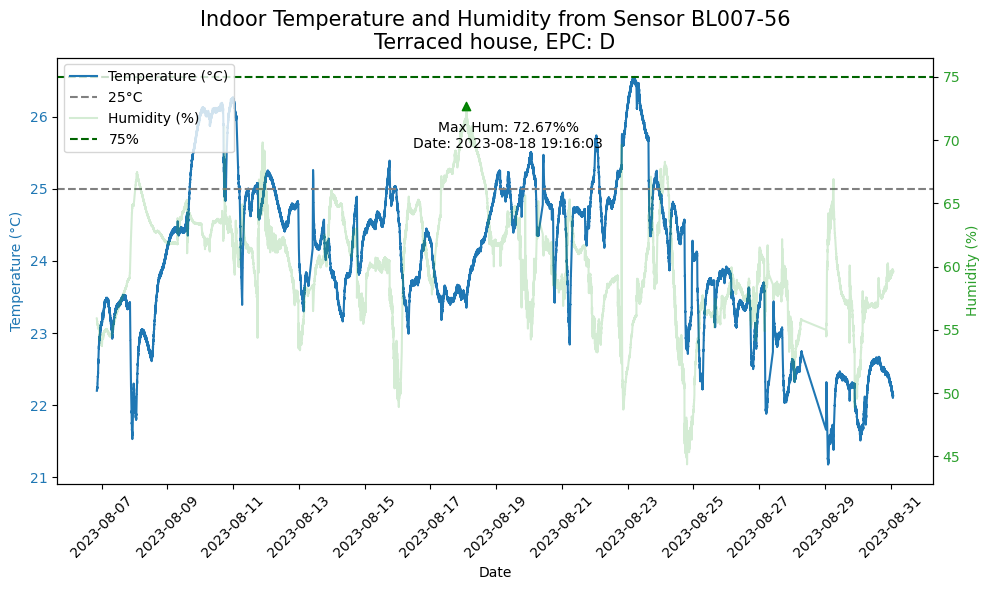

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:221: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


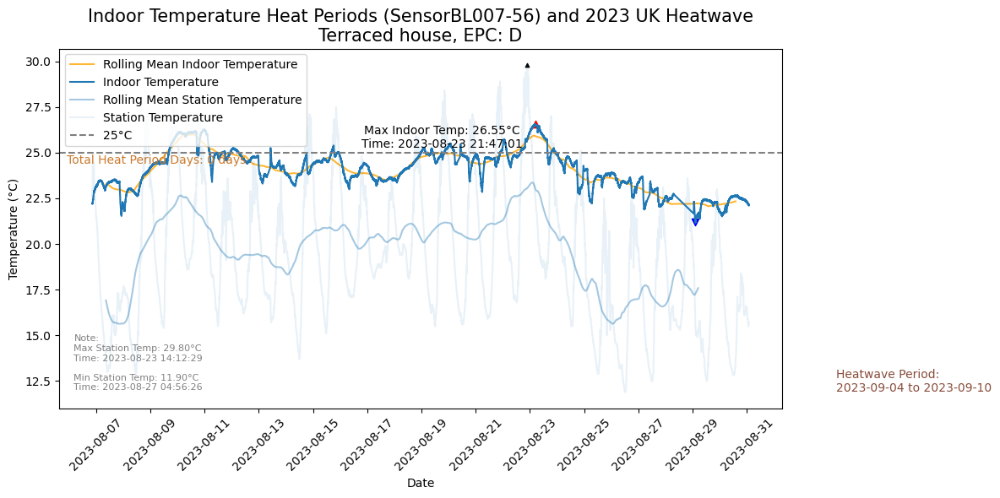

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sliced_df['heatstress'] = sliced_df.apply(lambda row: calculate_heat_index(row['TEMP'], row['HUM']), axis=1)
C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:353: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


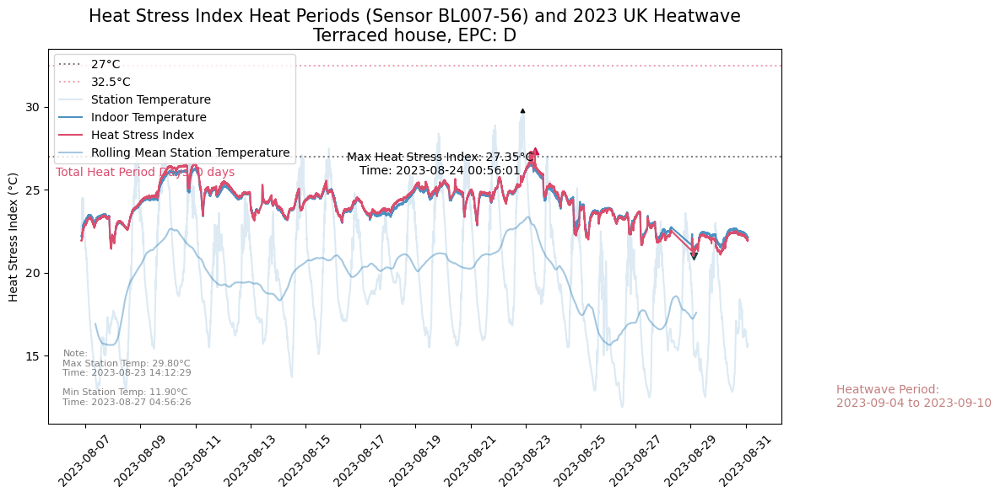

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:91: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


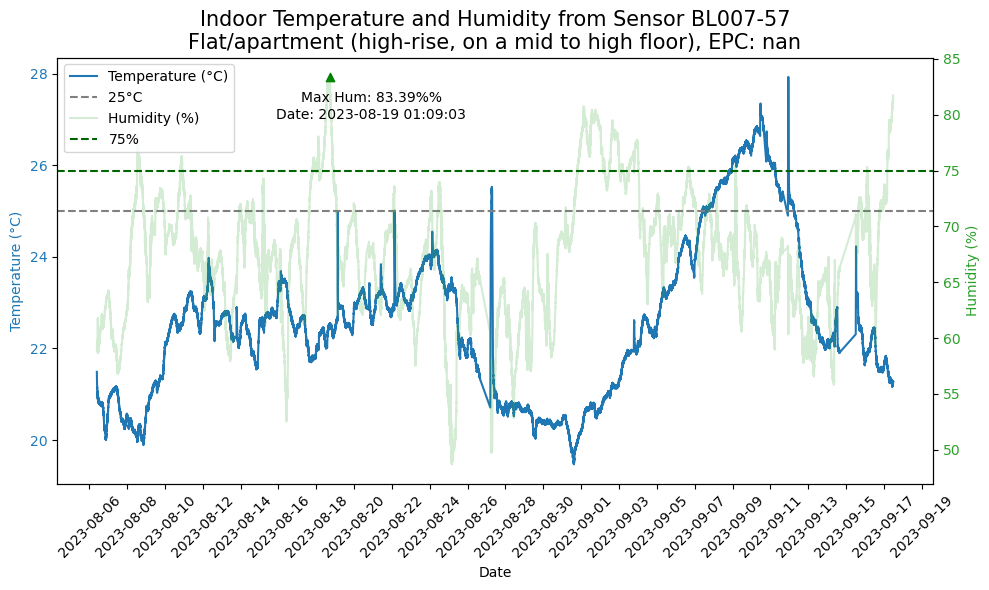

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:221: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


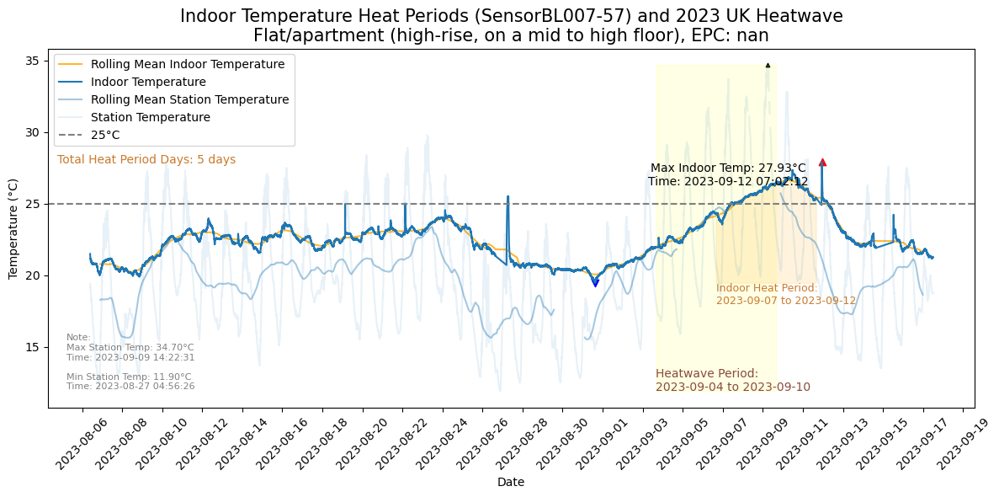

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sliced_df['heatstress'] = sliced_df.apply(lambda row: calculate_heat_index(row['TEMP'], row['HUM']), axis=1)
C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:353: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


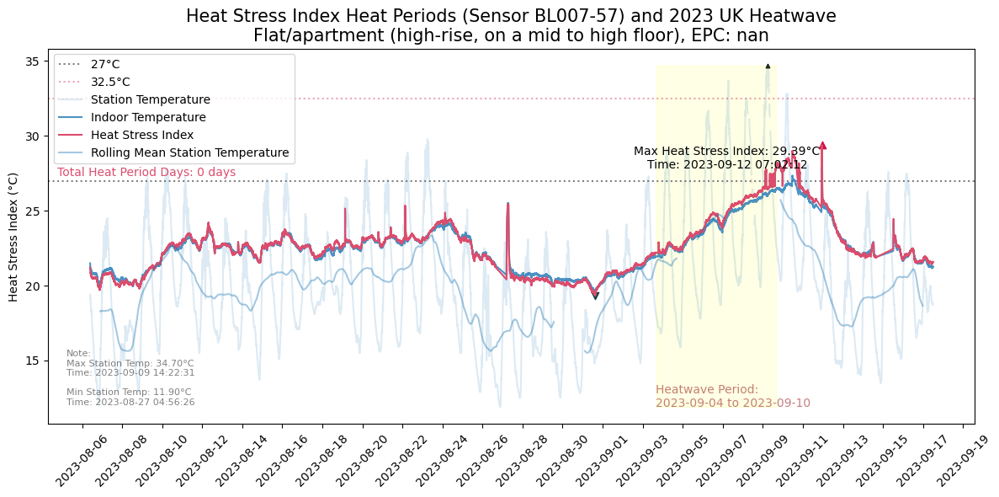

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:91: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


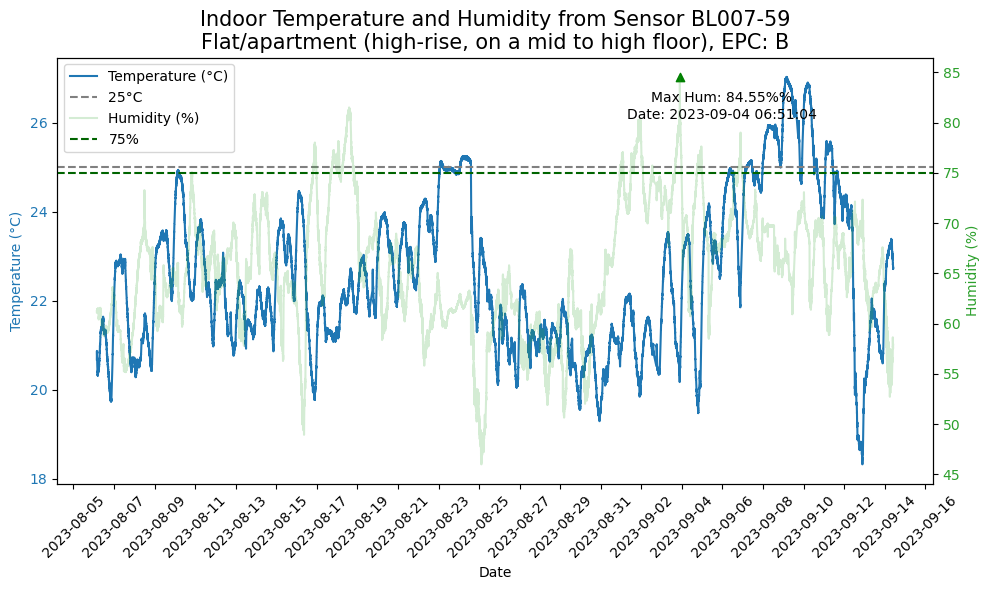

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:221: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


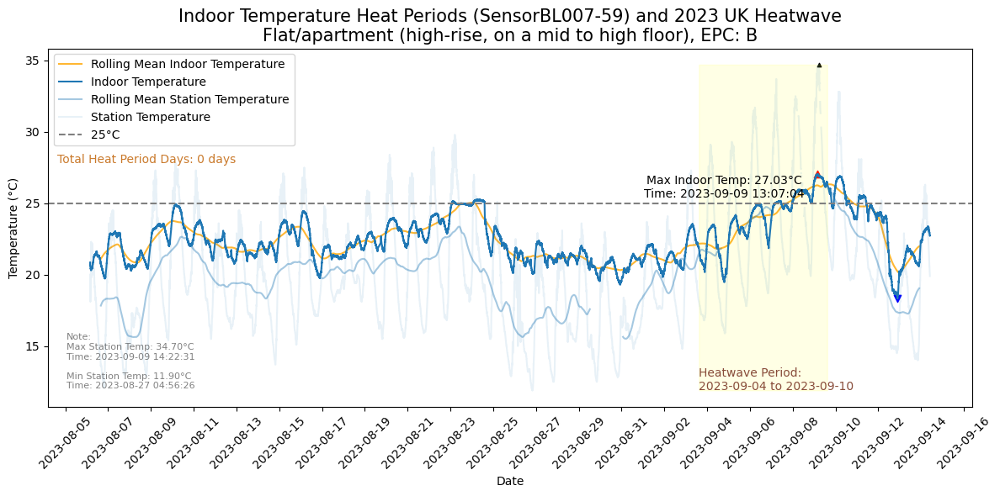

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sliced_df['heatstress'] = sliced_df.apply(lambda row: calculate_heat_index(row['TEMP'], row['HUM']), axis=1)
C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:353: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


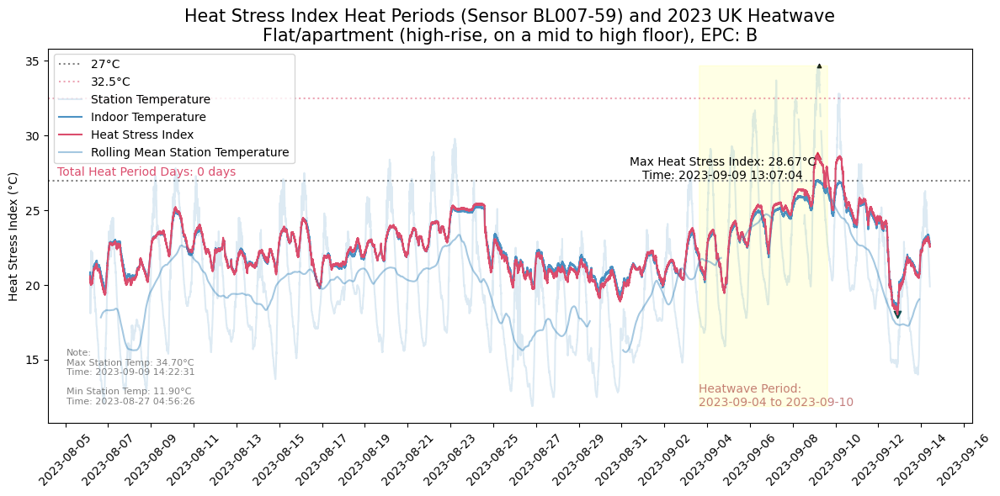

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:91: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


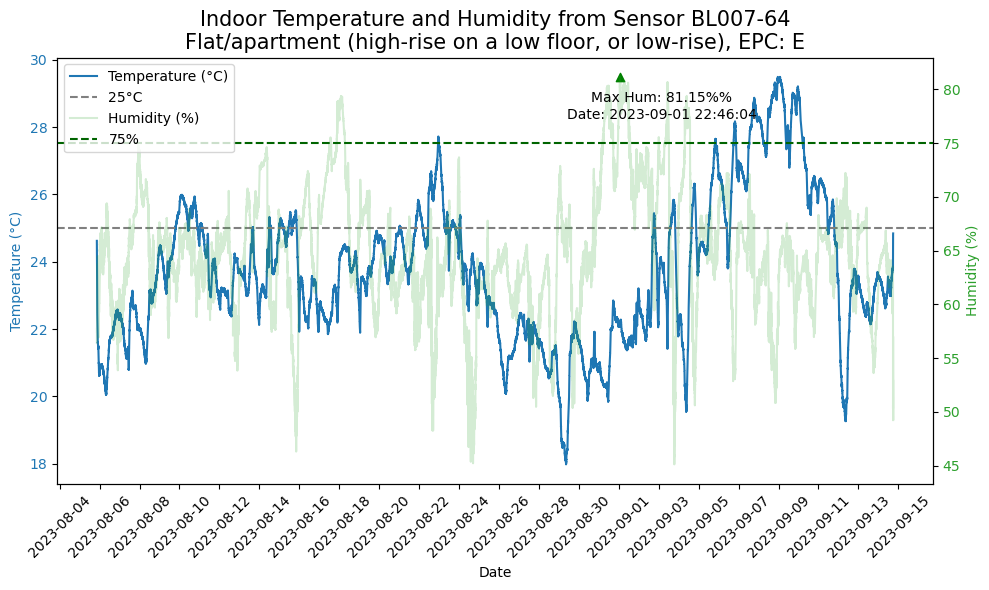

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:221: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


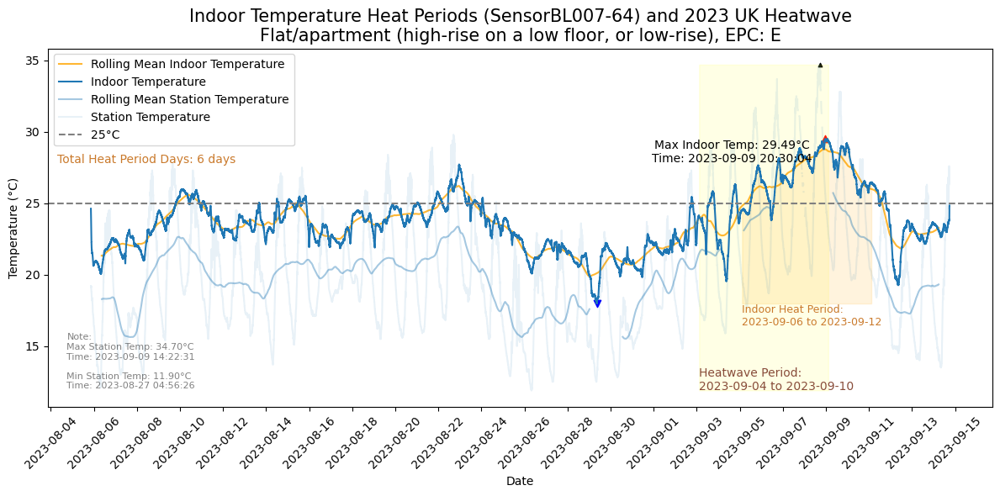

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sliced_df['heatstress'] = sliced_df.apply(lambda row: calculate_heat_index(row['TEMP'], row['HUM']), axis=1)
C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:353: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


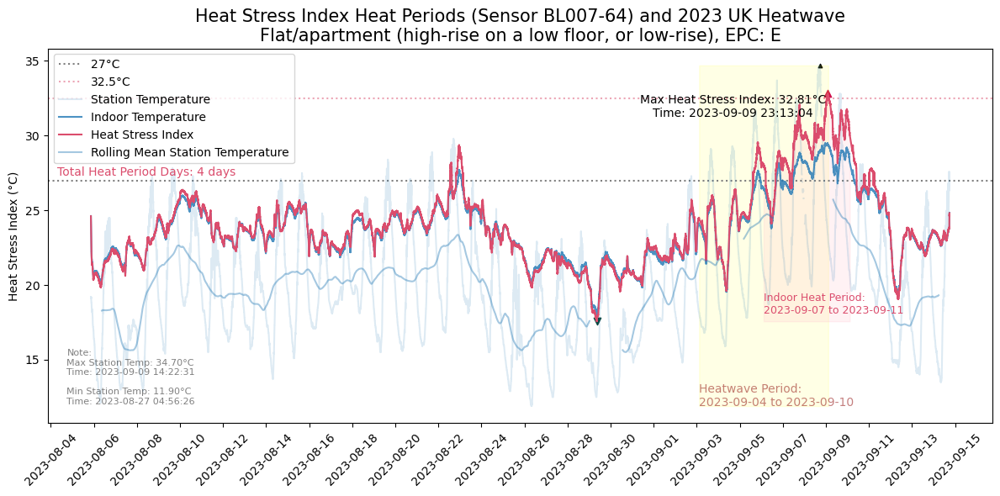

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:91: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


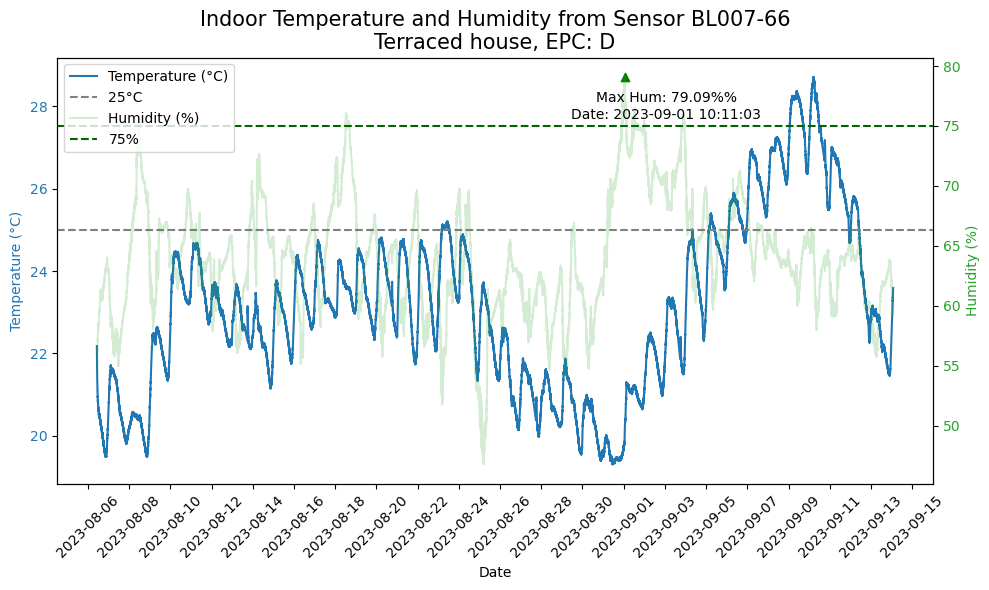

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:221: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


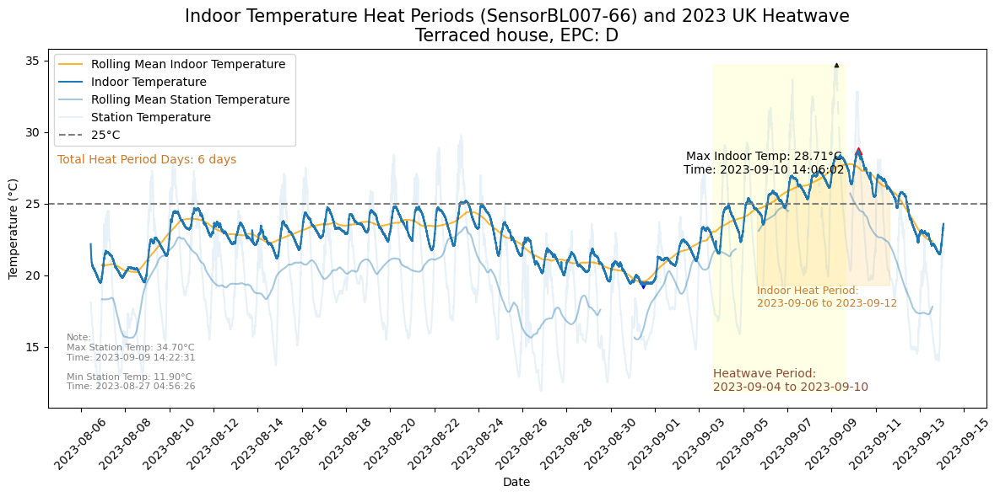

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sliced_df['heatstress'] = sliced_df.apply(lambda row: calculate_heat_index(row['TEMP'], row['HUM']), axis=1)
C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:353: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


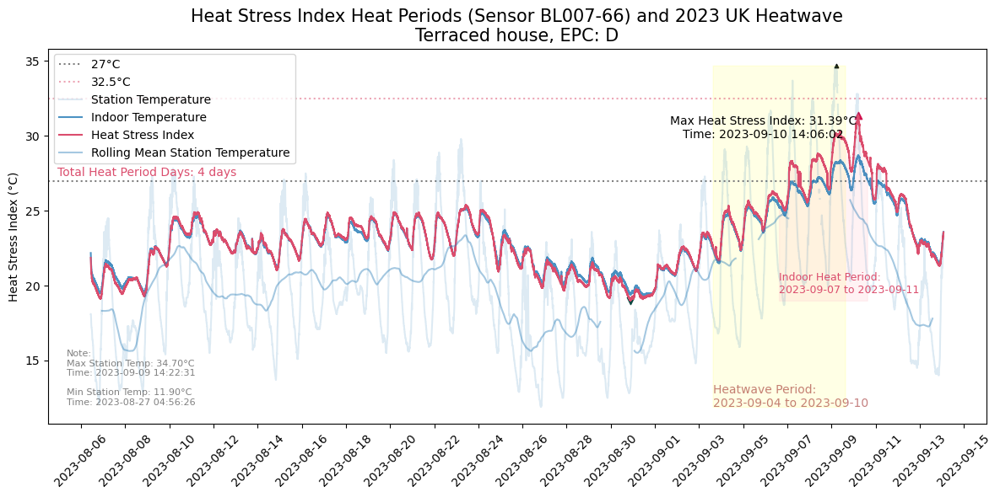

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:91: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


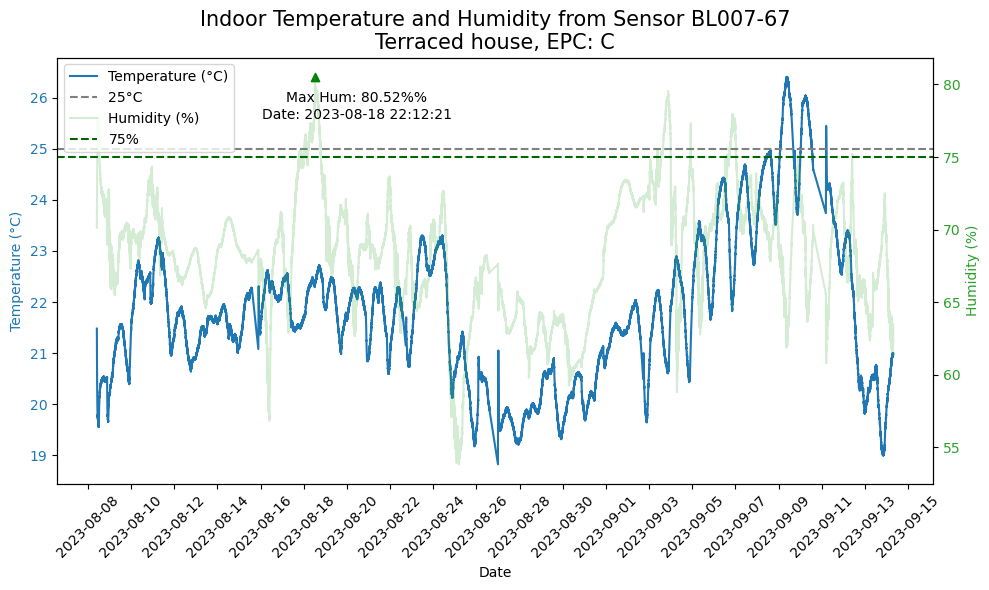

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:221: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


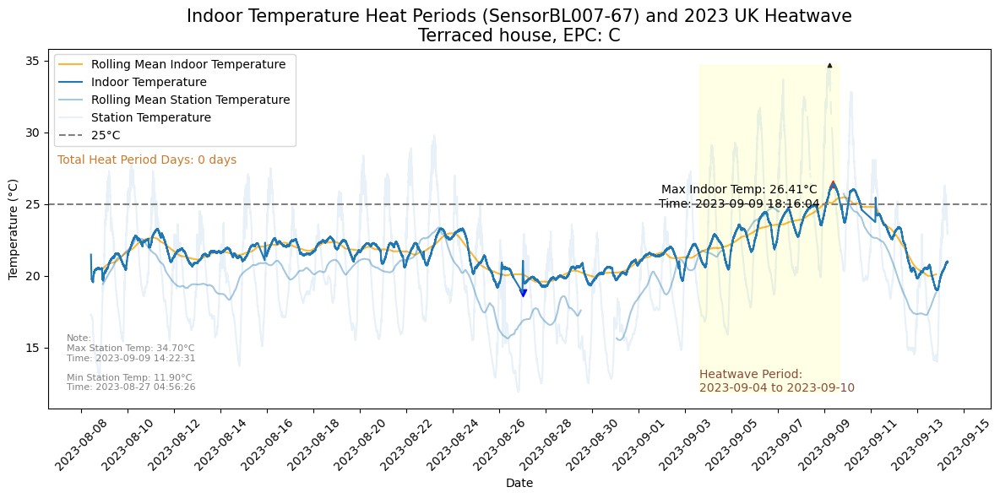

C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:230: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sliced_df['heatstress'] = sliced_df.apply(lambda row: calculate_heat_index(row['TEMP'], row['HUM']), axis=1)
C:\Users\ch335s\AppData\Local\Temp\ipykernel_7904\3470373983.py:353: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45)


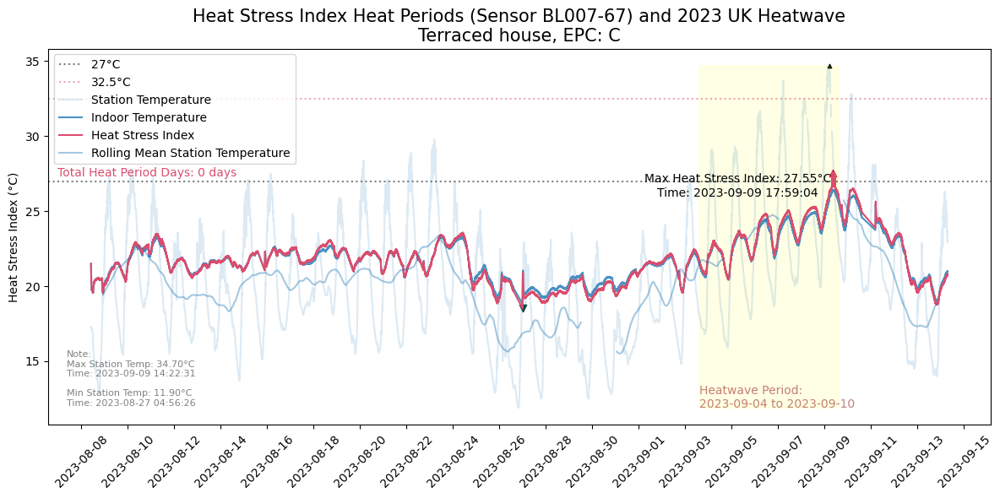

In [30]:
for filepath in ID_list:
    temperature_plot(filepath)